In [397]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
!conda install -c conda-forge contextily -y
import contextily as ctx
import ee
ee.Initialize()

python(50541) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Retrieving notices: done
Channels:
 - conda-forge
 - defaults
Platform: osx-64
Solving environment: done

## Package Plan ##

  environment location: /Users/user/anaconda3

  added / updated specs:
    - contextily


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2025.8.3   |       hbd8a1cb_0         151 KB  conda-forge
    certifi-2025.8.3           |     pyhd8ed1ab_0         155 KB  conda-forge
    conda-25.7.0               |  py311h6eed73b_0         1.2 MB  conda-forge
    openssl-3.5.2              |       h6e31bce_0         2.6 MB  conda-forge
    ------------------------------------------------------------
                                           Total:         4.1 MB

The following packages will be UPDATED:

  ca-certificates                      2025.7.14-hbd8a1cb_0 --> 2025.8.3-hbd8a1cb_0 
  certifi                            2025.7.14-pyhd8ed1ab_0 --> 2025.8

In [6]:
df_geo = pd.read_csv("s00_me_bfa2021.csv")

In [7]:
df_geo

,hhid,grappe,menage,vague,hhweight,s00q00,s00q01,s00q02,s00q03,s00q04,...,s00q24a,s00q25a,s00q23b,s00q24b,s00q25b,s00q08,s00q27,s00q28,GPS__Latitude,GPS__Longitude
0,586005,586,5,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-21T09:36:42,2022-05-21T16:38:09,2022-05-21T09:36:26,2022-05-21T16:37:27,2022-05-24T08:31:40,"Rempli, ménage sélectionné",Complet,Dioula,13.124,-4.163
1,586028,586,28,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T09:31:11,2022-05-22T19:13:30,2022-05-20T09:30:57,2022-05-22T19:13:14,2022-05-24T09:04:57,"Rempli, ménage sélectionné",Complet,Moore,13.126,-4.165
2,586043,586,43,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-21T07:42:07,2022-05-21T08:03:52,2022-05-21T07:41:42,2022-05-21T08:03:43,2022-05-24T09:52:12,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.167
3,586044,586,44,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T08:58:51,2022-05-20T08:59:10,2022-05-20T08:58:23,2022-05-20T08:59:00,2022-05-21T14:00:37,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.168
4,586052,586,52,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T12:11:24,2022-05-20T12:13:23,2022-05-20T12:10:42,2022-05-20T12:12:49,2022-05-21T14:54:25,"Rempli, ménage sélectionné",Complet,Dioula,13.127,-4.164
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T15:19:25,2021-11-08T13:52:56,2021-11-07T15:18:22,2021-11-08T13:52:41,2021-11-10T11:48:02,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231
7172,1185034,1185,34,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T14:45:26,2021-11-07T15:10:15,2021-11-07T14:44:03,2021-11-07T15:09:53,2021-11-12T10:44:10,"Rempli, ménage sélectionné",Complet,Français,12.952,-0.231
7173,1185035,1185,35,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-09T08:43:45,2021-11-11T08:30:18,2021-11-07T14:50:29,2021-11-09T09:42:36,2021-11-11T11:08:03,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231
7174,1185047,1185,47,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T10:13:15,2021-11-08T09:17:17,2021-11-07T10:12:34,2021-11-08T09:17:05,2021-11-09T09:13:35,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.951,-0.232


In [8]:
# Rename geographic and metadata columns to clear English descriptors
# This improves readability and consistency across merged datasets
df_geo.rename(columns={
    'hhid': 'hhid',
    'grappe': 'cluster',
    'menage': 'household_number',
    'vague': 'wave',
    'hhweight': 'household_weight',
    's00q00': 'country',
    's00q01': 'region',
    's00q02': 'prefecture_arrondissement',
    's00q03': 'commune',
    's00q04': 'residence_type',
    's00q05': 'village_quartier',
    's00q07a': 'household_type',
    's00q07b': 'recent_mover',
    's00q07c': 'migration_reason',
    's00q07d': 'interviewed_2018_2019',
    's00q07d2': 'interviewed_2018_other',
    's00q22': 'interview_visits_required',
    's00q23a': 'interview_date_1_start',
    's00q24a': 'interview_date_2_start',
    's00q25a': 'interview_date_3_start',
    's00q23b': 'interview_date_1_end',
    's00q24b': 'interview_date_2_end',
    's00q25b': 'interview_date_3_end',
    's00q08': 'interview_result',
    's00q27': 'questionnaire_result',
    's00q28': 'interview_language',
    'GPS__Latitude': 'gps_latitude',
    'GPS__Longitude': 'gps_longitude'
}, inplace=True)


In [9]:
df_geo

,hhid,cluster,household_number,wave,household_weight,country,region,prefecture_arrondissement,commune,residence_type,...,interview_date_2_start,interview_date_3_start,interview_date_1_end,interview_date_2_end,interview_date_3_end,interview_result,questionnaire_result,interview_language,gps_latitude,gps_longitude
0,586005,586,5,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-21T09:36:42,2022-05-21T16:38:09,2022-05-21T09:36:26,2022-05-21T16:37:27,2022-05-24T08:31:40,"Rempli, ménage sélectionné",Complet,Dioula,13.124,-4.163
1,586028,586,28,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T09:31:11,2022-05-22T19:13:30,2022-05-20T09:30:57,2022-05-22T19:13:14,2022-05-24T09:04:57,"Rempli, ménage sélectionné",Complet,Moore,13.126,-4.165
2,586043,586,43,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-21T07:42:07,2022-05-21T08:03:52,2022-05-21T07:41:42,2022-05-21T08:03:43,2022-05-24T09:52:12,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.167
3,586044,586,44,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T08:58:51,2022-05-20T08:59:10,2022-05-20T08:58:23,2022-05-20T08:59:00,2022-05-21T14:00:37,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.168
4,586052,586,52,2,439,Burkina Faso,Boucle du Mouhoum,Kossi,Djibasso,Rural,...,2022-05-20T12:11:24,2022-05-20T12:13:23,2022-05-20T12:10:42,2022-05-20T12:12:49,2022-05-21T14:54:25,"Rempli, ménage sélectionné",Complet,Dioula,13.127,-4.164
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T15:19:25,2021-11-08T13:52:56,2021-11-07T15:18:22,2021-11-08T13:52:41,2021-11-10T11:48:02,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231
7172,1185034,1185,34,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T14:45:26,2021-11-07T15:10:15,2021-11-07T14:44:03,2021-11-07T15:09:53,2021-11-12T10:44:10,"Rempli, ménage sélectionné",Complet,Français,12.952,-0.231
7173,1185035,1185,35,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-09T08:43:45,2021-11-11T08:30:18,2021-11-07T14:50:29,2021-11-09T09:42:36,2021-11-11T11:08:03,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231
7174,1185047,1185,47,1,821,Burkina Faso,Est,Gnagna,Bogande,Rural,...,2021-11-07T10:13:15,2021-11-08T09:17:17,2021-11-07T10:12:34,2021-11-08T09:17:05,2021-11-09T09:13:35,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.951,-0.232


In [10]:
# Basic cleanup: ensure identifiers are stripped and lowercase where appropriate
# Prepare GPS and string columns for merging or spatial processing
df_geo['region'] = df_geo['region'].astype(str).str.strip().str.lower()
df_geo['commune'] = df_geo['commune'].astype(str).str.strip().str.lower()
df_geo['prefecture_arrondissement'] = df_geo['prefecture_arrondissement'].astype(str).str.strip().str.lower()
df_geo['village_quartier'] = df_geo['village_quartier'].astype(str).str.strip().str.lower()
df_geo['residence_type'] = df_geo['residence_type'].astype(str).str.strip().str.lower()

# Clean GPS coordinates: coerce invalid GPS entries to NaN and round to 6 decimals
df_geo['gps_latitude'] = pd.to_numeric(df_geo['gps_latitude'], errors='coerce').round(6)
df_geo['gps_longitude'] = pd.to_numeric(df_geo['gps_longitude'], errors='coerce').round(6)


In [11]:
# Parse interview start and end dates into standardized datetime format
# This allows for later analysis like interview timing, visit duration, etc.

date_cols = [
    'interview_date_1_start', 'interview_date_2_start', 'interview_date_3_start',
    'interview_date_1_end', 'interview_date_2_end', 'interview_date_3_end'
]

for col in date_cols:
    df_geo[col] = pd.to_datetime(df_geo[col], errors='coerce')
    
    
    
    
    
    # Compute survey duration using available interview start/end dates
# We take the earliest start and latest end to get duration per household

df_geo['survey_duration_days'] = (
    df_geo[
        ['interview_date_1_start', 'interview_date_2_start', 'interview_date_3_start',
         'interview_date_1_end', 'interview_date_2_end', 'interview_date_3_end']
    ].max(axis=1)
    - df_geo[
        ['interview_date_1_start', 'interview_date_2_start', 'interview_date_3_start',
         'interview_date_1_end', 'interview_date_2_end', 'interview_date_3_end']
    ].min(axis=1)
).dt.days



In [12]:
# Clean and validate GPS coordinates
# Remove extreme or missing GPS values
df_geo['gps_latitude'] = pd.to_numeric(df_geo['gps_latitude'], errors='coerce')
df_geo['gps_longitude'] = pd.to_numeric(df_geo['gps_longitude'], errors='coerce')

# Flag invalid or missing GPS coordinates (for diagnostics)
df_geo['gps_valid'] = df_geo[['gps_latitude', 'gps_longitude']].notnull().all(axis=1)

# Remove entries with clearly invalid coordinates (e.g., 0,0 or outside Burkina bounds)
df_geo.loc[
    (df_geo['gps_latitude'] < 9.5) | (df_geo['gps_latitude'] > 15) |
    (df_geo['gps_longitude'] < -6) | (df_geo['gps_longitude'] > 3),
    'gps_valid'
] = False


<Figure size 1000x800 with 0 Axes>

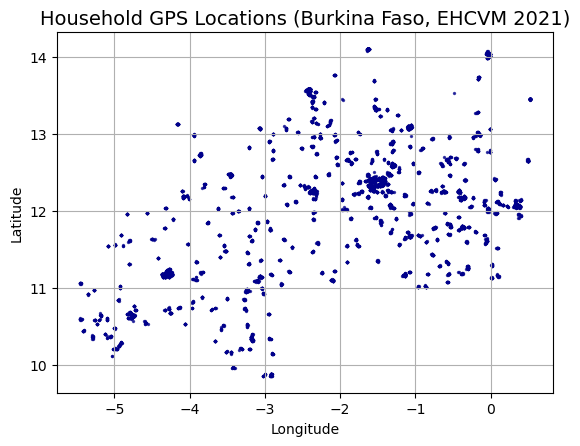

In [13]:

# Create geometry column using cleaned GPS coordinates
df_geo['geometry'] = df_geo.apply(
    lambda row: Point(row['gps_longitude'], row['gps_latitude']) if row['gps_valid'] else None,
    axis=1
)

# Convert to GeoDataFrame (for spatial visualization)
gdf_geo = gpd.GeoDataFrame(df_geo, geometry='geometry', crs='EPSG:4326')

# Filter only valid GPS rows for mapping
gdf_valid = gdf_geo[df_geo['gps_valid']]

# Plot the map
plt.figure(figsize=(10, 8))
gdf_valid.plot(markersize=2, color='darkblue', alpha=0.7)
plt.title("Household GPS Locations (Burkina Faso, EHCVM 2021)", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True)
plt.show()


In [14]:
df_geo.columns

Index(['hhid', 'cluster', 'household_number', 'wave', 'household_weight',
       'country', 'region', 'prefecture_arrondissement', 'commune',
       'residence_type', 'village_quartier', 'household_type', 'recent_mover',
       'migration_reason', 'interviewed_2018_2019', 'interviewed_2018_other',
       'interview_visits_required', 'interview_date_1_start',
       'interview_date_2_start', 'interview_date_3_start',
       'interview_date_1_end', 'interview_date_2_end', 'interview_date_3_end',
       'interview_result', 'questionnaire_result', 'interview_language',
       'gps_latitude', 'gps_longitude', 'survey_duration_days', 'gps_valid',
       'geometry'],
      dtype='object')

In [16]:
df_geo.to_csv("bfa_geospatial_data_cleaned.csv")

In [15]:
shock_data = pd.read_csv("bfa_shock_raw_renamed_cleaned.csv")
shock_data

,hhid,cluster,household_number,wave,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_month,shock_year,...,coping_lease_land,coping_sell_food_stock,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies
0,586005,586,5,2,439,2,Taux élevé de maladies des animaux,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
1,586005,586,5,2,439,2,Conflit armé/Violence/Insécurité,Oui,Avril,2020,...,0,0,0,0,0,0,0,0,0,NaN
2,586005,586,5,2,439,2,Décès d'un membre du ménage,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
3,586005,586,5,2,439,2,Faillite d'une entreprise non agricole du ménage,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
4,586005,586,5,2,439,2,Taux élevé de maladies des cultures,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157867,1185051,1185,51,1,821,1,Sécheresse/Pluies irrégulières,Oui,Ne sait pas,2019,...,0,0,0,0,0,0,0,0,0,NaN
157868,1185051,1185,51,1,821,1,Décès d'un membre du ménage,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
157869,1185051,1185,51,1,821,1,Conflit Agriculteur/Eleveur,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN
157870,1185051,1185,51,1,821,1,Baisse importante des prix des produits agricoles,Non,NaN,0,...,0,0,0,0,0,0,0,0,0,NaN


In [16]:
shock_data.columns

Index(['hhid', 'cluster', 'household_number', 'wave', 'household_weight',
       'shock_respondent', 'shock_type', 'shock_occurred_last3y',
       'shock_month', 'shock_year', 'shock_effect_income',
       'shock_effect_assets', 'shock_effect_agri_prod',
       'shock_effect_livestock', 'shock_effect_food_stock',
       'shock_effect_food_purchase', 'coping_savings', 'coping_family_help',
       'coping_govt_help', 'coping_ngo_help', 'coping_marry_daughters',
       'coping_change_consumption', 'coping_buy_cheaper_food',
       'coping_extra_jobs_active', 'coping_unemployed_work',
       'coping_children_work', 'coping_children_out_school',
       'coping_migration', 'coping_reduce_health_edu', 'coping_credit',
       'coping_sell_agri_assets', 'coping_sell_durables',
       'coping_sell_property', 'coping_lease_land', 'coping_sell_food_stock',
       'coping_fishing', 'coping_sell_livestock', 'coping_send_children_away',
       'coping_spiritual_activities', 'coping_offseason_farming'

In [17]:
import unicodedata

def normalize_string(x):
    if pd.isnull(x): return ""
    x = str(x).lower().strip()
    return unicodedata.normalize('NFKD', x).encode('ascii', 'ignore').decode('utf-8')

shock_data['shock_type_clean'] = shock_data['shock_type'].apply(normalize_string)


In [18]:
shock_type_map = {
    # Economic shocks
    'prix eleves des produits alimentaires': 'economic',
    'prix eleves des intrants agricoles': 'economic',
    'baisse importante des prix des produits agricoles': 'economic',
    "perte d'emploi salarie d'un membre": 'economic',
    "perte importante de revenus salariaux  (autre que du fait d'un accident ou d'une maladie)": 'economic',
    "perte importante du revenu non agricole du menage  (autre que du fait d'un accident ou d'une maladie)": 'economic',
    "faillite d'une entreprise non agricole du menage": 'economic',
    "fin de transferts reguliers provenant d'autres menages": 'economic',

    # Social shocks
    "vol d'argent, de biens, de recolte ou de betail": 'social',
    "maladie grave ou accident d'un membre du menage": 'social',
    "deces d'un membre du menage": 'social',
    'divorce, separation': 'social',
    'conflit agriculteur/eleveur': 'social',
    'conflit arme/violence/insecurite': 'social',

    # Environmental shocks
    'secheresse/pluies irregulieres': 'environmental',
    'inondations': 'environmental',
    'glissement de terrain': 'environmental',
    'attaques acridiennes ou autres ravageurs de recolte': 'environmental',
    'taux eleve de maladies des cultures': 'environmental',
    'taux eleve de maladies des animaux': 'environmental',

    # Reassign 'autre' to social
    'autre (a preciser)': 'social'
}


In [19]:
shock_data['shock_group'] = shock_data['shock_type_clean'].map(shock_type_map)


In [20]:
# Group shocks by household and count each shock type
shock_grouped = shock_data.groupby('hhid').agg(
    shock_economic=('shock_group', lambda x: (x == 'economic').sum()),
    shock_social=('shock_group', lambda x: (x == 'social').sum()),
    shock_environmental=('shock_group', lambda x: (x == 'environmental').sum())
).reset_index()

# Compute total and mean shocks per household
shock_grouped['shock_total'] = shock_grouped[['shock_economic', 'shock_social', 'shock_environmental']].sum(axis=1)
shock_grouped['shock_mean'] = shock_grouped[['shock_economic', 'shock_social', 'shock_environmental']].mean(axis=1)


In [21]:
# Merge household-level shock counts into the original data
shock_data = shock_data.merge(shock_grouped, on='hhid', how='left')


In [22]:
# Convert 'oui'/'non' to binary 1/0
shock_data['shock_occurred_last3y'] = shock_data['shock_occurred_last3y'].str.lower().map({'oui': 1, 'non': 0})


In [23]:
# Identify all columns
cols = list(shock_data.columns)

# Define target shock columns
shock_summary_cols = [
    'shock_economic', 'shock_social', 'shock_environmental',
    'shock_mean', 'shock_total'
]

# Remove those from current list to reposition
for col in shock_summary_cols:
    cols.remove(col)

# Insert after 'shock_occurred_last3y'
insert_pos = cols.index('shock_occurred_last3y') + 1
for i, col in enumerate(shock_summary_cols):
    cols.insert(insert_pos + i, col)

# Reorder the DataFrame
shock_data = shock_data[cols]


In [24]:
# Build dictionary for aggregation
agg_dict = {}

for col in shock_data.columns:
    if col == 'hhid':
        continue
    elif col == 'shock_mean':
        agg_dict[col] = 'mean'  # compute average shock per hh
    elif col in ['shock_total', 'shock_economic', 'shock_social', 'shock_environmental', 'shock_occurred_last3y']:
        agg_dict[col] = 'max'  # take maximum (e.g., if any member reported shock)
    elif col.startswith('coping_'):
        agg_dict[col] = 'max'  # 1 if any household member used that strategy
    else:
        agg_dict[col] = 'first'  # keep the first valid value (e.g., for identifiers or descriptions)


In [25]:
# Identify numeric and non-numeric columns
numeric_cols = shock_data.select_dtypes(include=['number']).columns.tolist()
non_numeric_cols = shock_data.select_dtypes(exclude=['number']).columns.tolist()

# Initialize aggregation dictionary
agg_dict = {}

for col in shock_data.columns:
    if col == 'hhid':
        continue
    elif col in numeric_cols:
        if col.startswith('coping_') or col in ['shock_mean', 'shock_total', 'shock_economic', 'shock_social', 'shock_environmental', 'shock_occurred_last3y']:
            agg_dict[col] = 'max'  # numeric indicators: keep 1 if any member reported
        else:
            agg_dict[col] = 'first'  # keep first numeric value if not a shock indicator
    else:
        agg_dict[col] = 'first'  # keep string values like 'shock_type', 'shock_group', etc.


In [26]:
# Aggregate to household level with corrected aggregation
shock_hh_all_cols = shock_data.groupby('hhid').agg(agg_dict).reset_index()


In [27]:
# Extract the fixed total shock columns
shock_totals = ['shock_economic', 'shock_social', 'shock_environmental', 'shock_mean', 'shock_total']


In [28]:
shock_totals 

['shock_economic',
 'shock_social',
 'shock_environmental',
 'shock_mean',
 'shock_total']

In [29]:
# List of columns to take first (excluding totals and hhid)
cols_to_first = [col for col in shock_data.columns if col not in shock_totals]
shock_base = shock_data[cols_to_first].drop_duplicates('hhid').copy()


In [30]:
shock_counts = shock_data[['hhid'] + shock_totals].drop_duplicates('hhid').copy()
shock_counts

,hhid,shock_economic,shock_social,shock_environmental,shock_mean,shock_total
0,586005,8,7,6,7.0,21
22,586028,8,7,6,7.0,21
44,586043,8,7,6,7.0,21
66,586044,8,7,6,7.0,21
88,586052,8,7,6,7.0,21
...,...,...,...,...,...,...
157762,1185033,8,7,6,7.0,21
157784,1185034,8,7,6,7.0,21
157806,1185035,8,7,6,7.0,21
157828,1185047,8,7,6,7.0,21


In [31]:
shock_base

,hhid,cluster,household_number,wave,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_month,shock_year,...,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies,shock_type_clean,shock_group
0,586005,586,5,2,439,2,Taux élevé de maladies des animaux,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,taux eleve de maladies des animaux,environmental
22,586028,586,28,2,439,1,Prix élevés des intrants agricoles,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,prix eleves des intrants agricoles,economic
44,586043,586,43,2,439,2,Taux élevé de maladies des animaux,1.0,Septembre,2021,...,0,0,0,0,0,0,1,NaN,taux eleve de maladies des animaux,environmental
66,586044,586,44,2,439,1,Maladie grave ou accident d'un membre du ménage,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,maladie grave ou accident d'un membre du menage,social
88,586052,586,52,2,439,1,Glissement de terrain,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,glissement de terrain,environmental
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157762,1185033,1185,33,1,821,1,Glissement de terrain,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,glissement de terrain,environmental
157784,1185034,1185,34,1,821,3,Taux élevé de maladies des cultures,1.0,Ne sait pas,2019,...,0,0,0,0,0,0,0,NaN,taux eleve de maladies des cultures,environmental
157806,1185035,1185,35,1,821,2,Conflit armé/Violence/Insécurité,0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,conflit arme/violence/insecurite,social
157828,1185047,1185,47,1,821,1,"Vol d'argent, de biens, de récolte ou de bétail",0.0,NaN,0,...,0,0,0,0,0,0,0,NaN,"vol d'argent, de biens, de recolte ou de betail",social


In [32]:
shock_hh_all_cols

,hhid,cluster,household_number,wave,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_economic,shock_social,...,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies,shock_type_clean,shock_group
0,586005,586,5,2,439,2,Taux élevé de maladies des animaux,1.0,8,7,...,0,0,0,0,0,0,0,None,taux eleve de maladies des animaux,environmental
1,586028,586,28,2,439,1,Prix élevés des intrants agricoles,1.0,8,7,...,0,0,0,0,0,0,0,None,prix eleves des intrants agricoles,economic
2,586043,586,43,2,439,2,Taux élevé de maladies des animaux,1.0,8,7,...,0,0,0,0,0,0,1,None,taux eleve de maladies des animaux,environmental
3,586044,586,44,2,439,1,Maladie grave ou accident d'un membre du ménage,1.0,8,7,...,0,0,0,0,0,0,0,None,maladie grave ou accident d'un membre du menage,social
4,586052,586,52,2,439,1,Glissement de terrain,1.0,8,7,...,0,0,0,0,0,0,0,None,glissement de terrain,environmental
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,1,821,1,Glissement de terrain,1.0,8,7,...,0,0,0,0,0,0,0,None,glissement de terrain,environmental
7172,1185034,1185,34,1,821,3,Taux élevé de maladies des cultures,1.0,8,7,...,0,0,0,0,0,0,0,None,taux eleve de maladies des cultures,environmental
7173,1185035,1185,35,1,821,2,Conflit armé/Violence/Insécurité,1.0,8,7,...,0,0,0,0,0,0,0,None,conflit arme/violence/insecurite,social
7174,1185047,1185,47,1,821,1,"Vol d'argent, de biens, de récolte ou de bétail",1.0,8,7,...,0,0,0,0,0,0,0,None,"vol d'argent, de biens, de recolte ou de betail",social


In [33]:
shock_data[['shock_economic', 'shock_social', 'shock_environmental', 'shock_total', 'shock_mean']].describe()


,shock_economic,shock_social,shock_environmental,shock_total,shock_mean
count,157872.0,157872.0,157872.0,157872.0,157872.0
mean,8.0,7.0,6.0,21.0,7.0
std,0.0,0.0,0.0,0.0,0.0
min,8.0,7.0,6.0,21.0,7.0
25%,8.0,7.0,6.0,21.0,7.0
50%,8.0,7.0,6.0,21.0,7.0
75%,8.0,7.0,6.0,21.0,7.0
max,8.0,7.0,6.0,21.0,7.0


In [34]:
shock_data.columns

Index(['hhid', 'cluster', 'household_number', 'wave', 'household_weight',
       'shock_respondent', 'shock_type', 'shock_occurred_last3y',
       'shock_economic', 'shock_social', 'shock_environmental', 'shock_mean',
       'shock_total', 'shock_month', 'shock_year', 'shock_effect_income',
       'shock_effect_assets', 'shock_effect_agri_prod',
       'shock_effect_livestock', 'shock_effect_food_stock',
       'shock_effect_food_purchase', 'coping_savings', 'coping_family_help',
       'coping_govt_help', 'coping_ngo_help', 'coping_marry_daughters',
       'coping_change_consumption', 'coping_buy_cheaper_food',
       'coping_extra_jobs_active', 'coping_unemployed_work',
       'coping_children_work', 'coping_children_out_school',
       'coping_migration', 'coping_reduce_health_edu', 'coping_credit',
       'coping_sell_agri_assets', 'coping_sell_durables',
       'coping_sell_property', 'coping_lease_land', 'coping_sell_food_stock',
       'coping_fishing', 'coping_sell_livestock', 

In [35]:
# List values that were not successfully mapped
unmatched_shocks = shock_data.loc[shock_data['shock_group'].isna(), 'shock_type_clean'].unique()
print(unmatched_shocks)


['incendies']


In [36]:
# Check value counts in the 'shock_group' column
shock_data['shock_group'].value_counts(dropna=False)


shock_group
economic         57408
social           50232
environmental    43056
NaN               7176
Name: count, dtype: int64

In [44]:
# Ensure dummy-like cols are numeric 0/1
for col in shock_data.columns:
    if col.startswith('coping_') or col.startswith('shock_type_'):
        shock_data[col] = pd.to_numeric(shock_data[col], errors='coerce').fillna(0).astype(int)

# Aggregation dictionary
agg_dict = {
    'shock_respondent': 'first',
    'shock_occurred_last3y': 'sum',   # total number of shocks occurred
    'shock_environmental': 'sum',
    'shock_social': 'sum',
    'shock_economic': 'sum',
    'shock_year': 'first',
    'shock_effect_income': ['sum', 'mean'],
    'shock_effect_assets': ['sum', 'mean'],
    'shock_effect_agri_prod': ['sum', 'mean'],
    'shock_effect_livestock': ['sum', 'mean'],
    'shock_effect_food_stock': ['sum', 'mean'],
    'shock_effect_food_purchase': ['sum', 'mean'],
}

# Include all coping strategies as totals
for col in shock_data.columns:
    if col.startswith('coping_') and '_specify' not in col:
        agg_dict[col] = 'sum'

# Include each shock type dummy column as totals
for col in shock_data.columns:
    if col.startswith('shock_type_'):
        agg_dict[col] = 'sum'

# Aggregate individual-level data to household level
df_agg = shock_data.groupby(group_keys).agg(agg_dict)
df_agg.columns = ['_'.join(col) if isinstance(col, tuple) else col for col in df_agg.columns]
df_agg.reset_index(inplace=True)


In [42]:
shock_data.columns

Index(['hhid', 'cluster', 'household_number', 'wave', 'household_weight',
       'shock_respondent', 'shock_type', 'shock_occurred_last3y',
       'shock_economic', 'shock_social', 'shock_environmental', 'shock_mean',
       'shock_total', 'shock_month', 'shock_year', 'shock_effect_income',
       'shock_effect_assets', 'shock_effect_agri_prod',
       'shock_effect_livestock', 'shock_effect_food_stock',
       'shock_effect_food_purchase', 'coping_savings', 'coping_family_help',
       'coping_govt_help', 'coping_ngo_help', 'coping_marry_daughters',
       'coping_change_consumption', 'coping_buy_cheaper_food',
       'coping_extra_jobs_active', 'coping_unemployed_work',
       'coping_children_work', 'coping_children_out_school',
       'coping_migration', 'coping_reduce_health_edu', 'coping_credit',
       'coping_sell_agri_assets', 'coping_sell_durables',
       'coping_sell_property', 'coping_lease_land', 'coping_sell_food_stock',
       'coping_fishing', 'coping_sell_livestock', 

In [47]:
# Collapse shock months and coping strategy details
shock_months = shock_data.groupby(group_keys)['shock_month'].apply(
    lambda x: ', '.join(x.dropna().astype(str).unique())
).reset_index()

coping_other = shock_data.groupby(group_keys)['coping_other_specifies'].apply(
    lambda x: ', '.join(x.dropna().astype(str).unique())
).reset_index()

df_agg = df_agg.merge(shock_months, on=group_keys, how='left')
df_agg = df_agg.merge(coping_other, on=group_keys, how='left')


In [27]:
# Add country column with a fixed value
df_household['country'] = 'burkina faso'

# Define new column order
first_cols = ['year', 'country']
id_cols = ['hhid', 'cluster', 'household_code']
remaining_cols = [col for col in df_household.columns if col not in first_cols + id_cols]

# Reorder columns: year, country, IDs, then all others
df_household = df_household[first_cols + id_cols + remaining_cols]


/var/folders/6s/941yxkvd7_vchrqbh62fdjph0000gn/T/ipykernel_73462/2198466802.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_household['country'] = 'burkina faso'


In [35]:
df_household.to_csv("bfa_shock_household_level_cleaned_data_with_experienced_composite_shocks.csv")

In [30]:
df_household

,year,country,hhid,cluster,household_code,hh_weight,shock_respondent_first,shock_occurred_last3y_max,shock_environmental_max,shock_social_max,...,shock_type_Sécheresse/Pluies irrégulières_max,shock_type_Taux élevé de maladies des animaux_max,shock_type_Taux élevé de maladies des cultures_max,"shock_type_Vol d'argent, de biens, de récolte ou de bétail_max",shock_month,coping_other_specifies,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,2021,burkina faso,586005,586,5,439,2.0,1.0,1,1,...,True,True,True,True,Avril,,0,1,0,1
1,2021,burkina faso,586028,586,28,439,1.0,1.0,1,1,...,True,True,True,True,"Octobre, Décembre",,1,2,0,3
2,2021,burkina faso,586043,586,43,439,2.0,1.0,1,1,...,True,True,True,True,"Septembre, Mai",,1,1,1,3
3,2021,burkina faso,586044,586,44,439,1.0,1.0,1,1,...,True,True,True,True,"Avril, Août",,1,0,1,2
4,2021,burkina faso,586052,586,52,439,1.0,1.0,1,1,...,True,True,True,True,"Mai, Ne sait pas",,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,burkina faso,1185033,1185,33,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Juillet",,1,2,3,6
7172,2021,burkina faso,1185034,1185,34,821,3.0,1.0,1,1,...,True,True,True,True,"Ne sait pas, Avril, Mai, Février, Août",,2,2,4,8
7173,2021,burkina faso,1185035,1185,35,821,2.0,1.0,1,1,...,True,True,True,True,Août,,0,0,1,1
7174,2021,burkina faso,1185047,1185,47,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Octobre, Juillet, Juin",,1,2,3,6


In [33]:
df_household.rename(columns={'household_code': 'household_number'}, inplace=True)
df_household

,year,country,hhid,cluster,household_number,hh_weight,shock_respondent_first,shock_occurred_last3y_max,shock_environmental_max,shock_social_max,...,shock_type_Sécheresse/Pluies irrégulières_max,shock_type_Taux élevé de maladies des animaux_max,shock_type_Taux élevé de maladies des cultures_max,"shock_type_Vol d'argent, de biens, de récolte ou de bétail_max",shock_month,coping_other_specifies,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,2021,burkina faso,586005,586,5,439,2.0,1.0,1,1,...,True,True,True,True,Avril,,0,1,0,1
1,2021,burkina faso,586028,586,28,439,1.0,1.0,1,1,...,True,True,True,True,"Octobre, Décembre",,1,2,0,3
2,2021,burkina faso,586043,586,43,439,2.0,1.0,1,1,...,True,True,True,True,"Septembre, Mai",,1,1,1,3
3,2021,burkina faso,586044,586,44,439,1.0,1.0,1,1,...,True,True,True,True,"Avril, Août",,1,0,1,2
4,2021,burkina faso,586052,586,52,439,1.0,1.0,1,1,...,True,True,True,True,"Mai, Ne sait pas",,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,burkina faso,1185033,1185,33,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Juillet",,1,2,3,6
7172,2021,burkina faso,1185034,1185,34,821,3.0,1.0,1,1,...,True,True,True,True,"Ne sait pas, Avril, Mai, Février, Août",,2,2,4,8
7173,2021,burkina faso,1185035,1185,35,821,2.0,1.0,1,1,...,True,True,True,True,Août,,0,0,1,1
7174,2021,burkina faso,1185047,1185,47,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Octobre, Juillet, Juin",,1,2,3,6


In [34]:
df_household.columns

Index(['year', 'country', 'hhid', 'cluster', 'household_number', 'hh_weight',
       'shock_respondent_first', 'shock_occurred_last3y_max',
       'shock_environmental_max', 'shock_social_max',
       ...
       'shock_type_Sécheresse/Pluies irrégulières_max',
       'shock_type_Taux élevé de maladies des animaux_max',
       'shock_type_Taux élevé de maladies des cultures_max',
       'shock_type_Vol d'argent, de biens, de récolte ou de bétail_max',
       'shock_month', 'coping_other_specifies',
       'num_experienced_economic_shocks', 'num_experienced_social_shocks',
       'num_experienced_environmental_shocks',
       'total_experienced_composite_shocks'],
      dtype='object', length=104)

In [36]:
# Merge the cleaned shock data with the geospatial data using household identifiers
merge_keys = ['hhid', 'cluster', 'household_number']

df_merged = df_geo.merge(df_household, on=merge_keys, how='left')

# Optional: Confirm merge success
print("Final merged dataset shape:", df_merged.shape)
print("Missing shock values after merge (should be 0):")
print(df_merged[['shock_occurred_last3y_max']].isnull().sum())


Final merged dataset shape: (7176, 132)
Missing shock values after merge (should be 0):
shock_occurred_last3y_max    1
dtype: int64


In [37]:
df_merged

,hhid,cluster,household_number,wave,household_weight,country_x,region,prefecture_arrondissement,commune,residence_type,...,shock_type_Sécheresse/Pluies irrégulières_max,shock_type_Taux élevé de maladies des animaux_max,shock_type_Taux élevé de maladies des cultures_max,"shock_type_Vol d'argent, de biens, de récolte ou de bétail_max",shock_month,coping_other_specifies,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,586005,586,5,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,True,True,True,True,Avril,,0,1,0,1
1,586028,586,28,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,True,True,True,True,"Octobre, Décembre",,1,2,0,3
2,586043,586,43,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,True,True,True,True,"Septembre, Mai",,1,1,1,3
3,586044,586,44,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,True,True,True,True,"Avril, Août",,1,0,1,2
4,586052,586,52,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,True,True,True,True,"Mai, Ne sait pas",,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,1,821,Burkina Faso,est,gnagna,bogande,rural,...,True,True,True,True,"Août, Juillet",,1,2,3,6
7172,1185034,1185,34,1,821,Burkina Faso,est,gnagna,bogande,rural,...,True,True,True,True,"Ne sait pas, Avril, Mai, Février, Août",,2,2,4,8
7173,1185035,1185,35,1,821,Burkina Faso,est,gnagna,bogande,rural,...,True,True,True,True,Août,,0,0,1,1
7174,1185047,1185,47,1,821,Burkina Faso,est,gnagna,bogande,rural,...,True,True,True,True,"Août, Octobre, Juillet, Juin",,1,2,3,6


In [40]:
# Rename 'country_x' to 'country'
if 'country_x' in df_merged.columns:
    df_merged.rename(columns={'country_x': 'country'}, inplace=True)

df_merged['year'] = 2021

# Reorder columns: year, country, identifiers, then the rest
first_cols = ['year', 'country']
id_cols = ['hhid', 'cluster', 'household_number']
other_cols = [col for col in df_merged.columns if col not in first_cols + id_cols]

df_merged = df_merged[first_cols + id_cols + other_cols]


In [42]:
df_merged.to_csv("bfa_merged_geospatial and shock cleand_data.csv")

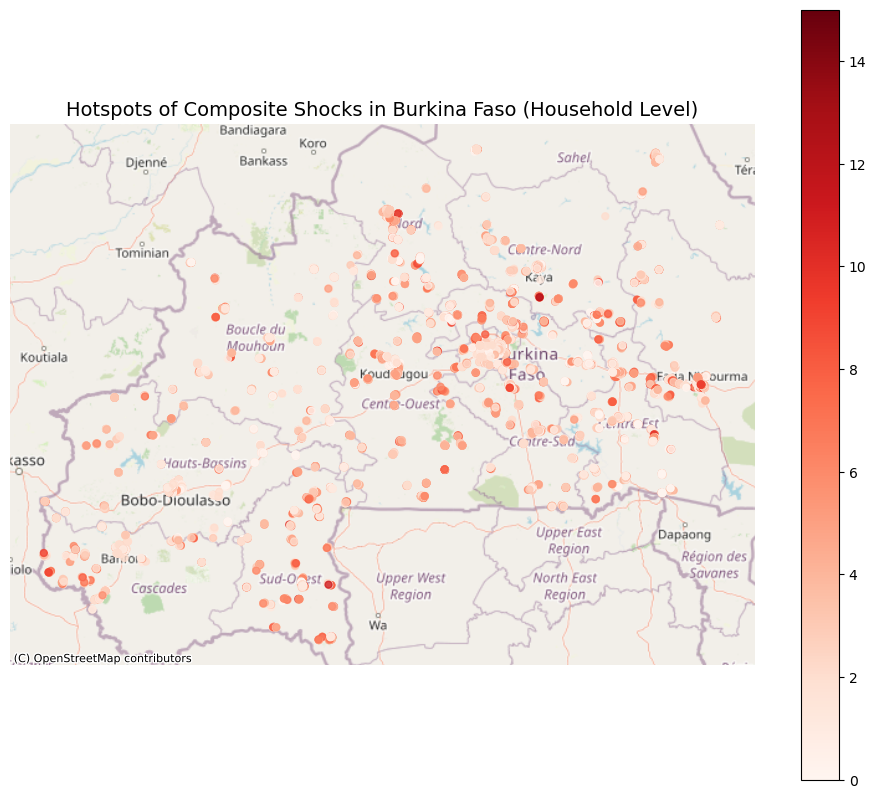

In [54]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# convert the merged DataFrame into a GeoDataFrame for spatial plotting
gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')


gdf = gdf.set_crs(epsg=4326)

# reproject the data to Web Mercator (EPSG:3857) so I can add a basemap using contextily
gdf = gdf.to_crs(epsg=3857)

#  plot composite shock intensity at the household level on a map
fig, ax = plt.subplots(figsize=(12, 10))
gdf.plot(
    ax=ax,
    column='total_experienced_composite_shocks',
    cmap='Reds',
    legend=True,
    markersize=25,
    alpha=0.8
)

# add the OpenStreetMap basemap to provide geographic context
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("Hotspots of Composite Shocks in Burkina Faso (Household Level)", fontsize=14)
ax.set_axis_off()


plt.show()


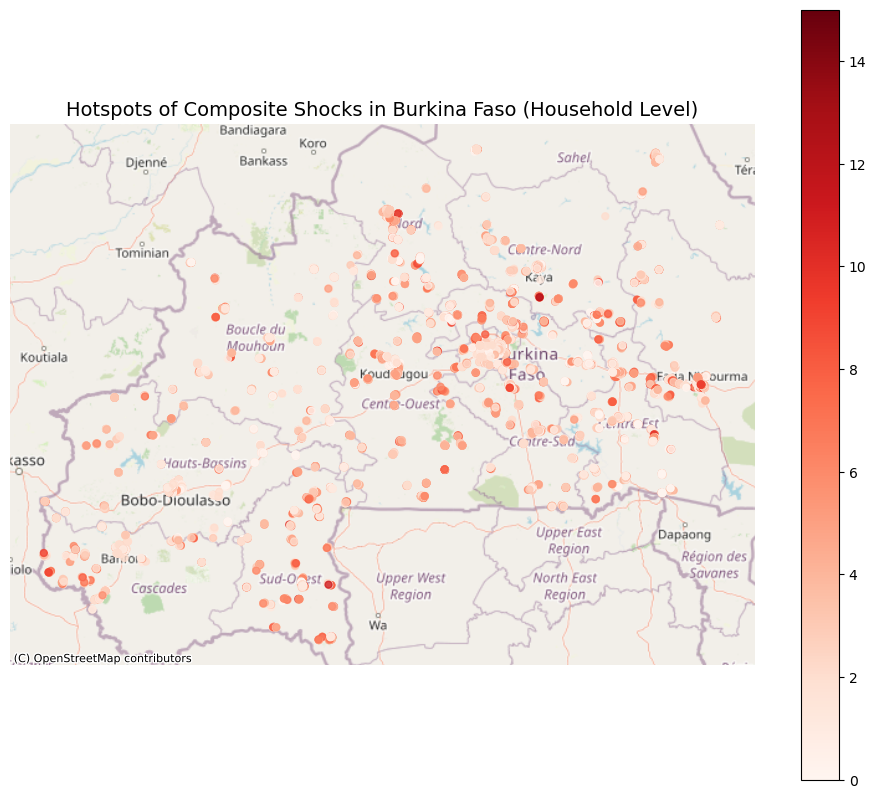

In [55]:
# visualize the spatial distribution of total experienced composite shocks.
# first convert the merged dataset to a GeoDataFrame, ensure it uses the correct CRS (WGS84),
# then reproject it to Web Mercator to enable adding a basemap. Finally, I plot the household-level
# shock intensities using a red gradient and overlay an OpenStreetMap basemap for context.


gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326)
gdf = gdf.to_crs(epsg=3857)

fig, ax = plt.subplots(figsize=(12, 10))
gdf.plot(
    ax=ax,
    column='total_experienced_composite_shocks',
    cmap='Reds',
    legend=True,
    markersize=25,
    alpha=0.8
)

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("Hotspots of Composite Shocks in Burkina Faso (Household Level)", fontsize=14)
ax.set_axis_off()
plt.show()


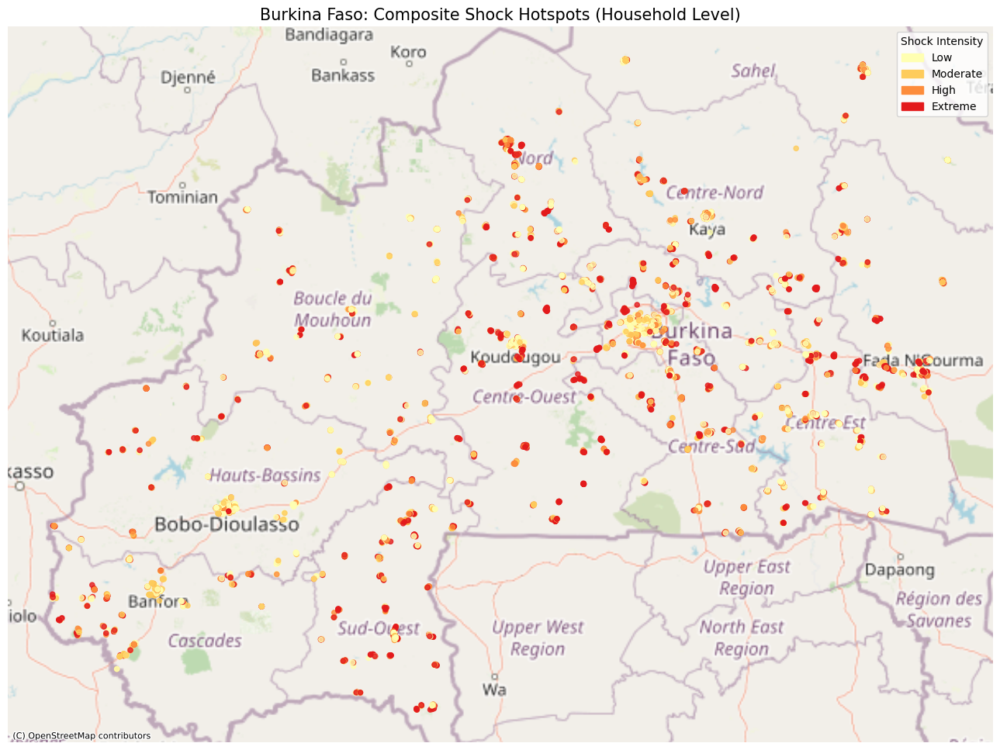

In [56]:
# generates an enhanced household-level map of composite shocks,
# Convert to GeoDataFrame and project for tile compatibility
gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

# Create quantile bins for clearer legend mapping
gdf['shock_bin'] = pd.qcut(gdf['total_experienced_composite_shocks'], q=4, labels=['Low', 'Moderate', 'High', 'Extreme'])

# Map color palette
color_map = {
    'Low': '#ffffb2',
    'Moderate': '#fecc5c',
    'High': '#fd8d3c',
    'Extreme': '#e31a1c'
}

gdf['color'] = gdf['shock_bin'].map(color_map)

# Plot
fig, ax = plt.subplots(figsize=(13, 11))
gdf.plot(ax=ax, color=gdf['color'], alpha=0.8, markersize=20)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

legend_patches = [mpatches.Patch(color=color_map[b], label=b) for b in color_map]
ax.legend(handles=legend_patches, title='Shock Intensity')


ax.set_title('Burkina Faso: Composite Shock Hotspots (Household Level)', fontsize=15)
ax.set_axis_off()

plt.tight_layout()
plt.show()


/Users/user/anaconda3/lib/python3.11/site-packages/shapely/measurement.py:103: RuntimeWarning: invalid value encountered in bounds
  return lib.bounds(geometry_arr, out=out, **kwargs)


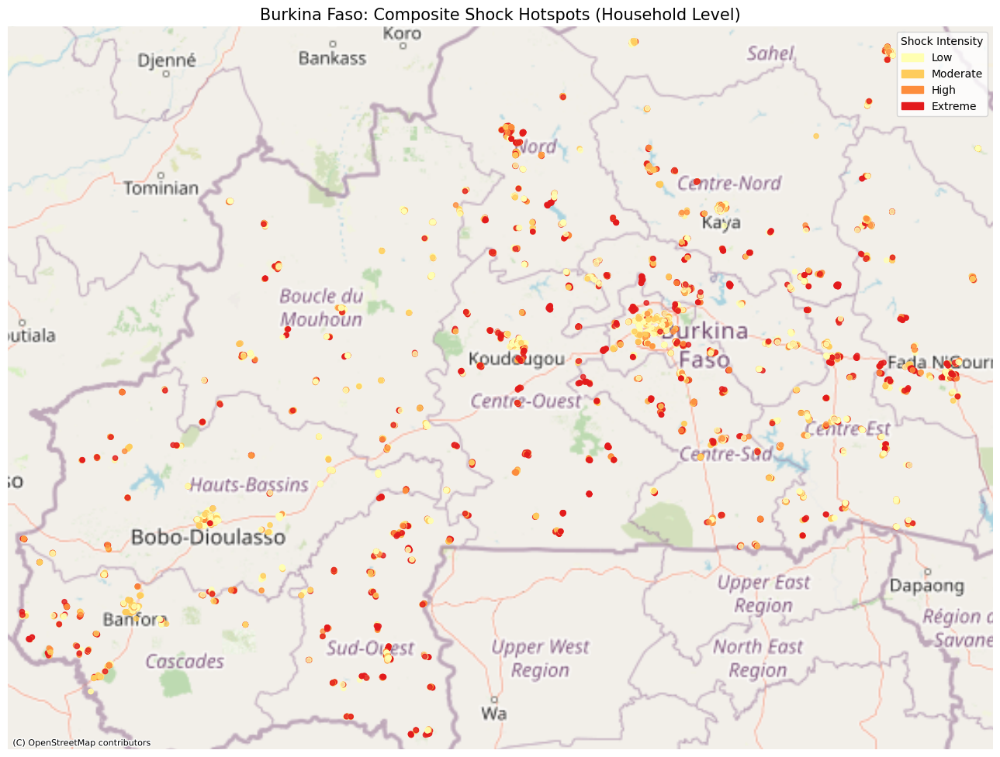

In [57]:
# visualizes composite household shocks across Burkina Faso with full country extent.
# I project coordinates, bin shock intensity, and add a contextual basemap, ensuring full spatial coverage.


# Project to Web Mercator
gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

# Create bins for shock levels
gdf['shock_bin'] = pd.qcut(gdf['total_experienced_composite_shocks'], q=4, labels=['Low', 'Moderate', 'High', 'Extreme'])

# Color mapping
color_map = {
    'Low': '#ffffb2',
    'Moderate': '#fecc5c',
    'High': '#fd8d3c',
    'Extreme': '#e31a1c'
}
gdf['color'] = gdf['shock_bin'].map(color_map)

# Plot with full extent
fig, ax = plt.subplots(figsize=(13, 11))
gdf.plot(ax=ax, color=gdf['color'], alpha=0.8, markersize=20)

# Set full spatial extent
xmin, ymin, xmax, ymax = gdf.total_bounds
ax.set_xlim(xmin - 10000, xmax + 10000)
ax.set_ylim(ymin - 10000, ymax + 10000)

# Add base map
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Add legend
legend_patches = [mpatches.Patch(color=color_map[b], label=b) for b in color_map]
ax.legend(handles=legend_patches, title='Shock Intensity')

# Title and styling
ax.set_title('Burkina Faso: Composite Shock Hotspots (Household Level)', fontsize=15)
ax.set_axis_off()
plt.tight_layout()
plt.show()


In [59]:
conda install -c conda-forge geodatasets


Channels:
 - conda-forge
 - defaults
Platform: osx-64
Solving environment: done

## Package Plan ##

  environment location: /Users/user/anaconda3

  added / updated specs:
    - geodatasets


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geodatasets-2024.8.0       |     pyhd8ed1ab_1          23 KB  conda-forge
    pooch-1.8.2                |     pyhd8ed1ab_1          53 KB  conda-forge
    ------------------------------------------------------------
                                           Total:          76 KB

The following NEW packages will be INSTALLED:

  geodatasets        conda-forge/noarch::geodatasets-2024.8.0-pyhd8ed1ab_1 
  pooch              conda-forge/noarch::pooch-1.8.2-pyhd8ed1ab_1 



pooch-1.8.2          | 53 KB     |                                       |   0% 
pooch-1.8.2          | 53 KB     | ##################################### | 100% 
geodatasets-2024.8.0 

In [ ]:
import geodatasets
import geopandas as gpd

# Load world boundaries from geodatasets
world = gpd.read_file(geodatasets.get_path('naturalearth.land'))
bfa = world[world['NAME'] == 'Burkina Faso'].to_crs(epsg=3857)


In [55]:
# visualize household-level composite shocks across Burkina Faso using the official GADM boundary overlay and a contextual basemap.
# Load the Burkina Faso admin1 shapefile (assuming .shp, .shx, and .dbf are all present in the folder)

shapefile_path = "/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp"

bfa_admin1 = gpd.read_file(shapefile_path).to_crs(epsg=3857)


gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

fig, ax = plt.subplots(figsize=(14, 12))
bfa_admin1.boundary.plot(ax=ax, edgecolor='black', linewidth=1)
gdf.plot(ax=ax, column='total_experienced_composite_shocks', cmap='Reds', legend=True, markersize=25, alpha=0.7)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("Hotspots of Composite Shocks in Burkina Faso (Household Level)", fontsize=14)
ax.set_axis_off()
plt.tight_layout()
plt.show()


NameError: name 'df_merged' is not defined

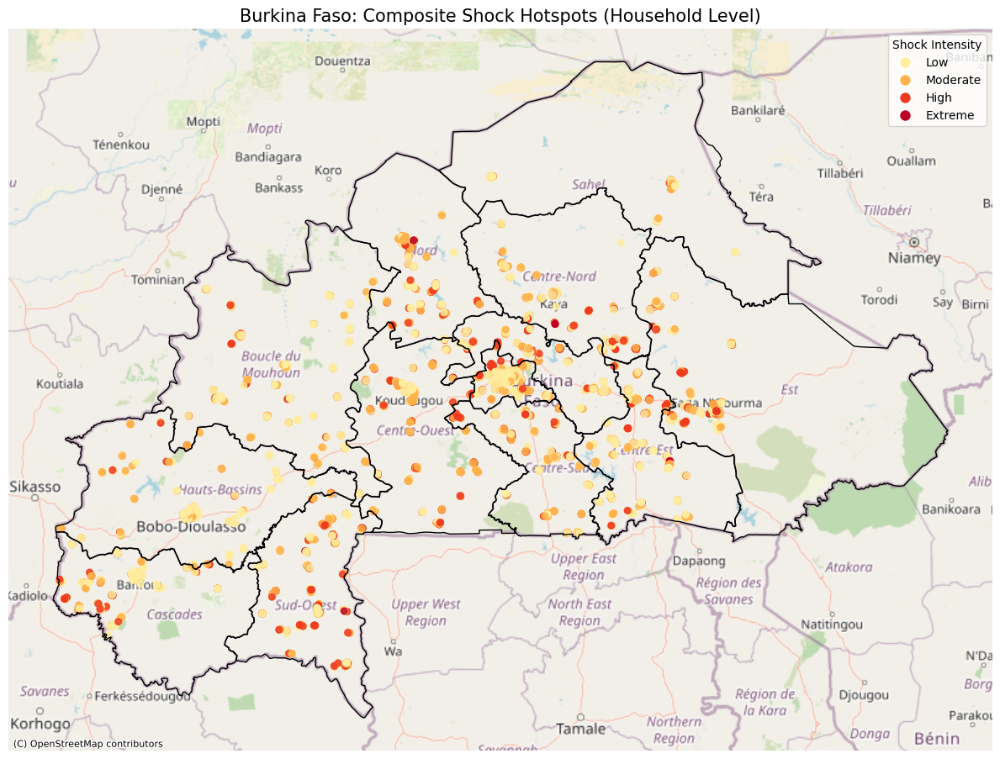

In [65]:
# Create bins for shock intensity

gdf['shock_category'] = pd.cut(
    gdf['total_experienced_composite_shocks'],
    bins=[-1, 2, 5, 9, gdf['total_experienced_composite_shocks'].max()],
    labels=["Low", "Moderate", "High", "Extreme"]
)

# Define color mapping
category_colors = {
    "Low": "#ffeda0",
    "Moderate": "#feb24c",
    "High": "#f03b20",
    "Extreme": "#bd0026"
}
gdf['color'] = gdf['shock_category'].map(category_colors)

# Plot setup
fig, ax = plt.subplots(figsize=(12, 10))
bfa_admin1.boundary.plot(ax=ax, color="black", linewidth=1)
gdf.plot(ax=ax, color=gdf['color'], markersize=30, alpha=0.85)

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("Burkina Faso: Composite Shock Hotspots (Household Level)", fontsize=15)
ax.set_axis_off()

# Custom Legend
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low', markerfacecolor=category_colors["Low"], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Moderate', markerfacecolor=category_colors["Moderate"], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High', markerfacecolor=category_colors["High"], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Extreme', markerfacecolor=category_colors["Extreme"], markersize=10)
]
ax.legend(handles=legend_elements, loc='upper right', title='Shock Intensity')

plt.tight_layout()
plt.show()


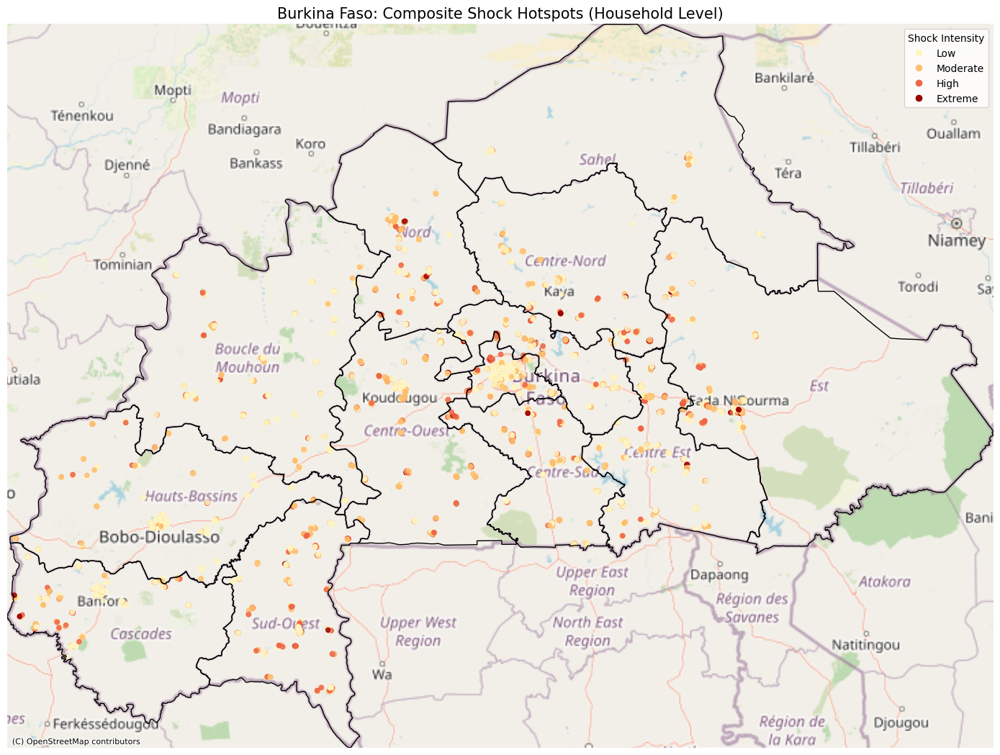

In [66]:
# Visualize household-level shock intensity with full Burkina Faso map extent


shapefile_path = "/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp"
bfa_admin1 = gpd.read_file(shapefile_path).to_crs(epsg=3857)

gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

bins = [0, 2, 5, 8, 100]
labels = ['Low', 'Moderate', 'High', 'Extreme']
colors = ['#fff5c3', '#fdbf6f', '#ef6548', '#990000']
color_map = dict(zip(labels, colors))

gdf['shock_bin'] = pd.cut(gdf['total_experienced_composite_shocks'], bins=bins, labels=labels, include_lowest=True)
gdf['color'] = gdf['shock_bin'].map(color_map)

fig, ax = plt.subplots(figsize=(14, 11))
bfa_admin1.boundary.plot(ax=ax, edgecolor='black', linewidth=1)
gdf.plot(ax=ax, color=gdf['color'], markersize=20, alpha=0.85)

legend_handles = [plt.Line2D([0], [0], marker='o', color='w', label=label,
                    markerfacecolor=color_map[label], markersize=8)
                    for label in labels]
ax.legend(handles=legend_handles, title="Shock Intensity", loc='upper right')

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Manually set full country bounds
xmin, ymin, xmax, ymax = bfa_admin1.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

ax.set_title("Burkina Faso: Composite Shock Hotspots (Household Level)", fontsize=15)
ax.axis('off')
plt.tight_layout()
plt.show()


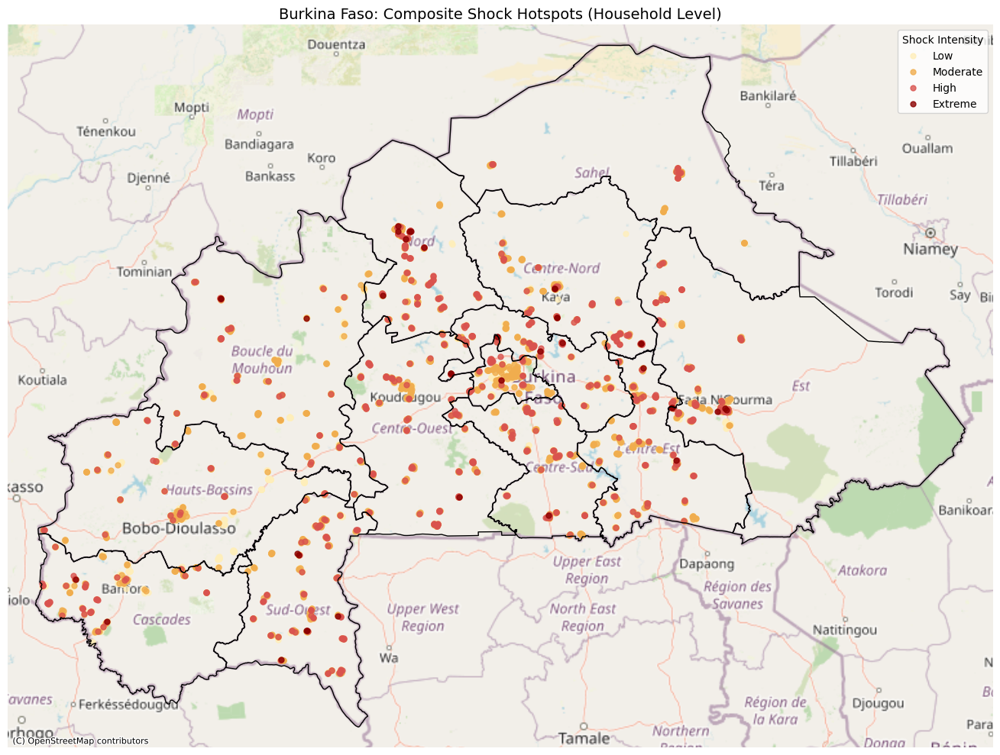

In [67]:
# Plot household-level composite shock hotspots across Burkina Faso using administrative boundaries and buffer-adjusted basemap extent

import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Load shapefile for Burkina Faso's first-level administrative boundaries (GADM)
shapefile_path = "/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp"
bfa_admin1 = gpd.read_file(shapefile_path).to_crs(epsg=3857)

# Prepare household-level merged data with shocks (assumed already merged and cleaned)
gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

# Define shock intensity bins and assign color labels
bins = [0, 2, 5, 9, gdf['total_experienced_composite_shocks'].max()]
labels = ['Low', 'Moderate', 'High', 'Extreme']
colors = ['#ffeeba', '#f0ad4e', '#d9534f', '#8B0000']
gdf['shock_bin'] = pd.cut(gdf['total_experienced_composite_shocks'], bins=bins, labels=labels, include_lowest=True)
gdf['color'] = gdf['shock_bin'].map(dict(zip(labels, colors)))

# Create plot
fig, ax = plt.subplots(figsize=(14, 10))

# Plot base administrative boundaries
bfa_admin1.boundary.plot(ax=ax, linewidth=1, edgecolor='black')

# Plot households colored by shock intensity
for label in labels:
    subset = gdf[gdf['shock_bin'] == label]
    subset.plot(ax=ax, markersize=25, color=dict(zip(labels, colors))[label], label=label, alpha=0.8)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Add legend and title
ax.legend(title='Shock Intensity', loc='upper right')
ax.set_title("Burkina Faso: Composite Shock Hotspots (Household Level)", fontsize=14)

# Buffer the map bounds slightly to avoid clipping regions
buffer_ratio = 0.03
xmin, ymin, xmax, ymax = bfa_admin1.total_bounds
x_buffer = (xmax - xmin) * buffer_ratio
y_buffer = (ymax - ymin) * buffer_ratio
ax.set_xlim(xmin - x_buffer, xmax + x_buffer)
ax.set_ylim(ymin - y_buffer, ymax + y_buffer)

# Hide axes
ax.set_axis_off()

plt.tight_layout()
plt.show()


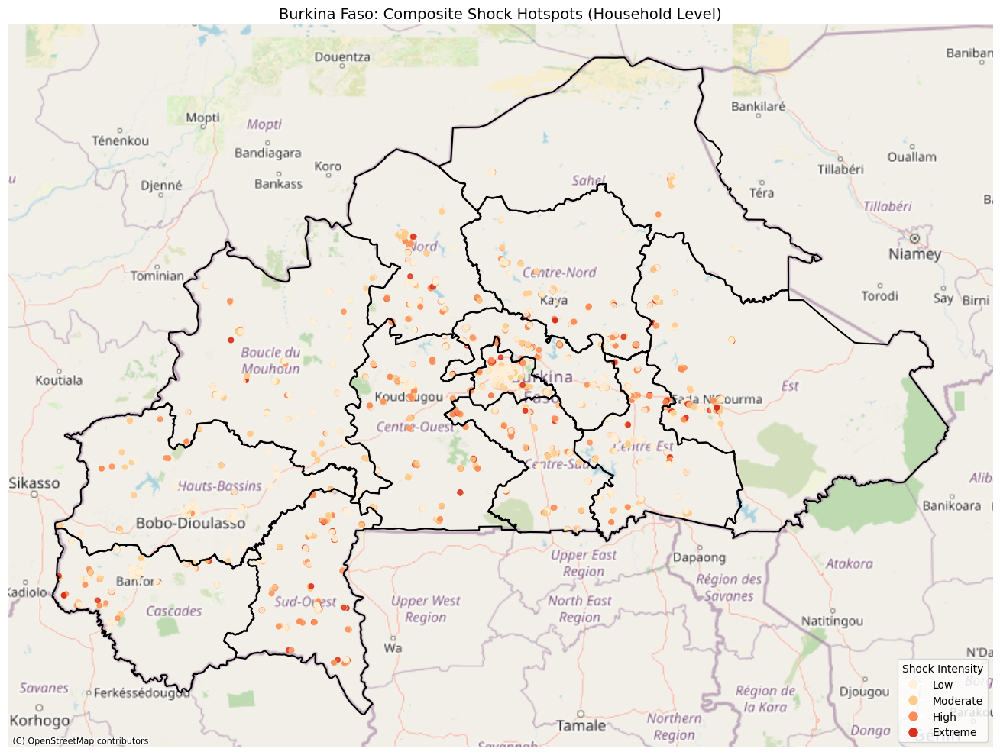

In [68]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# visualizes household-level composite shock intensity across Burkina Faso using administrative boundaries and a cleaner color scheme.

# Load household geodata
gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

# Load Burkina Faso admin1 shapefile
shapefile_path = "/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp"
bfa_admin1 = gpd.read_file(shapefile_path).to_crs(epsg=3857)

# Bin composite shock intensity
gdf['shock_bin'] = pd.cut(
    gdf['total_experienced_composite_shocks'],
    bins=[-1, 2, 4, 7, 99],
    labels=['Low', 'Moderate', 'High', 'Extreme']
)

# Define new custom color map
color_map = {
    'Low': '#fef0d9',
    'Moderate': '#fdcc8a',
    'High': '#fc8d59',
    'Extreme': '#d7301f'
}
gdf['color'] = gdf['shock_bin'].map(color_map)

# Plot the figure
fig, ax = plt.subplots(figsize=(14, 10))
bfa_admin1.boundary.plot(ax=ax, linewidth=1.5, edgecolor='black')
gdf.plot(ax=ax, color=gdf['color'], markersize=20, alpha=0.8)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Set title
ax.set_title("Burkina Faso: Composite Shock Hotspots (Household Level)", fontsize=14)

# Remove axis ticks
ax.set_axis_off()

# Create custom legend
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low', markerfacecolor='#fef0d9', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Moderate', markerfacecolor='#fdcc8a', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High', markerfacecolor='#fc8d59', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Extreme', markerfacecolor='#d7301f', markersize=10)
]
ax.legend(handles=legend_elements, title='Shock Intensity', loc='lower right', frameon=True)

plt.tight_layout()
plt.show()


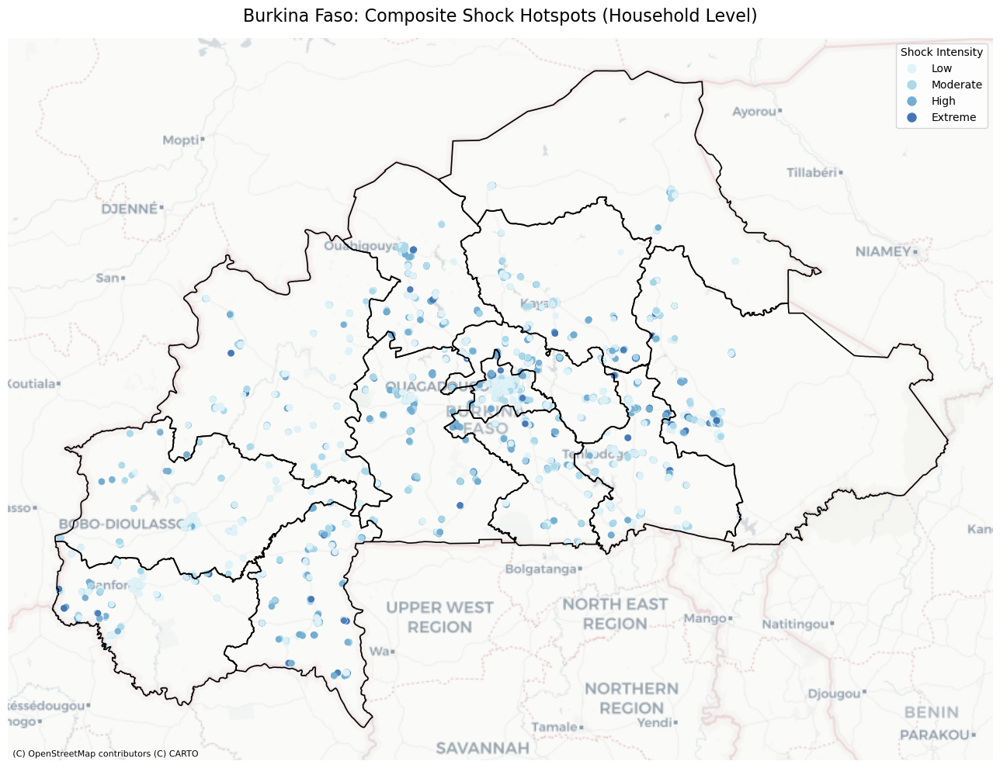

In [69]:
import matplotlib.pyplot as plt
import contextily as ctx
import pandas as pd
from matplotlib.lines import Line2D

# visualizes household-level composite shock intensity using a polished color palette and enhanced layout styling

gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

gdf['shock_bin'] = pd.cut(
    gdf['total_experienced_composite_shocks'],
    bins=[-1, 2, 4, 7, 99],
    labels=['Low', 'Moderate', 'High', 'Extreme']
)

color_map = {
    'Low': '#e0f3f8',
    'Moderate': '#abd9e9',
    'High': '#74add1',
    'Extreme': '#4575b4'
}
gdf['color'] = gdf['shock_bin'].map(color_map)

fig, ax = plt.subplots(figsize=(14, 10))
bfa_admin1.boundary.plot(ax=ax, linewidth=1.2, edgecolor='black')
gdf.plot(ax=ax, color=gdf['color'], markersize=24, alpha=0.9)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

ax.set_title("Burkina Faso: Composite Shock Hotspots (Household Level)", fontsize=16, pad=15)
ax.set_axis_off()

legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low', markerfacecolor=color_map['Low'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Moderate', markerfacecolor=color_map['Moderate'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High', markerfacecolor=color_map['High'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Extreme', markerfacecolor=color_map['Extreme'], markersize=10)
]
ax.legend(handles=legend_elements, title='Shock Intensity', loc='upper right', frameon=True)

plt.tight_layout()
plt.show()


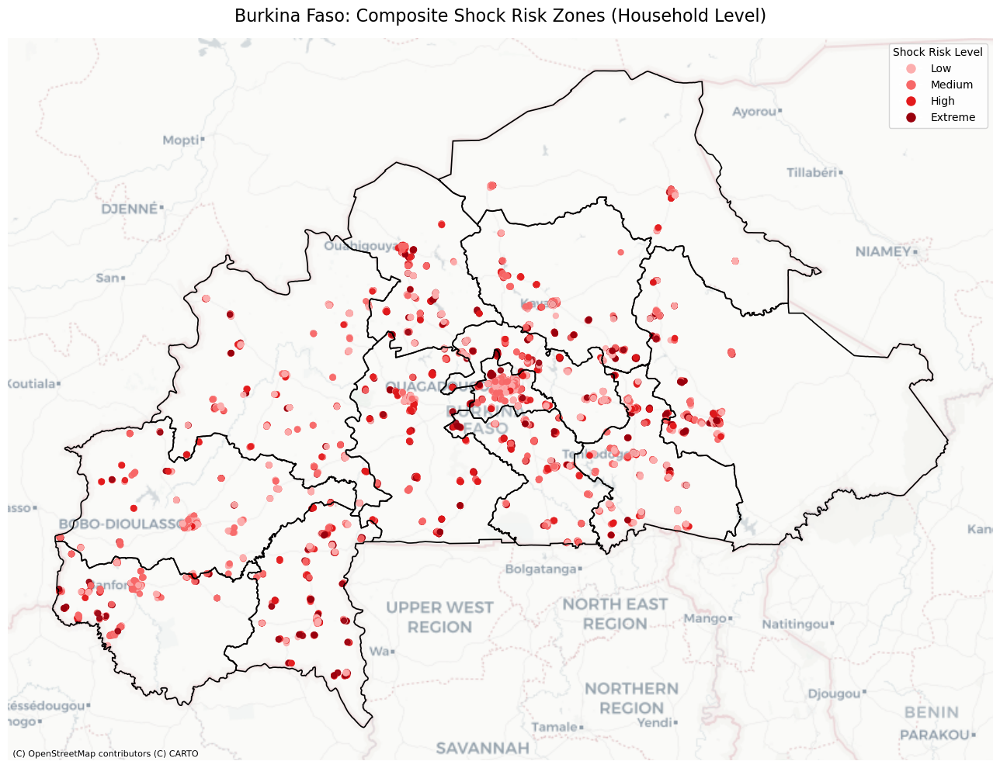

In [70]:
import matplotlib.pyplot as plt
import contextily as ctx
import pandas as pd
from matplotlib.lines import Line2D

# This code visualizes household-level composite shock risk using a clean red-gradient scale reflecting severity

gdf = gpd.GeoDataFrame(df_merged, geometry='geometry')
gdf = gdf.set_crs(epsg=4326).to_crs(epsg=3857)

gdf['shock_bin'] = pd.cut(
    gdf['total_experienced_composite_shocks'],
    bins=[-1, 1, 3, 5, 99],
    labels=['Low', 'Medium', 'High', 'Extreme']
)

color_map = {
    'Low': '#fcaeae',       # Light red
    'Medium': '#f76868',    # Medium red
    'High': '#e31a1c',      # Strong red
    'Extreme': '#99000d'    # Deep burgundy red
}
gdf['color'] = gdf['shock_bin'].map(color_map)

fig, ax = plt.subplots(figsize=(14, 10))
bfa_admin1.boundary.plot(ax=ax, linewidth=1.2, edgecolor='black')
gdf.plot(ax=ax, color=gdf['color'], markersize=25, alpha=0.9)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

ax.set_title("Burkina Faso: Composite Shock Risk Zones (Household Level)", fontsize=16, pad=15)
ax.set_axis_off()

legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low', markerfacecolor=color_map['Low'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Medium', markerfacecolor=color_map['Medium'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High', markerfacecolor=color_map['High'], markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Extreme', markerfacecolor=color_map['Extreme'], markersize=10)
]
ax.legend(handles=legend_elements, title='Shock Risk Level', loc='upper right', frameon=True)

plt.tight_layout()
plt.show()


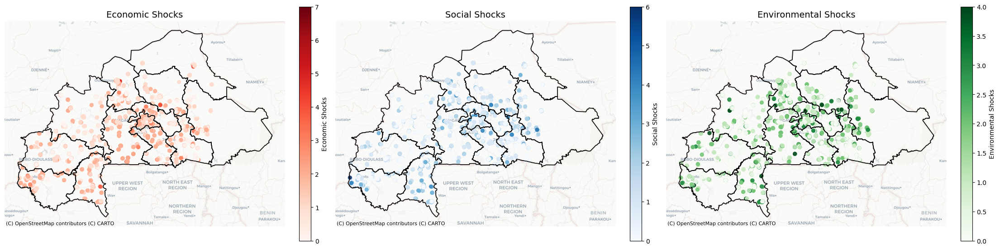

In [75]:
import matplotlib.pyplot as plt
import contextily as ctx

# Plotting household-level intensity of each shock type with improved color schemes
fig, axes = plt.subplots(1, 3, figsize=(22, 7), constrained_layout=True)

# Define each shock type column and corresponding display properties
shock_types = {
    'num_experienced_economic_shocks': ('Economic Shocks', 'Reds'),
    'num_experienced_social_shocks': ('Social Shocks', 'Blues'),
    'num_experienced_environmental_shocks': ('Environmental Shocks', 'Greens')
}

for ax, (col, (title, cmap)) in zip(axes, shock_types.items()):
    bfa_admin1.boundary.plot(ax=ax, edgecolor='black', linewidth=1.2)
    gdf.plot(
        column=col,
        cmap=cmap,
        ax=ax,
        markersize=30,
        alpha=0.85,
        legend=True,
        legend_kwds={'label': title, 'shrink': 0.75}
    )
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
    ax.set_title(title, fontsize=14)
    ax.axis('off')


In [73]:
print(gdf.columns)


Index(['Unnamed: 0', 'year', 'country', 'hhid', 'cluster', 'household_number',
       'wave', 'household_weight', 'region', 'prefecture_arrondissement',
       ...
       'shock_type_Taux élevé de maladies des cultures_max',
       'shock_type_Vol d'argent, de biens, de récolte ou de bétail_max',
       'shock_month', 'coping_other_specifies',
       'num_experienced_economic_shocks', 'num_experienced_social_shocks',
       'num_experienced_environmental_shocks',
       'total_experienced_composite_shocks', 'shock_bin', 'color'],
      dtype='object', length=135)


In [76]:
# Group by region and sum the shocks by type
region_shocks = df_merged.groupby('region')[[
    'num_experienced_economic_shocks',
    'num_experienced_social_shocks',
    'num_experienced_environmental_shocks',
    'total_experienced_composite_shocks'
]].sum().reset_index()


In [77]:
region_shocks

,region,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,boucle du mouhoum,531,317,463,1311
1,cascades,620,266,275,1161
2,centre,835,371,246,1452
3,centre-est,548,436,516,1500
4,centre-nord,444,471,500,1415
5,centre-ouest,683,421,549,1653
6,centre-sud,609,365,442,1416
7,est,379,544,566,1489
8,hauts-bassins,666,319,276,1261
9,nord,516,421,503,1440


<Figure size 1400x800 with 0 Axes>

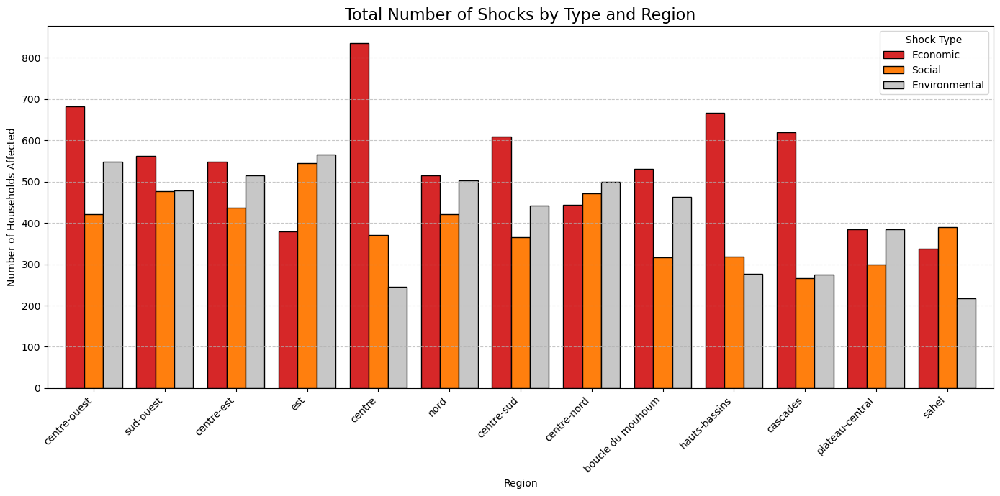

In [78]:
import matplotlib.pyplot as plt

# Set plot size and style
plt.figure(figsize=(14, 8))
region_shocks_sorted = region_shocks.sort_values(by='total_experienced_composite_shocks', ascending=False)

# Set region as index for cleaner plotting
plot_data = region_shocks_sorted.set_index('region')[
    ['num_experienced_economic_shocks', 'num_experienced_social_shocks', 'num_experienced_environmental_shocks']
]

# Create grouped bar chart
plot_data.plot(kind='bar', figsize=(14, 7), width=0.8,
               color=['#d62728', '#ff7f0e', '#c7c7c7'], edgecolor='black')

plt.title("Total Number of Shocks by Type and Region", fontsize=16)
plt.ylabel("Number of Households Affected")
plt.xlabel("Region")
plt.xticks(rotation=45, ha='right')
plt.legend(["Economic", "Social", "Environmental"], title="Shock Type")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


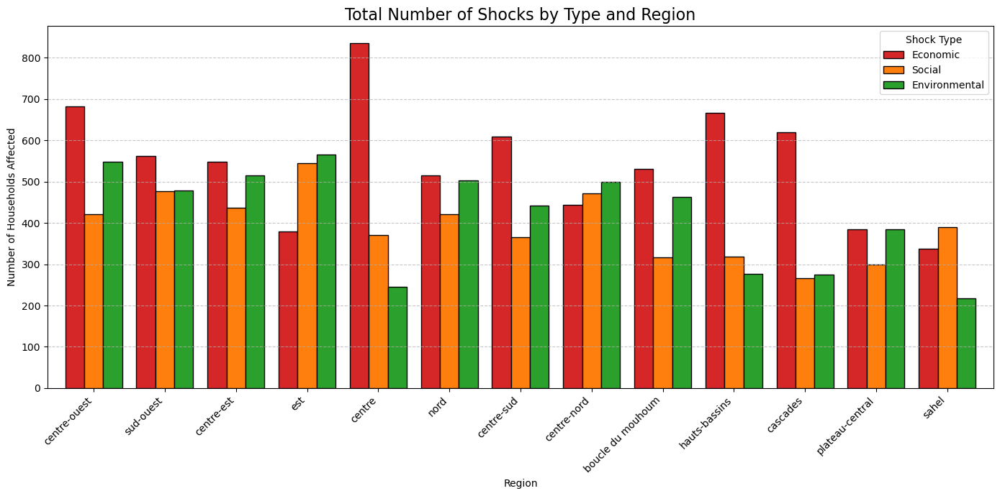

In [79]:
import matplotlib.pyplot as plt

# Sort by total shocks for better visual ranking
region_shocks_sorted = region_shocks.sort_values(
    by='total_experienced_composite_shocks', ascending=False
)

# Prepare data for plotting
plot_data = region_shocks_sorted.set_index('region')[
    ['num_experienced_economic_shocks', 'num_experienced_social_shocks', 'num_experienced_environmental_shocks']
]

# Create grouped bar chart with improved color palette
plot_data.plot(
    kind='bar',
    figsize=(14, 7),
    width=0.8,
    color=['#d62728', '#ff7f0e', '#2ca02c'],  # Red, Orange, Green
    edgecolor='black'
)

plt.title("Total Number of Shocks by Type and Region", fontsize=16)
plt.ylabel("Number of Households Affected")
plt.xlabel("Region")
plt.xticks(rotation=45, ha='right')
plt.legend(["Economic", "Social", "Environmental"], title="Shock Type")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [56]:
# Load the Burkina Faso admin1 shapefile (assuming .shp, .shx, and .dbf are all present in the folder)
shapefile_path = "/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp"

bfa_admin1 = gpd.read_file(shapefile_path).to_crs(epsg=3857)


In [80]:
df_roster = pd.read_csv("bfa_2021_roster_individuals_cleaned.csv")
df_roster

/var/folders/6s/941yxkvd7_vchrqbh62fdjph0000gn/T/ipykernel_73462/3098264680.py:1: DtypeWarning: Columns (37) have mixed types. Specify dtype option on import or set low_memory=False.
  df_roster = pd.read_csv("bfa_2021_roster_individuals_cleaned.csv")


,household_id,cluster,household_identifier,wave,household_weight,member_id,sex,relationship_to_head,birth_day,birth_month,...,mother_institutional_sector,has_mobile_phone,used_phone_last_7_days,prepaid_card_expenditure_7_days,internet_access_phone,internet_access_office,internet_access_cybercafe,internet_access_home,internet_access_school,still_member_of_household
0,586005,586,5,2,439,1,Masculin,Chef de ménage,28.0,Mars,...,Ménage,Oui,NaN,1500.0,1.0,0.0,0.0,0.0,0.0,NaN
1,586005,586,5,2,439,2,Féminin,Conjoint ( e ),8.0,Décembre,...,Ménage,Oui,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2,586005,586,5,2,439,3,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Oui,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3,586005,586,5,2,439,4,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,Non,NaN,0.0,0.0,0.0,0.0,0.0,NaN
4,586005,586,5,2,439,5,Masculin,"Fils, Fille",1.0,Janvier,...,NaN,Non,Non,NaN,0.0,0.0,0.0,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47085,1185051,1185,51,1,821,4,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,Non,NaN,0.0,0.0,0.0,0.0,0.0,NaN
47086,1185051,1185,51,1,821,5,Féminin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,Non,NaN,NaN,NaN,NaN,NaN,NaN,NaN
47087,1185051,1185,51,1,821,6,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
47088,1185051,1185,51,1,821,7,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [81]:
df_roster.columns

Index(['household_id', 'cluster', 'household_identifier', 'wave',
       'household_weight', 'member_id', 'sex', 'relationship_to_head',
       'birth_day', 'birth_month', 'birth_year', 'age_last_birthday',
       'age_month', 'has_birth_certificate', 'birth_certificate_shown',
       'respondent_id', 'respondent_section', 'marital_status',
       'spouse_lives_in_household', 'spouse_id_1', 'spouse_id_2',
       'spouse_id_3', 'spouse_id_4', 'spouse_id_5', 'spouse_id_6',
       'spouse_id_7', 'spouse_id_8', 'age_first_marriage', 'present_at_survey',
       'resident_6_months', 'intend_stay_6_months', 'religion', 'nationality',
       'ethnicity', 'born_in_locality', 'lived_elsewhere_6_months',
       'last_locality_before_here', 'last_locality_other',
       'years_in_last_locality', 'main_reason_move_here', 'other_reason_move',
       'years_in_current_locality', 'father_in_household', 'father_name',
       'father_alive', 'father_education_level', 'father_industry',
       'father_oc

In [83]:
# Convert relevant variables to numeric (1 if yes/true, 0 if no/false or missing)
df_roster['has_mobile_phone'] = df_roster['has_mobile_phone'].astype(str).str.lower().str.strip().map({'1': 1, 'yes': 1, 'true': 1, '0': 0, 'no': 0, 'false': 0})
df_roster['internet_access_phone'] = df_roster['internet_access_phone'].astype(str).str.lower().str.strip().map({'1': 1, 'yes': 1, 'true': 1, '0': 0, 'no': 0, 'false': 0})


In [84]:
# Summarize household roster into household-level features

# Tag household head rows
df_roster['is_head'] = df_roster['relationship_to_head'] == 1

# Household-level summary
df_roster_summary = df_roster.groupby(['wave', 'cluster', 'household_id']).agg(
    num_members=('member_id', 'count'),
    num_females=('sex', lambda x: (x == 2).sum()),
    num_children=('age_last_birthday', lambda x: (x < 15).sum()),
    any_mobile_phone=('has_mobile_phone', 'max'),
    any_internet_access=('internet_access_phone', 'max'),
    mean_prepaid_spending=('prepaid_card_expenditure_7_days', 'mean'),
    head_sex=('sex', lambda x: x[df_roster.loc[x.index, 'is_head']].values[0] if any(df_roster.loc[x.index, 'is_head']) else np.nan),
    head_age=('age_last_birthday', lambda x: x[df_roster.loc[x.index, 'is_head']].values[0] if any(df_roster.loc[x.index, 'is_head']) else np.nan),
    head_ethnicity=('ethnicity', lambda x: x[df_roster.loc[x.index, 'is_head']].values[0] if any(df_roster.loc[x.index, 'is_head']) else np.nan),
    head_education_level=('father_education_level', lambda x: x[df_roster.loc[x.index, 'is_head']].values[0] if any(df_roster.loc[x.index, 'is_head']) else np.nan),
).reset_index()


In [85]:
df_roster_summary

,wave,cluster,household_id,num_members,num_females,num_children,any_mobile_phone,any_internet_access,mean_prepaid_spending,head_sex,head_age,head_ethnicity,head_education_level
0,1,588,588028,24,0,0,NaN,NaN,1841.666667,NaN,NaN,NaN,NaN
1,1,588,588032,9,0,0,NaN,NaN,500.000000,NaN,NaN,NaN,NaN
2,1,588,588040,5,0,0,NaN,NaN,1000.000000,NaN,NaN,NaN,NaN
3,1,588,588043,6,0,0,NaN,NaN,250.000000,NaN,NaN,NaN,NaN
4,1,588,588044,4,0,0,NaN,NaN,800.000000,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2,1184,1184144,1,0,0,NaN,NaN,250.000000,NaN,NaN,NaN,NaN
7172,2,1184,1184159,6,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7173,2,1184,1184164,5,0,2,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
7174,2,1184,1184165,6,0,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [128]:
df_roster_summary.to_csv("roster_hh_level_cleaned_data.csv")

In [90]:
df_roster_summary.rename(columns={'household_id': 'hhid'}, inplace=True)


In [91]:
df_merged = df_merged.merge(
    df_roster_summary,
    how='left',
    on=['wave', 'cluster', 'hhid']
)


In [92]:
df_merged

,Unnamed: 0,year,country,hhid,cluster,household_number,wave,household_weight,region,prefecture_arrondissement,...,num_members,num_females,num_children,any_mobile_phone,any_internet_access,mean_prepaid_spending,head_sex,head_age,head_ethnicity,head_education_level
0,0,2021,Burkina Faso,586005,586,5,2,439,boucle du mouhoum,kossi,...,8,0,0,NaN,NaN,500.000000,NaN,NaN,NaN,NaN
1,1,2021,Burkina Faso,586028,586,28,2,439,boucle du mouhoum,kossi,...,33,0,0,NaN,NaN,686.363636,NaN,NaN,NaN,NaN
2,2,2021,Burkina Faso,586043,586,43,2,439,boucle du mouhoum,kossi,...,4,0,0,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
3,3,2021,Burkina Faso,586044,586,44,2,439,boucle du mouhoum,kossi,...,12,0,5,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
4,4,2021,Burkina Faso,586052,586,52,2,439,boucle du mouhoum,kossi,...,12,0,5,NaN,NaN,200.000000,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7123,7171,2021,Burkina Faso,1185033,1185,33,1,821,est,gnagna,...,6,0,0,NaN,NaN,325.000000,NaN,NaN,NaN,NaN
7124,7172,2021,Burkina Faso,1185034,1185,34,1,821,est,gnagna,...,5,0,0,NaN,NaN,1500.000000,NaN,NaN,NaN,NaN
7125,7173,2021,Burkina Faso,1185035,1185,35,1,821,est,gnagna,...,6,0,0,NaN,NaN,1500.000000,NaN,NaN,NaN,NaN
7126,7174,2021,Burkina Faso,1185047,1185,47,1,821,est,gnagna,...,6,0,0,NaN,NaN,450.000000,NaN,NaN,NaN,NaN


In [93]:
df_merged.to_csv("bfa_cleaned_merged_geo_shocks_roster_data.csv")

In [94]:
df_merged.columns

Index(['Unnamed: 0', 'year', 'country', 'hhid', 'cluster', 'household_number',
       'wave', 'household_weight', 'region', 'prefecture_arrondissement',
       ...
       'num_members', 'num_females', 'num_children', 'any_mobile_phone',
       'any_internet_access', 'mean_prepaid_spending', 'head_sex', 'head_age',
       'head_ethnicity', 'head_education_level'],
      dtype='object', length=143)

In [112]:
df_welfare = pd.read_csv("welfare indicators.csv")

In [113]:
df_welfare

,country,year,hhid,grappe,menage,vague,zae,region,milieu,hhweight,...,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles
0,bfa,2021,586005,586,5,2,Grand-ouest,Boucle du Mouhoum,Rural,439,...,0.944294,1.063717,2,-83175.906250,0,0.000000,0.000000,0,4,7
1,bfa,2021,586028,586,28,2,Grand-ouest,Boucle du Mouhoum,Rural,439,...,0.944294,1.063717,2,-120967.125000,0,0.000000,0.000000,0,4,7
2,bfa,2021,586043,586,43,2,Grand-ouest,Boucle du Mouhoum,Rural,439,...,0.944294,1.063717,2,30382.843750,100,12.260752,1.503260,1,2,4
3,bfa,2021,586044,586,44,2,Grand-ouest,Boucle du Mouhoum,Rural,439,...,0.944294,1.063717,2,159511.750000,100,64.369682,41.434559,1,1,1
4,bfa,2021,586052,586,52,2,Grand-ouest,Boucle du Mouhoum,Rural,439,...,0.944294,1.063717,2,162776.843750,100,65.687286,43.148193,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,bfa,2021,1185033,1185,33,1,Grand-est,Est,Rural,821,...,0.965259,0.916654,4,71534.953125,100,28.867353,8.333241,1,2,3
7172,bfa,2021,1185034,1185,34,1,Grand-est,Est,Rural,821,...,0.965259,0.916654,4,-278069.093750,0,0.000000,0.000000,0,5,9
7173,bfa,2021,1185035,1185,35,1,Grand-est,Est,Rural,821,...,0.965259,0.916654,4,-104596.593750,0,0.000000,0.000000,0,4,7
7174,bfa,2021,1185047,1185,47,1,Grand-est,Est,Rural,821,...,0.965259,0.916654,4,60980.531250,100,24.608202,6.055636,1,2,3


In [114]:
df_welfare = df_welfare.rename(columns={
    'grappe': 'cluster',
    'menage': 'household_number',
    'vague': 'wave',
    'hhweight': 'household_weight'
})

id_cols = ['year', 'country', 'hhid', 'cluster', 'household_number', 'wave', 'household_weight']
other_cols = [col for col in df_welfare.columns if col not in id_cols]
df_welfare = df_welfare[id_cols + other_cols]


In [115]:
df_welfare

,year,country,hhid,cluster,household_number,wave,household_weight,zae,region,milieu,...,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles
0,2021,bfa,586005,586,5,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,-83175.906250,0,0.000000,0.000000,0,4,7
1,2021,bfa,586028,586,28,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,-120967.125000,0,0.000000,0.000000,0,4,7
2,2021,bfa,586043,586,43,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,30382.843750,100,12.260752,1.503260,1,2,4
3,2021,bfa,586044,586,44,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,159511.750000,100,64.369682,41.434559,1,1,1
4,2021,bfa,586052,586,52,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,162776.843750,100,65.687286,43.148193,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,bfa,1185033,1185,33,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,71534.953125,100,28.867353,8.333241,1,2,3
7172,2021,bfa,1185034,1185,34,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,-278069.093750,0,0.000000,0.000000,0,5,9
7173,2021,bfa,1185035,1185,35,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,-104596.593750,0,0.000000,0.000000,0,4,7
7174,2021,bfa,1185047,1185,47,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,60980.531250,100,24.608202,6.055636,1,2,3


In [116]:
df_welfare['country'] = df_welfare['country'].replace({'bfa': 'Burkina Faso'})


In [117]:
df_welfare

,year,country,hhid,cluster,household_number,wave,household_weight,zae,region,milieu,...,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles
0,2021,Burkina Faso,586005,586,5,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,-83175.906250,0,0.000000,0.000000,0,4,7
1,2021,Burkina Faso,586028,586,28,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,-120967.125000,0,0.000000,0.000000,0,4,7
2,2021,Burkina Faso,586043,586,43,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,30382.843750,100,12.260752,1.503260,1,2,4
3,2021,Burkina Faso,586044,586,44,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,159511.750000,100,64.369682,41.434559,1,1,1
4,2021,Burkina Faso,586052,586,52,2,439,Grand-ouest,Boucle du Mouhoum,Rural,...,0.944294,1.063717,2,162776.843750,100,65.687286,43.148193,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,Burkina Faso,1185033,1185,33,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,71534.953125,100,28.867353,8.333241,1,2,3
7172,2021,Burkina Faso,1185034,1185,34,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,-278069.093750,0,0.000000,0.000000,0,5,9
7173,2021,Burkina Faso,1185035,1185,35,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,-104596.593750,0,0.000000,0.000000,0,4,7
7174,2021,Burkina Faso,1185047,1185,47,1,821,Grand-est,Est,Rural,...,0.965259,0.916654,4,60980.531250,100,24.608202,6.055636,1,2,3


In [119]:
# Ensure both hhid columns are strings
df_merged['hhid'] = df_merged['hhid'].astype(str).str.strip()
df_welfare['hhid'] = df_welfare['hhid'].astype(str).str.strip()
df_welfare['country'] = df_welfare['country'].replace({'bfa': 'Burkina Faso'})

# Merge using hhid only
df_merged1 = df_merged.merge(df_welfare, how='left', on='hhid')


In [122]:
df_merged_1 = pd.read_csv("bfa_cleaned_merged_geo_shocks_roster_data.csv")
df_merged_1

,Unnamed: 0.1,Unnamed: 0,year,country,hhid,cluster,household_number,wave,household_weight,region,...,num_members,num_females,num_children,any_mobile_phone,any_internet_access,mean_prepaid_spending,head_sex,head_age,head_ethnicity,head_education_level
0,0,0,2021,Burkina Faso,586005,586,5,2,439,boucle du mouhoum,...,8,0,0,NaN,NaN,500.000000,NaN,NaN,NaN,NaN
1,1,1,2021,Burkina Faso,586028,586,28,2,439,boucle du mouhoum,...,33,0,0,NaN,NaN,686.363636,NaN,NaN,NaN,NaN
2,2,2,2021,Burkina Faso,586043,586,43,2,439,boucle du mouhoum,...,4,0,0,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
3,3,3,2021,Burkina Faso,586044,586,44,2,439,boucle du mouhoum,...,12,0,5,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
4,4,4,2021,Burkina Faso,586052,586,52,2,439,boucle du mouhoum,...,12,0,5,NaN,NaN,200.000000,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7123,7123,7171,2021,Burkina Faso,1185033,1185,33,1,821,est,...,6,0,0,NaN,NaN,325.000000,NaN,NaN,NaN,NaN
7124,7124,7172,2021,Burkina Faso,1185034,1185,34,1,821,est,...,5,0,0,NaN,NaN,1500.000000,NaN,NaN,NaN,NaN
7125,7125,7173,2021,Burkina Faso,1185035,1185,35,1,821,est,...,6,0,0,NaN,NaN,1500.000000,NaN,NaN,NaN,NaN
7126,7126,7174,2021,Burkina Faso,1185047,1185,47,1,821,est,...,6,0,0,NaN,NaN,450.000000,NaN,NaN,NaN,NaN


In [123]:
df_geo

,hhid,cluster,household_number,wave,household_weight,country,region,prefecture_arrondissement,commune,residence_type,...,interview_date_2_end,interview_date_3_end,interview_result,questionnaire_result,interview_language,gps_latitude,gps_longitude,survey_duration_days,gps_valid,geometry
0,586005,586,5,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,2022-05-21 16:37:27,2022-05-24 08:31:40,"Rempli, ménage sélectionné",Complet,Dioula,13.124,-4.163,2,True,POINT (-4.163 13.124)
1,586028,586,28,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,2022-05-22 19:13:14,2022-05-24 09:04:57,"Rempli, ménage sélectionné",Complet,Moore,13.126,-4.165,4,True,POINT (-4.165 13.126)
2,586043,586,43,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,2022-05-21 08:03:43,2022-05-24 09:52:12,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.167,3,True,POINT (-4.167 13.122)
3,586044,586,44,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,2022-05-20 08:59:00,2022-05-21 14:00:37,"Rempli, ménage sélectionné",Complet,Dioula,13.122,-4.168,1,True,POINT (-4.168 13.122)
4,586052,586,52,2,439,Burkina Faso,boucle du mouhoum,kossi,djibasso,rural,...,2022-05-20 12:12:49,2022-05-21 14:54:25,"Rempli, ménage sélectionné",Complet,Dioula,13.127,-4.164,1,True,POINT (-4.164 13.127)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,1,821,Burkina Faso,est,gnagna,bogande,rural,...,2021-11-08 13:52:41,2021-11-10 11:48:02,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231,2,True,POINT (-0.231 12.952)
7172,1185034,1185,34,1,821,Burkina Faso,est,gnagna,bogande,rural,...,2021-11-07 15:09:53,2021-11-12 10:44:10,"Rempli, ménage sélectionné",Complet,Français,12.952,-0.231,4,True,POINT (-0.231 12.952)
7173,1185035,1185,35,1,821,Burkina Faso,est,gnagna,bogande,rural,...,2021-11-09 09:42:36,2021-11-11 11:08:03,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.952,-0.231,3,True,POINT (-0.231 12.952)
7174,1185047,1185,47,1,821,Burkina Faso,est,gnagna,bogande,rural,...,2021-11-08 09:17:05,2021-11-09 09:13:35,"Rempli, ménage sélectionné",Complet,Gourmatchema,12.951,-0.232,1,True,POINT (-0.232 12.951)


In [125]:
df_household

,year,country,hhid,cluster,household_number,hh_weight,shock_respondent_first,shock_occurred_last3y_max,shock_environmental_max,shock_social_max,...,shock_type_Sécheresse/Pluies irrégulières_max,shock_type_Taux élevé de maladies des animaux_max,shock_type_Taux élevé de maladies des cultures_max,"shock_type_Vol d'argent, de biens, de récolte ou de bétail_max",shock_month,coping_other_specifies,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,2021,burkina faso,586005,586,5,439,2.0,1.0,1,1,...,True,True,True,True,Avril,,0,1,0,1
1,2021,burkina faso,586028,586,28,439,1.0,1.0,1,1,...,True,True,True,True,"Octobre, Décembre",,1,2,0,3
2,2021,burkina faso,586043,586,43,439,2.0,1.0,1,1,...,True,True,True,True,"Septembre, Mai",,1,1,1,3
3,2021,burkina faso,586044,586,44,439,1.0,1.0,1,1,...,True,True,True,True,"Avril, Août",,1,0,1,2
4,2021,burkina faso,586052,586,52,439,1.0,1.0,1,1,...,True,True,True,True,"Mai, Ne sait pas",,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,burkina faso,1185033,1185,33,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Juillet",,1,2,3,6
7172,2021,burkina faso,1185034,1185,34,821,3.0,1.0,1,1,...,True,True,True,True,"Ne sait pas, Avril, Mai, Février, Août",,2,2,4,8
7173,2021,burkina faso,1185035,1185,35,821,2.0,1.0,1,1,...,True,True,True,True,Août,,0,0,1,1
7174,2021,burkina faso,1185047,1185,47,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Octobre, Juillet, Juin",,1,2,3,6


In [129]:
df_roster_summary

,wave,cluster,hhid,num_members,num_females,num_children,any_mobile_phone,any_internet_access,mean_prepaid_spending,head_sex,head_age,head_ethnicity,head_education_level
0,1,588,588028,24,0,0,NaN,NaN,1841.666667,NaN,NaN,NaN,NaN
1,1,588,588032,9,0,0,NaN,NaN,500.000000,NaN,NaN,NaN,NaN
2,1,588,588040,5,0,0,NaN,NaN,1000.000000,NaN,NaN,NaN,NaN
3,1,588,588043,6,0,0,NaN,NaN,250.000000,NaN,NaN,NaN,NaN
4,1,588,588044,4,0,0,NaN,NaN,800.000000,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2,1184,1184144,1,0,0,NaN,NaN,250.000000,NaN,NaN,NaN,NaN
7172,2,1184,1184159,6,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7173,2,1184,1184164,5,0,2,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
7174,2,1184,1184165,6,0,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [130]:
# Ensure all ID columns are standardized

df_geo = df_geo.rename(columns={'household_weight': 'hhweight'})
df_welfare = df_welfare.rename(columns={'household_weight': 'hhweight'})

# Add missing 'year' and 'country' to all datasets except df_welfare
for df in [df_geo, df_household, df_roster_summary]:
    df['year'] = df_welfare['year'].iloc[0]
    df['country'] = df_welfare['country'].iloc[0]

# Merge all datasets into df_merged_full
df_merged_full = df_welfare.merge(
    df_geo, on=['hhid', 'cluster', 'household_number', 'wave', 'country', 'year'], how='left'
).merge(
    df_household, on=['hhid', 'cluster', 'household_number', 'country', 'year'], how='left'
).merge(
    df_roster_summary, on=['hhid', 'cluster', 'wave', 'country', 'year'], how='left'
)


ValueError: You are trying to merge on object and int64 columns. If you wish to proceed you should use pd.concat

In [131]:
df_roster

,household_id,cluster,household_identifier,wave,household_weight,member_id,sex,relationship_to_head,birth_day,birth_month,...,has_mobile_phone,used_phone_last_7_days,prepaid_card_expenditure_7_days,internet_access_phone,internet_access_office,internet_access_cybercafe,internet_access_home,internet_access_school,still_member_of_household,is_head
0,586005,586,5,2,439,1,Masculin,Chef de ménage,28.0,Mars,...,NaN,NaN,1500.0,NaN,0.0,0.0,0.0,0.0,NaN,False
1,586005,586,5,2,439,2,Féminin,Conjoint ( e ),8.0,Décembre,...,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,False
2,586005,586,5,2,439,3,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,False
3,586005,586,5,2,439,4,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,NaN,NaN,0.0,0.0,0.0,0.0,NaN,False
4,586005,586,5,2,439,5,Masculin,"Fils, Fille",1.0,Janvier,...,NaN,Non,NaN,NaN,0.0,0.0,0.0,0.0,NaN,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47085,1185051,1185,51,1,821,4,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,NaN,NaN,0.0,0.0,0.0,0.0,NaN,False
47086,1185051,1185,51,1,821,5,Féminin,"Fils, Fille",NaN,Ne sait pas,...,NaN,Non,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
47087,1185051,1185,51,1,821,6,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
47088,1185051,1185,51,1,821,7,Masculin,"Fils, Fille",NaN,Ne sait pas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [132]:
df_shock

,Unnamed: 0,hhid,cluster,household_code,year,hh_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_environmental,...,shock_type_Maladie grave ou accident d'un membre du ménage,shock_type_Perte d'emploi salarié d'un membre,shock_type_Perte importante de revenus salariaux (autre que du fait d'un accident ou d'une maladie),shock_type_Perte importante du revenu non agricole du ménage (autre que du fait d'un accident ou d'une maladie),shock_type_Prix élevés des intrants agricoles,shock_type_Prix élevés des produits alimentaires,shock_type_Sécheresse/Pluies irrégulières,shock_type_Taux élevé de maladies des animaux,shock_type_Taux élevé de maladies des cultures,"shock_type_Vol d'argent, de biens, de récolte ou de bétail"
0,0,586005,586,5,2021,439,2.0,Taux élevé de maladies des animaux,0.0,1,...,False,False,False,False,False,False,False,True,False,False
1,1,586005,586,5,2021,439,2.0,Conflit armé/Violence/Insécurité,1.0,0,...,False,False,False,False,False,False,False,False,False,False
2,2,586005,586,5,2021,439,2.0,Décès d'un membre du ménage,0.0,0,...,False,False,False,False,False,False,False,False,False,False
3,3,586005,586,5,2021,439,2.0,Faillite d'une entreprise non agricole du ménage,0.0,0,...,False,False,False,False,False,False,False,False,False,False
4,4,586005,586,5,2021,439,2.0,Taux élevé de maladies des cultures,0.0,1,...,False,False,False,False,False,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157867,157867,1185051,1185,51,2021,821,1.0,Sécheresse/Pluies irrégulières,1.0,1,...,False,False,False,False,False,False,True,False,False,False
157868,157868,1185051,1185,51,2021,821,1.0,Décès d'un membre du ménage,0.0,0,...,False,False,False,False,False,False,False,False,False,False
157869,157869,1185051,1185,51,2021,821,1.0,Conflit Agriculteur/Eleveur,0.0,0,...,False,False,False,False,False,False,False,False,False,False
157870,157870,1185051,1185,51,2021,821,1.0,Baisse importante des prix des produits agricoles,0.0,0,...,False,False,False,False,False,False,False,False,False,False


In [134]:
df_shock.columns

Index(['Unnamed: 0', 'hhid', 'cluster', 'household_code', 'year', 'hh_weight',
       'shock_respondent', 'shock_type', 'shock_occurred_last3y',
       'shock_environmental', 'shock_social', 'shock_economic', 'shock_month',
       'shock_year', 'shock_effect_income', 'shock_effect_assets',
       'shock_effect_agri_prod', 'shock_effect_livestock',
       'shock_effect_food_stock', 'shock_effect_food_purchase',
       'coping_savings', 'coping_family_help', 'coping_govt_help',
       'coping_ngo_help', 'coping_marry_daughters',
       'coping_change_consumption', 'coping_buy_cheaper_food',
       'coping_extra_jobs_active', 'coping_unemployed_work',
       'coping_children_work', 'coping_children_out_school',
       'coping_migration', 'coping_reduce_health_edu', 'coping_credit',
       'coping_sell_agri_assets', 'coping_sell_durables',
       'coping_sell_property', 'coping_lease_land', 'coping_sell_food_stock',
       'coping_fishing', 'coping_sell_livestock', 'coping_send_children_aw

In [136]:
# This code aggregates LSMS shock microdata to the household level, preserving identifiers, coping strategies, shock impacts, and categorizing shocks into economic, social, and environmental groups.
coping_cols = [col for col in df_shock.columns if col.startswith('coping_') and '_used' not in col and col != 'coping_other_specify']
df_shock[coping_cols] = df_shock[coping_cols].fillna(0).astype(int)
df_aff = df_shock[df_shock['shock_occurred_last3y'].astype(str).str.lower() == 'oui'].copy()
shock_dummy_cols = [col for col in df_shock.columns if col.startswith("shock_type_")]
df_shock_types = df_aff[['hhid'] + shock_dummy_cols].groupby('hhid').max().reset_index()
impact_cols = [
    'shock_effect_income', 'shock_effect_assets', 'shock_effect_agri_prod',
    'shock_effect_livestock', 'shock_effect_food_stock', 'shock_effect_food_purchase'
]
df_agg = df_shock.groupby('hhid')[coping_cols + impact_cols].max().reset_index()
id_vars = ['hhid', 'cluster', 'household_code', 'year', 'hh_weight']
df_ids = df_shock[id_vars].drop_duplicates(subset='hhid')
df_shock_hh = df_ids.merge(df_shock_types, on='hhid', how='left') \
                    .merge(df_agg, on='hhid', how='left')
df_shock_hh[shock_dummy_cols] = df_shock_hh[shock_dummy_cols].fillna(0)

shock_groups = {
    'shock_economic': [
        'shock_type_Baisse importante des prix des produits agricoles',
        "shock_type_Perte d'emploi salarié d'un membre",
        "shock_type_Faillite d'une entreprise non agricole du ménage",
        "shock_type_Perte importante du revenu non agricole du ménage  (autre que du fait d'un accident ou d'une maladie)",
        "shock_type_Fin de transferts réguliers provenant d'autres ménages",
        "shock_type_Prix élevés des produits alimentaires",
        "shock_type_Prix élevés des intrants agricoles",
        "shock_type_Vol d'argent, de biens, de récolte ou de bétail"
    ],
    'shock_social': [
        "shock_type_Conflit armé/Violence/Insécurité",
        "shock_type_Conflit Agriculteur/Eleveur",
        "shock_type_Décès d'un membre du ménage",
        "shock_type_Divorce, séparation",
        "shock_type_Maladie grave ou accident d'un membre du ménage"
    ],
    'shock_environmental': [
        "shock_type_Sécheresse/Pluies irrégulières",
        "shock_type_Inondations",
        "shock_type_Incendies",
        "shock_type_Attaques acridiennes ou autres ravageurs de récolte",
        "shock_type_Taux élevé de maladies des cultures",
        "shock_type_Taux élevé de maladies des animaux",
        "shock_type_Glissement de terrain"
    ]
}

for group, cols in shock_groups.items():
    present_cols = [col for col in cols if col in df_shock_hh.columns]
    df_shock_hh[group] = df_shock_hh[present_cols].max(axis=1) if present_cols else 0


In [137]:
df_shock_hh

,hhid,cluster,household_code,year,hh_weight,shock_type_Attaques acridiennes ou autres ravageurs de récolte,shock_type_Autre (à préciser),shock_type_Baisse importante des prix des produits agricoles,shock_type_Conflit Agriculteur/Eleveur,shock_type_Conflit armé/Violence/Insécurité,...,coping_no_strategy,shock_effect_income,shock_effect_assets,shock_effect_agri_prod,shock_effect_livestock,shock_effect_food_stock,shock_effect_food_purchase,shock_economic,shock_social,shock_environmental
0,586005,586,5,2021,439,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
1,586028,586,28,2021,439,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
2,586043,586,43,2021,439,0,0,0,0,0,...,1,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
3,586044,586,44,2021,439,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
4,586052,586,52,2021,439,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,1185033,1185,33,2021,821,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7172,1185034,1185,34,2021,821,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7173,1185035,1185,35,2021,821,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7174,1185047,1185,47,2021,821,0,0,0,0,0,...,0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0


In [140]:
# This code aggregates LSMS shock microdata to the household level, preserving identifiers, coping strategies, shock impacts, and categorizing shocks into economic, social, and environmental groups, ensuring that grouped shock categories are not falsely triggered for households without actual shocks.

coping_cols = [col for col in df_shock.columns if col.startswith('coping_') and '_used' not in col and col != 'coping_other_specify']
df_shock[coping_cols] = df_shock[coping_cols].fillna(0).astype(int)
df_aff = df_shock[df_shock['shock_occurred_last3y'].astype(str).str.lower() == 'oui'].copy()
shock_dummy_cols = [col for col in df_shock.columns if col.startswith("shock_type_")]
df_shock_types = df_aff[['hhid'] + shock_dummy_cols].groupby('hhid').max().reset_index()
impact_cols = [
    'shock_effect_income', 'shock_effect_assets', 'shock_effect_agri_prod',
    'shock_effect_livestock', 'shock_effect_food_stock', 'shock_effect_food_purchase'
]
df_agg = df_shock.groupby('hhid')[coping_cols + impact_cols].max().reset_index()
id_vars = ['hhid', 'cluster', 'household_code', 'year', 'hh_weight']
df_ids = df_shock[id_vars].drop_duplicates(subset='hhid')
df_shock_hh = df_ids.merge(df_shock_types, on='hhid', how='left') \
                    .merge(df_agg, on='hhid', how='left')

shock_groups = {
    'shock_economic': [
        'shock_type_Baisse importante des prix des produits agricoles',
        "shock_type_Perte d'emploi salarié d'un membre",
        "shock_type_Faillite d'une entreprise non agricole du ménage",
        "shock_type_Perte importante du revenu non agricole du ménage  (autre que du fait d'un accident ou d'une maladie)",
        "shock_type_Fin de transferts réguliers provenant d'autres ménages",
        "shock_type_Prix élevés des produits alimentaires",
        "shock_type_Prix élevés des intrants agricoles",
        "shock_type_Vol d'argent, de biens, de récolte ou de bétail"
    ],
    'shock_social': [
        "shock_type_Conflit armé/Violence/Insécurité",
        "shock_type_Conflit Agriculteur/Eleveur",
        "shock_type_Décès d'un membre du ménage",
        "shock_type_Divorce, séparation",
        "shock_type_Maladie grave ou accident d'un membre du ménage"
    ],
    'shock_environmental': [
        "shock_type_Sécheresse/Pluies irrégulières",
        "shock_type_Inondations",
        "shock_type_Incendies",
        "shock_type_Attaques acridiennes ou autres ravageurs de récolte",
        "shock_type_Taux élevé de maladies des cultures",
        "shock_type_Taux élevé de maladies des animaux",
        "shock_type_Glissement de terrain"
    ]
}

for group, cols in shock_groups.items():
    present_cols = [col for col in cols if col in df_shock_hh.columns]
    df_shock_hh[group] = df_shock_hh[present_cols].max(axis=1) if present_cols else 0

df_shock_hh[shock_dummy_cols + list(shock_groups.keys())] = df_shock_hh[
    shock_dummy_cols + list(shock_groups.keys())
].fillna(0)


In [143]:
df_household

,year,country,hhid,cluster,household_number,hh_weight,shock_respondent_first,shock_occurred_last3y_max,shock_environmental_max,shock_social_max,...,shock_type_Sécheresse/Pluies irrégulières_max,shock_type_Taux élevé de maladies des animaux_max,shock_type_Taux élevé de maladies des cultures_max,"shock_type_Vol d'argent, de biens, de récolte ou de bétail_max",shock_month,coping_other_specifies,num_experienced_economic_shocks,num_experienced_social_shocks,num_experienced_environmental_shocks,total_experienced_composite_shocks
0,2021,Burkina Faso,586005,586,5,439,2.0,1.0,1,1,...,True,True,True,True,Avril,,0,1,0,1
1,2021,Burkina Faso,586028,586,28,439,1.0,1.0,1,1,...,True,True,True,True,"Octobre, Décembre",,1,2,0,3
2,2021,Burkina Faso,586043,586,43,439,2.0,1.0,1,1,...,True,True,True,True,"Septembre, Mai",,1,1,1,3
3,2021,Burkina Faso,586044,586,44,439,1.0,1.0,1,1,...,True,True,True,True,"Avril, Août",,1,0,1,2
4,2021,Burkina Faso,586052,586,52,439,1.0,1.0,1,1,...,True,True,True,True,"Mai, Ne sait pas",,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,Burkina Faso,1185033,1185,33,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Juillet",,1,2,3,6
7172,2021,Burkina Faso,1185034,1185,34,821,3.0,1.0,1,1,...,True,True,True,True,"Ne sait pas, Avril, Mai, Février, Août",,2,2,4,8
7173,2021,Burkina Faso,1185035,1185,35,821,2.0,1.0,1,1,...,True,True,True,True,Août,,0,0,1,1
7174,2021,Burkina Faso,1185047,1185,47,821,1.0,1.0,1,1,...,True,True,True,True,"Août, Octobre, Juillet, Juin",,1,2,3,6


In [144]:
df_household["num_experienced_economic_shocks"].value_counts()

num_experienced_economic_shocks
1    3026
0    2236
2    1652
3     227
4      29
5       3
6       2
7       1
Name: count, dtype: int64

In [57]:
master_data = pd.read_csv("bfa_merged_geo_shock_roster_welfare_housing.csv")

/var/folders/6s/941yxkvd7_vchrqbh62fdjph0000gn/T/ipykernel_50865/3686149174.py:1: DtypeWarning: Columns (109,193,198,230,239,247,281,310,312) have mixed types. Specify dtype option on import or set low_memory=False.
  master_data = pd.read_csv("bfa_merged_geo_shock_roster_welfare_housing.csv")


In [58]:
master_data

,year_x,country,hhid,cluster,household_number,wave,household_weight_x,shock_respondent,shock_type,shock_occurred_last3y,...,excreta_disposal_method,excreta_disposal_location,excreta_disposal_other,wastewater_disposal_method,wastewater_disposal_other,child_feces_disposal_last_time,child_feces_disposal_other,handwashing_place_observed,soap_or_cleaning_present,main_handwashing_times
0,2021,Burkina Faso,586005,586,5,2,439,2,Taux élevé de maladies des animaux,0.0,...,Fosse septique,Camion vidangeur,NaN,Egout,NaN,Les selles ont été mises/ jetées à l'air libre,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger
1,2021,Burkina Faso,586028,586,28,2,439,1,Prix élevés des intrants agricoles,0.0,...,Fosse septique,Camion vidangeur,NaN,Egout,NaN,Les selles ont été mises ou jetées dans les to...,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger
2,2021,Burkina Faso,586043,586,43,2,439,2,Taux élevé de maladies des animaux,1.0,...,NaN,NaN,NaN,Dans la rue/nature,NaN,Les selles ont été jetées dans les ordures,NaN,"Observé, non fixe","Eau, uniquement",A la sortie des toilettes
3,2021,Burkina Faso,586044,586,44,2,439,1,Maladie grave ou accident d'un membre du ménage,0.0,...,Fosse simple,Vidange manuelle,NaN,Dans la rue/nature,NaN,Les selles ont été jetées dans les ordures,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger
4,2021,Burkina Faso,586052,586,52,2,439,1,Glissement de terrain,0.0,...,Fosse simple,Vidange manuelle,NaN,Dans la rue/nature,NaN,NaN,NaN,"Observé, non fixe","Eau, uniquement",A la sortie des toilettes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,Burkina Faso,1185033,1185,33,1,821,1,Glissement de terrain,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7172,2021,Burkina Faso,1185034,1185,34,1,821,3,Taux élevé de maladies des cultures,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7173,2021,Burkina Faso,1185035,1185,35,1,821,2,Conflit armé/Violence/Insécurité,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7174,2021,Burkina Faso,1185047,1185,47,1,821,1,"Vol d'argent, de biens, de récolte ou de bétail",0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [201]:
import os
os.getcwd()

'/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF'

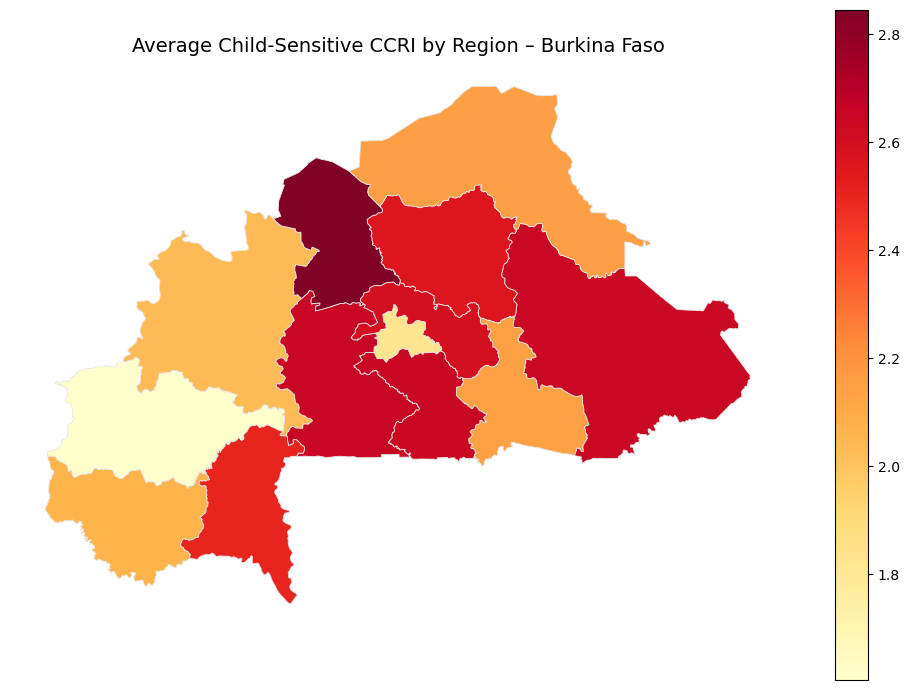

In [59]:
gdf = master_data.copy()
gdf['geometry'] = gdf.apply(
    lambda row: Point(row['gps_longitude'], row['gps_latitude'])
    if pd.notnull(row['gps_latitude']) and pd.notnull(row['gps_longitude'])
    else None,
    axis=1
)
gdf = gpd.GeoDataFrame(gdf, geometry='geometry', crs='EPSG:4326')

shapefile_path = '/Users/user/Desktop/OSAKA UNIVERSITY/FINDEX_DATA/LSMS/WHOLE_LSMS_CLEANING/UNICEF/gadm41_BFA_shp/gadm41_BFA_1.shp'
region_shp = gpd.read_file(shapefile_path).to_crs(gdf.crs)

gdf_valid = gdf[gdf['geometry'].notnull()].copy()
gdf_invalid = gdf[gdf['geometry'].isnull()].copy()

gdf_valid = gpd.sjoin(gdf_valid, region_shp[['NAME_1', 'geometry']], how='left', predicate='within')
gdf_invalid['NAME_1'] = None

gdf = pd.concat([gdf_valid, gdf_invalid], ignore_index=True)

for col in ['shock_economic', 'shock_social', 'shock_environmental']:
    gdf[col] = gdf[col].fillna(0).astype(int)

gdf['ccri'] = gdf['shock_economic'] + gdf['shock_social'] + gdf['shock_environmental']

ccri_by_region = gdf.dropna(subset=['NAME_1']).groupby('NAME_1')['ccri'].mean().reset_index()

map_df = region_shp.merge(ccri_by_region, on='NAME_1', how='left')

fig, ax = plt.subplots(figsize=(10, 7))
map_df.plot(column='ccri', cmap='YlOrRd', linewidth=0.6, ax=ax, edgecolor='0.9', legend=True)
ax.set_title('Average Child-Sensitive CCRI by Region – Burkina Faso', fontsize=14)
ax.axis('off')
plt.tight_layout()
plt.show()


In [60]:
# Show region names with their average CCRI scores
ccri_by_region_sorted = ccri_by_region.sort_values(by='ccri', ascending=False)
print(ccri_by_region_sorted)

# Optionally, save to CSV for inclusion in reports
ccri_by_region_sorted.to_csv('average_ccri_by_region.csv', index=False)


               NAME_1      ccri
9                Nord  2.844444
5        Centre-Ouest  2.646465
6          Centre-Sud  2.641667
7                 Est  2.638037
10    Plateau-Central  2.594675
4         Centre-Nord  2.561905
12          Sud-Ouest  2.501984
11              Sahel  2.148984
3          Centre-Est  2.142857
1            Cascades  2.065891
0   Boucle du Mouhoun  2.040000
2              Centre  1.818750
8        Haut-Bassins  1.604651


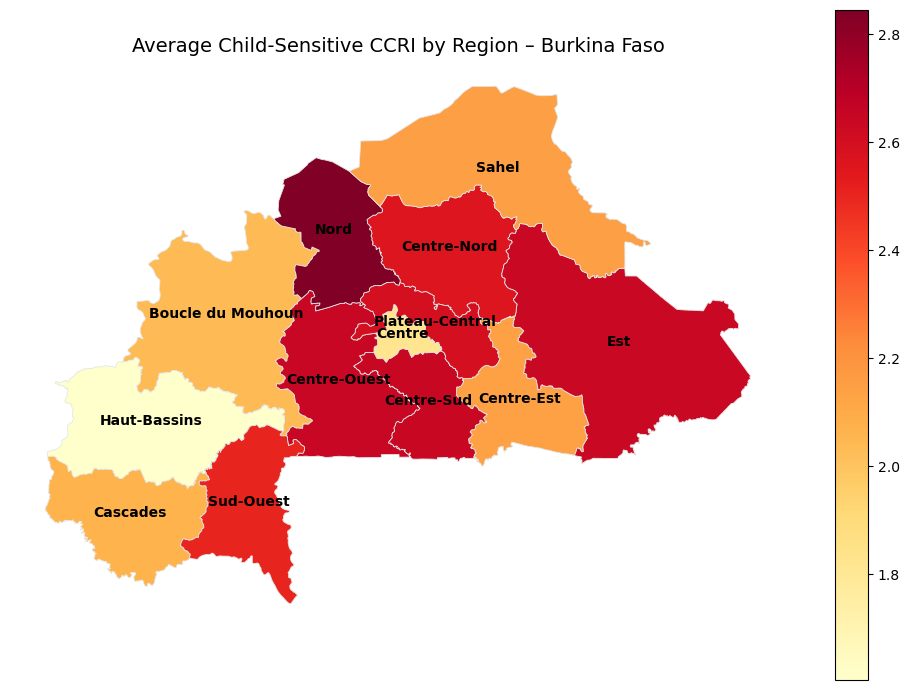

In [61]:
fig, ax = plt.subplots(figsize=(10, 7))
map_df.plot(column='ccri', cmap='YlOrRd', linewidth=0.6, ax=ax, edgecolor='0.9', legend=True)
ax.set_title('Average Child-Sensitive CCRI by Region – Burkina Faso', fontsize=14)
ax.axis('off')

# Add region name labels at the centroid of each polygon
for idx, row in map_df.iterrows():
    if row['geometry'].geom_type == 'MultiPolygon':
        centroid = row['geometry'].representative_point()
    else:
        centroid = row['geometry'].centroid
    ax.annotate(row['NAME_1'], xy=(centroid.x, centroid.y),
                horizontalalignment='center', fontsize=10, fontweight='bold', color='black')

plt.tight_layout()
plt.show()


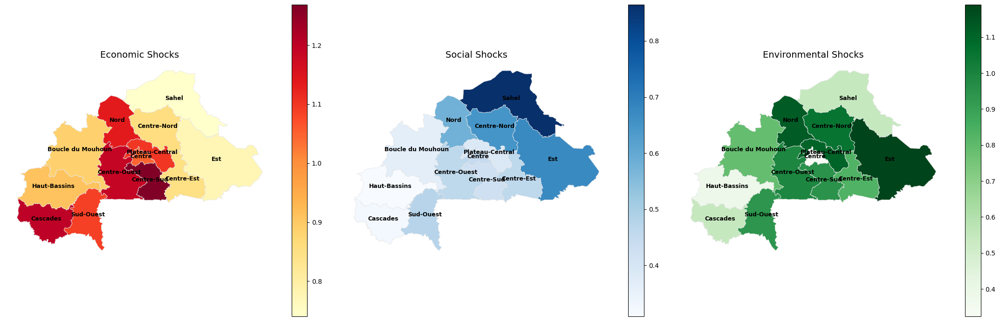

In [62]:
fig, axs = plt.subplots(1, 3, figsize=(22, 7), sharey=True)

shock_types = ['shock_economic', 'shock_social', 'shock_environmental']
titles = ['Economic Shocks', 'Social Shocks', 'Environmental Shocks']
cmaps = ['YlOrRd', 'Blues', 'Greens']

for i, shock in enumerate(shock_types):
    # Compute average shock intensity by region
    avg_shock = gdf.dropna(subset=['NAME_1']).groupby('NAME_1')[shock].mean().reset_index()
    map_shock = region_shp.merge(avg_shock, on='NAME_1', how='left')
    
    # Plot the map
    map_shock.plot(column=shock, cmap=cmaps[i], linewidth=0.6, ax=axs[i], edgecolor='0.9', legend=True)
    axs[i].set_title(titles[i], fontsize=14)
    axs[i].axis('off')

    # Add region labels
    for idx, row in map_shock.iterrows():
        if row['geometry'].geom_type == 'MultiPolygon':
            centroid = row['geometry'].representative_point()
        else:
            centroid = row['geometry'].centroid
        axs[i].annotate(row['NAME_1'], xy=(centroid.x, centroid.y), 
                        horizontalalignment='center', fontsize=9, fontweight='bold', color='black')

plt.tight_layout()
plt.show()


In [142]:
print(gdf.columns.tolist())


['id', 'geometry']


In [171]:
map_shock.columns

Index(['GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1',
       'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1', 'geometry',
       'shock_environmental'],
      dtype='object')

In [181]:
map_shock

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,shock_environmental
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",0.790000
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",0.544574
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",0.323750
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",0.832827
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",1.055238
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",0.993266
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",0.947917
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",1.190184
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",0.384405
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",1.128889


In [185]:
map_df


,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444


In [158]:
data_master['country'] = data_master['country'].str.title()
data_master

,year,country,cluster,wave,hhid,household_number,respondent_id,respondent_id.1,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_economic,shock_social,shock_environmental,shock_mean,shock_total,shock_month,shock_year,shock_effect_income,shock_effect_assets,shock_effect_agri_prod,shock_effect_livestock,shock_effect_food_stock,shock_effect_food_purchase,coping_savings,coping_family_help,coping_govt_help,coping_ngo_help,coping_marry_daughters,coping_change_consumption,coping_buy_cheaper_food,coping_extra_jobs_active,coping_unemployed_work,coping_children_work,coping_children_out_school,coping_migration,coping_reduce_health_edu,coping_credit,coping_sell_agri_assets,coping_sell_durables,coping_sell_property,coping_lease_land,coping_sell_food_stock,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies,unnamed: 0,region,prefecture_arrondissement,commune,residence_type,village_quartier,household_type,recent_mover,migration_reason,interviewed_2018_2019,interviewed_2018_other,interview_visits_required,interview_date_1_start,interview_date_2_start,interview_date_3_start,interview_date_1_end,interview_date_2_end,interview_date_3_end,interview_result,questionnaire_result,interview_language,gps_latitude,gps_longitude,survey_duration_days,gps_valid,geometry,member_id,sex,relationship_to_head,birth_day,birth_month,birth_year,age_last_birthday,has_birth_certificate,birth_certificate_shown,respondent_section,marital_status,spouse_lives_in_household,spouse_id_1,spouse_id_2,spouse_id_3,spouse_id_4,spouse_id_5,spouse_id_6,spouse_id_7,spouse_id_8,age_first_marriage,present_at_survey,resident_6_months,intend_stay_6_months,religion,nationality,ethnicity,born_in_locality,lived_elsewhere_6_months,last_locality_before_here,last_locality_other,years_in_last_locality,main_reason_move_here,other_reason_move,years_in_current_locality,father_in_household,father_name,father_alive,father_education_level,father_industry,father_occupation,father_institutional_sector,mother_in_household,mother_name,mother_alive,mother_education_level,mother_industry,mother_occupation,mother_institutional_sector,has_mobile_phone,used_phone_last_7_days,prepaid_card_expenditure_7_days,internet_access_phone,internet_access_office,internet_access_cybercafe,internet_access_home,internet_access_school,still_member_of_household,num_members,num_females,num_children,num_adolescents,zae,milieu,household_weight_x.1,hhsize,eqadu1,eqadu2,hgender,hage,hmstat,hreligion,hnation,hethnie,halfa,halfa2,heduc,hdiploma,hhandig,hactiv7j,hactiv12m,hbranch,hsectins,hcsp,dali,dnal,dtot,dtet,pcexp,zref,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles,respondent_id_s11,household_weight_y.1,housing_type,num_rooms,has_air_conditioner,has_water_heater,has_ceiling_fan,occupancy_status,occupancy_status_other,estimated_rent_similar,monthly_rent,rent_paid_by_nonmember,who_pays_rent,who_pays_rent_other,monthly_rent_paid_by_third_party,hh_member_on_property_title,property_title_member_1,property_title_member_2,property_title_member_3,property_title_member_4,property_title_member_5,property_title_member_6,property_title_member_7,property_title_member_8,property_title_member_9,property_title_member_19,property_title_member_20,property_title_member_21,property_title_member_22,property_title_member_23,nonmember_on_property_title,nonmember_title_person,nonmember_title_person_other,reason_no_property_title,reason_no_property_title_other,document_proving_property_rights,document_proving_property_rights_other,paid_housing_loan_last_12mo,monthly_loan_payment,business_inside_dwelling,main_wall_material,main_wall_material_other,main_roof_material,main_roof_material_other,main_floor_material,main_floor_material_other,connected_to_water_network,water_included_in_rent,last_water_bill_amount,last_water_bill_frequency,buys_water_from_others,water_spending_last_30days,main_dri

In [159]:
# Get the column names from each dataframe as sets
master_cols = set(master_data.columns)
sat_cols = set(sat_data.columns)
climate_cols = set(climate_data.columns)

# Common columns in all three datasets
common_all = master_cols & sat_cols & climate_cols
print("Common columns in all three datasets:")
print(sorted(common_all))

# Common columns between master and satellite
common_master_sat = master_cols & sat_cols
print("Common columns between master_data and sat_data:")
print(sorted(common_master_sat))

# Common columns between master and climate
common_master_climate = master_cols & climate_cols
print("Common columns between master_data and climate_data:")
print(sorted(common_master_climate))

# Common columns between satellite and climate
common_sat_climate = sat_cols & climate_cols
print("Common columns between sat_data and climate_data:")
print(sorted(common_sat_climate))


Common columns in all three datasets:
['cluster', 'country', 'hhid', 'year']
Common columns between master_data and sat_data:
['cluster', 'country', 'hhid', 'year']
Common columns between master_data and climate_data:
['cluster', 'country', 'hhid', 'year']
Common columns between sat_data and climate_data:
['.geo', 'cluster', 'country', 'hhid', 'system:index', 'year']


In [146]:
sat_data = pd.read_csv("Bfa_Climate_data_2021_01-12.csv")
sat_data

,system:index,cluster,hhid,rainfall,temperature,.geo
0,0,586,586005,0.006013,37.700,"{""type"":""Point"",""coordinates"":[-4.163,13.124]}"
1,1,586,586028,0.006013,37.540,"{""type"":""Point"",""coordinates"":[-4.165,13.126]}"
2,2,586,586043,0.006013,37.700,"{""type"":""Point"",""coordinates"":[-4.167,13.12200..."
3,3,586,586044,0.006013,37.700,"{""type"":""Point"",""coordinates"":[-4.168000000000..."
4,4,586,586052,0.006013,37.540,"{""type"":""Point"",""coordinates"":[-4.164000000000..."
...,...,...,...,...,...,...
7171,7171,1185,1185033,0.000000,39.195,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7172,7172,1185,1185034,0.000000,39.195,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7173,7173,1185,1185035,0.000000,39.195,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7174,7174,1185,1185047,0.000000,39.195,"{""type"":""Point"",""coordinates"":[-0.232,12.951]}"


In [147]:
climate_data = pd.read_csv("BFA_satellite_data.csv")
climate_data

,system:index,NDBI,NDVI,Nightlight,QA_PIXEL,QA_RADSAT,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,SR_QA_AEROSOL,ST_ATRAN,ST_B10,ST_CDIST,ST_DRAD,ST_EMIS,ST_EMSD,ST_QA,ST_TRAD,ST_URAD,cluster,hhid,.geo
0,0,0.042908,0.128052,0.642083,2.1824,0,0.87090,0.96175,1.18995,1.37825,1.78335,1.90840,1.74360,0.0209,0.68815,4.69990,0.05345,0.11935,0.9608,0.0058,0.0251,0.99365,0.24480,586,586005,"{""type"":""Point"",""coordinates"":[-4.163,13.124]}"
1,1,0.081577,0.116387,0.409167,2.1824,0,0.90555,0.99295,1.24150,1.50745,1.93065,2.23765,1.98550,0.0224,0.68800,4.74495,0.05450,0.11935,0.9518,0.0085,0.0255,0.99700,0.24485,586,586028,"{""type"":""Point"",""coordinates"":[-4.165,13.126]}"
2,2,0.061508,0.115398,0.456250,2.1824,0,0.95410,1.02725,1.25730,1.52825,1.96070,2.27155,1.99520,0.0160,0.68780,4.77165,0.05415,0.11945,0.9490,0.0073,0.0253,1.00295,0.24510,586,586043,"{""type"":""Point"",""coordinates"":[-4.167,13.12200..."
3,3,0.081070,0.112883,0.456250,2.1824,0,0.97245,1.04480,1.28355,1.60385,2.03060,2.36665,2.10380,0.0160,0.68775,4.77785,0.05445,0.11945,0.9490,0.0073,0.0253,1.00995,0.24515,586,586044,"{""type"":""Point"",""coordinates"":[-4.168000000000..."
4,4,0.051999,0.112032,0.642083,2.1824,0,0.95950,1.03655,1.24885,1.43295,1.89795,2.03465,1.84165,0.0160,0.68840,4.73415,0.05455,0.11920,0.9497,0.0058,0.0250,0.98965,0.24450,586,586052,"{""type"":""Point"",""coordinates"":[-4.164000000000..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,7171,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185033,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7172,7172,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185034,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7173,7173,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185035,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7174,7174,0.063967,0.117736,0.306667,2.1824,0,1.01210,1.12190,1.37900,1.66170,2.08600,2.34300,1.98430,0.0160,0.74825,4.65620,0.10100,0.09985,0.9762,0.0081,0.0204,0.99360,0.20400,1185,1185047,"{""type"":""Point"",""coordinates"":[-0.232,12.951]}"


In [151]:
# Add to satellite data
sat_data['year'] = 2021
sat_data['country'] = 'Burkina Faso'

# Add to climate data
climate_data['year'] = 2021
climate_data['country'] = 'Burkina Faso'

# Reorder columns to bring year and country to the front
def reorder_cols(df):
    cols = ['year', 'country'] + [col for col in df.columns if col not in ['year', 'country']]
    return df[cols]

sat_data = reorder_cols(sat_data)
climate_data = reorder_cols(climate_data)

# Preview
print(sat_data[['year', 'country']].head(1))
print(climate_data[['year', 'country']].head(1))


   year       country
0  2021  Burkina Faso
   year       country
0  2021  Burkina Faso


In [160]:
# Add year and country to satellite and climate data
sat_data["year"] = 2021
sat_data["country"] = "Burkina Faso"
climate_data["year"] = 2021
climate_data["country"] = "Burkina Faso"

# Standardize country names to lowercase
data_master["country"] = data_master["country"].str.lower()
sat_data["country"] = sat_data["country"].str.lower()
climate_data["country"] = climate_data["country"].str.lower()

# Reorder columns to move ID variables to the front
sat_data = sat_data[['year', 'country', 'cluster', 'hhid'] + [col for col in sat_data.columns if col not in ['year', 'country', 'cluster', 'hhid']]]
climate_data = climate_data[['year', 'country', 'cluster', 'hhid'] + [col for col in climate_data.columns if col not in ['year', 'country', 'cluster', 'hhid']]]

# Merge datasets
merged_data = data_master.merge(sat_data, on=["year", "country", "cluster", "hhid"], how="left")
merged_data = merged_data.merge(climate_data, on=["year", "country", "cluster", "hhid"], how="left")

# Reorder columns to place satellite and climate variables at the end
sat_cols = [col for col in sat_data.columns if col not in ['year', 'country', 'cluster', 'hhid', 'system:index', '.geo']]
clim_cols = [col for col in climate_data.columns if col not in ['year', 'country', 'cluster', 'hhid', 'system:index', '.geo']]
id_cols = ['year', 'country', 'cluster', 'hhid']
main_cols = [col for col in merged_data.columns if col not in id_cols + sat_cols + clim_cols]
merged_data = merged_data[id_cols + main_cols + sat_cols + clim_cols]


In [161]:
merged_data

,year,country,cluster,hhid,wave,household_number,respondent_id,respondent_id.1,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_economic,shock_social,shock_environmental,shock_mean,shock_total,shock_month,shock_year,shock_effect_income,shock_effect_assets,shock_effect_agri_prod,shock_effect_livestock,shock_effect_food_stock,shock_effect_food_purchase,coping_savings,coping_family_help,coping_govt_help,coping_ngo_help,coping_marry_daughters,coping_change_consumption,coping_buy_cheaper_food,coping_extra_jobs_active,coping_unemployed_work,coping_children_work,coping_children_out_school,coping_migration,coping_reduce_health_edu,coping_credit,coping_sell_agri_assets,coping_sell_durables,coping_sell_property,coping_lease_land,coping_sell_food_stock,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies,unnamed: 0,region,prefecture_arrondissement,commune,residence_type,village_quartier,household_type,recent_mover,migration_reason,interviewed_2018_2019,interviewed_2018_other,interview_visits_required,interview_date_1_start,interview_date_2_start,interview_date_3_start,interview_date_1_end,interview_date_2_end,interview_date_3_end,interview_result,questionnaire_result,interview_language,gps_latitude,gps_longitude,survey_duration_days,gps_valid,geometry,member_id,sex,relationship_to_head,birth_day,birth_month,birth_year,age_last_birthday,has_birth_certificate,birth_certificate_shown,respondent_section,marital_status,spouse_lives_in_household,spouse_id_1,spouse_id_2,spouse_id_3,spouse_id_4,spouse_id_5,spouse_id_6,spouse_id_7,spouse_id_8,age_first_marriage,present_at_survey,resident_6_months,intend_stay_6_months,religion,nationality,ethnicity,born_in_locality,lived_elsewhere_6_months,last_locality_before_here,last_locality_other,years_in_last_locality,main_reason_move_here,other_reason_move,years_in_current_locality,father_in_household,father_name,father_alive,father_education_level,father_industry,father_occupation,father_institutional_sector,mother_in_household,mother_name,mother_alive,mother_education_level,mother_industry,mother_occupation,mother_institutional_sector,has_mobile_phone,used_phone_last_7_days,prepaid_card_expenditure_7_days,internet_access_phone,internet_access_office,internet_access_cybercafe,internet_access_home,internet_access_school,still_member_of_household,num_members,num_females,num_children,num_adolescents,zae,milieu,household_weight_x.1,hhsize,eqadu1,eqadu2,hgender,hage,hmstat,hreligion,hnation,hethnie,halfa,halfa2,heduc,hdiploma,hhandig,hactiv7j,hactiv12m,hbranch,hsectins,hcsp,dali,dnal,dtot,dtet,pcexp,zref,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles,respondent_id_s11,household_weight_y.1,housing_type,num_rooms,has_air_conditioner,has_water_heater,has_ceiling_fan,occupancy_status,occupancy_status_other,estimated_rent_similar,monthly_rent,rent_paid_by_nonmember,who_pays_rent,who_pays_rent_other,monthly_rent_paid_by_third_party,hh_member_on_property_title,property_title_member_1,property_title_member_2,property_title_member_3,property_title_member_4,property_title_member_5,property_title_member_6,property_title_member_7,property_title_member_8,property_title_member_9,property_title_member_19,property_title_member_20,property_title_member_21,property_title_member_22,property_title_member_23,nonmember_on_property_title,nonmember_title_person,nonmember_title_person_other,reason_no_property_title,reason_no_property_title_other,document_proving_property_rights,document_proving_property_rights_other,paid_housing_loan_last_12mo,monthly_loan_payment,business_inside_dwelling,main_wall_material,main_wall_material_other,main_roof_material,main_roof_material_other,main_floor_material,main_floor_material_other,connected_to_water_network,water_included_in_rent,last_water_bill_amount,last_water_bill_frequency,buys_water_from_others,water_spending_last_30days,main_dri

In [193]:
merged_data.to_csv("MASTER_DATA_WITH_SAT_CLIMATE_DATA.csv")

In [162]:
key_vars = ['NDBI', 'NDVI', 'Nightlight', 'rainfall', 'temperature']
missing_summary = merged_data[key_vars].isna().sum()
duplicate_rows = merged_data.duplicated(subset=['year', 'country', 'cluster', 'hhid']).sum()
dtypes_summary = merged_data[key_vars].dtypes

print("Missing values in key columns:\n", missing_summary)
print("\nNumber of duplicate rows by ID:", duplicate_rows)
print("\nData types of key columns:\n", dtypes_summary)


Missing values in key columns:
 NDBI           0
NDVI           0
Nightlight     0
rainfall       0
temperature    0
dtype: int64

Number of duplicate rows by ID: 0

Data types of key columns:
 NDBI           float64
NDVI           float64
Nightlight     float64
rainfall       float64
temperature    float64
dtype: object


In [163]:
[col for col in merged_data.columns if 'temperature' in col.lower()]


['temperature']

In [195]:
avg_shock

,NAME_1,shock_environmental
0,Boucle du Mouhoun,0.790000
1,Cascades,0.544574
2,Centre,0.323750
3,Centre-Est,0.832827
4,Centre-Nord,1.055238
5,Centre-Ouest,0.993266
6,Centre-Sud,0.947917
7,Est,1.190184
8,Haut-Bassins,0.384405
9,Nord,1.128889


In [231]:
pip install geopandas contextily matplotlib

Note: you may need to restart the kernel to use updated packages.


/Users/user/anaconda3/lib/python3.11/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 24 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)
/Users/user/anaconda3/lib/python3.11/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 24 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)
/Users/user/anaconda3/lib/python3.11/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 24 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


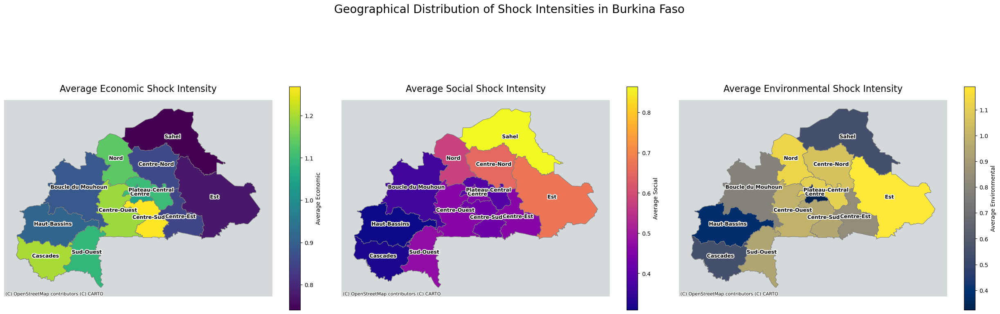

In [63]:
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as cx 
import pandas as pd 
import matplotlib.patheffects as pe 

fig, axs = plt.subplots(1, 3, figsize=(25, 9), sharey=True) # Slightly larger figure for better detail

shock_types = ['shock_economic', 'shock_social', 'shock_environmental']
titles = ['Average Economic Shock Intensity', 'Average Social Shock Intensity', 'Average Environmental Shock Intensity']

cmaps = ['viridis', 'plasma', 'cividis'] 


for i, shock in enumerate(shock_types):
    # Compute average shock intensity by region
    # Ensure 'gdf' is accessible and 'NAME_1' is clean
    avg_shock = gdf.dropna(subset=['NAME_1']).groupby('NAME_1')[shock].mean().reset_index()

    # Merge with region_shp (ensure 'NAME_1' column exists in both and has consistent values)
    map_shock = region_shp.merge(avg_shock, on='NAME_1', how='left')

   
    # Plot the map
    # Add a distinct edge color and transparency for clarity
    map_shock.plot(
        column=shock,
        cmap=cmaps[i],
        linewidth=0.8,
        ax=axs[i],
        edgecolor='grey', # Slightly softer edge
        legend=True,
        legend_kwds={
            'label': f"Average {titles[i].split(' ')[1].replace('Intensity', 'Shock')}", # Cleaner label for legend
            'orientation': "vertical", # Vertical legend is often cleaner
            'shrink': 0.7 # Adjust legend size
        },
        missing_kwds={
            "color": "lightgrey",
            "edgecolor": "red",
            "hatch": "///",
            "label": "Missing values",
        }
    )

    cx.add_basemap(axs[i], source=cx.providers.CartoDB.PositronNoLabels) 

    axs[i].set_title(titles[i], fontsize=16, pad=15) 
    axs[i].axis('off') 

    # Add region labels with corrected styling using patheffects.withStroke
    for idx, row in map_shock.iterrows():
        if row['geometry'] is not None: # Ensure geometry exists
            if row['geometry'].geom_type == 'MultiPolygon':
                centroid = row['geometry'].representative_point()
            else:
                centroid = row['geometry'].centroid

            # Use patheffects.withStroke for a clean outline effect
            axs[i].annotate(row['NAME_1'], xy=(centroid.x, centroid.y),
                             horizontalalignment='center',
                             fontsize=9,
                             fontweight='bold',
                             color='black',
                             path_effects=[pe.withStroke(linewidth=3, foreground="white")] 
                            )
plt.suptitle('Geographical Distribution of Shock Intensities in Burkina Faso', fontsize=20, y=0.98)

plt.tight_layout(rect=[0, 0, 1, 0.95]) 
plt.show()

In [65]:
master_data

,year_x,country,hhid,cluster,household_number,wave,household_weight_x,shock_respondent,shock_type,shock_occurred_last3y,...,wastewater_disposal_method,wastewater_disposal_other,child_feces_disposal_last_time,child_feces_disposal_other,handwashing_place_observed,soap_or_cleaning_present,main_handwashing_times,children_exposed_economic,children_exposed_social,children_exposed_environmental
0,2021,Burkina Faso,586005,586,5,2,439,2,Taux élevé de maladies des animaux,0.0,...,Egout,NaN,Les selles ont été mises/ jetées à l'air libre,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger,0,0,0
1,2021,Burkina Faso,586028,586,28,2,439,1,Prix élevés des intrants agricoles,0.0,...,Egout,NaN,Les selles ont été mises ou jetées dans les to...,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger,0,0,0
2,2021,Burkina Faso,586043,586,43,2,439,2,Taux élevé de maladies des animaux,1.0,...,Dans la rue/nature,NaN,Les selles ont été jetées dans les ordures,NaN,"Observé, non fixe","Eau, uniquement",A la sortie des toilettes,0,0,0
3,2021,Burkina Faso,586044,586,44,2,439,1,Maladie grave ou accident d'un membre du ménage,0.0,...,Dans la rue/nature,NaN,Les selles ont été jetées dans les ordures,NaN,"Observé, non fixe","Eau, uniquement",Avant de manger,5,0,5
4,2021,Burkina Faso,586052,586,52,2,439,1,Glissement de terrain,0.0,...,Dans la rue/nature,NaN,NaN,NaN,"Observé, non fixe","Eau, uniquement",A la sortie des toilettes,5,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,2021,Burkina Faso,1185033,1185,33,1,821,1,Glissement de terrain,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7172,2021,Burkina Faso,1185034,1185,34,1,821,3,Taux élevé de maladies des cultures,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7173,2021,Burkina Faso,1185035,1185,35,1,821,2,Conflit armé/Violence/Insécurité,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
7174,2021,Burkina Faso,1185047,1185,47,1,821,1,"Vol d'argent, de biens, de récolte ou de bétail",0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0


In [69]:
master_data["asset_index"].value_counts()

asset_index
0.0    7176
Name: count, dtype: int64

In [68]:
from sklearn.preprocessing import MinMaxScaler

try:
    master_data = pd.read_csv("bfa_merged_geo_shock_roster_welfare_housing.csv")
    print("master_data loaded successfully.")
except FileNotFoundError:
    print("Error: 'bfa_merged_geo_shock_roster_welfare_housing.csv' not found. Exiting.")
    exit()

# --- Data Preparation and Index Calculation ---

# Define pillar variable groups
exposure_vars = ['shock_economic', 'shock_social', 'shock_environmental']
vulnerability_vars = ['num_children', 'num_adolescents', 'head_gender', 'num_rooms']
capacity_vars = ['asset_index', 'connected_to_electricity', 'connected_to_water_network',
                 'main_drinking_water_source', 'toilet_type', 'treats_drinking_water']

# To Convert 'head_gender' to numerical if present (0 for male, 1 for female)
if 'head_gender' in master_data.columns:
    master_data.loc[:, 'head_gender'] = master_data['head_gender'].apply(
        lambda x: 1 if str(x).lower() == 'female' else (0 if str(x).lower() == 'male' else x)
    )
    master_data.loc[:, 'head_gender'] = pd.to_numeric(master_data['head_gender'], errors='coerce')

# Fill NA values with 0 for all variables used in index calculations
all_index_vars = exposure_vars + vulnerability_vars + capacity_vars
for col in all_index_vars:
    if col in master_data.columns:
        master_data.loc[:, col] = pd.to_numeric(master_data[col], errors='coerce').fillna(0)
    else:
        print(f"Warning: Column '{col}' not found. Initializing with zeros.")
        master_data.loc[:, col] = 0.0

scaler = MinMaxScaler()

# Calculate 'exposure_index'
master_data['exposure_index'] = 0.0
if all(col in master_data.columns for col in exposure_vars) and not master_data[exposure_vars].empty:
    master_data['exposure_index'] = scaler.fit_transform(master_data[exposure_vars]).mean(axis=1)
    print("exposure_index calculated.")

# Calculate 'vulnerability_index'
master_data['vulnerability_index'] = 0.0
if all(col in master_data.columns for col in vulnerability_vars) and not master_data[vulnerability_vars].empty:
    master_data['vulnerability_index'] = scaler.fit_transform(master_data[vulnerability_vars]).mean(axis=1)
    print("vulnerability_index calculated.")

# Calculate 'capacity_index'

master_data['capacity_index'] = 0.0
if all(col in master_data.columns for col in capacity_vars) and not master_data[capacity_vars].empty:
    master_data['capacity_index'] = 1 - scaler.fit_transform(master_data[capacity_vars]).mean(axis=1)
    print("capacity_index calculated.")

# Calculate 'ccri_index' as average of the three pillar indices
pillar_indices = ['exposure_index', 'vulnerability_index', 'capacity_index']
for p_idx_col in pillar_indices:
    master_data.loc[:, p_idx_col] = pd.to_numeric(master_data[p_idx_col], errors='coerce')

master_data['ccri_index'] = 0.0
if all(col in master_data.columns for col in pillar_indices) and not master_data[pillar_indices].empty:
    master_data['ccri_index'] = master_data[pillar_indices].mean(axis=1)
    print("ccri_index calculated.")

# --- Display Results ---
print("\n--- New Index Columns Added ---")
print("First 5 rows with new indices:")
print(master_data[['exposure_index', 'vulnerability_index', 'capacity_index', 'ccri_index']].head().to_markdown(index=False, numalign="left", stralign="left"))

print("\nDescriptive statistics for new indices:")
print(master_data[['exposure_index', 'vulnerability_index', 'capacity_index', 'ccri_index']].describe().to_markdown(numalign="left", stralign="left"))

master_data loaded successfully.
exposure_index calculated.
vulnerability_index calculated.
capacity_index calculated.
ccri_index calculated.

--- New Index Columns Added ---
First 5 rows with new indices:
| exposure_index   | vulnerability_index   | capacity_index   | ccri_index   |
|:-----------------|:----------------------|:-----------------|:-------------|
| 0.0666667        | 0.0384615             | 1                | 0.368376     |
| 0.114286         | 0.173077              | 1                | 0.429121     |
| 0.114286         | 0.0192308             | 1                | 0.377839     |
| 0.114286         | 0.17182               | 1                | 0.428702     |
| 0.114286         | 0.17182               | 1                | 0.428702     |

Descriptive statistics for new indices:
|       | exposure_index   | vulnerability_index   | capacity_index   | ccri_index   |
|:------|:-----------------|:----------------------|:-----------------|:-------------|
| count | 7176            

/var/folders/6s/941yxkvd7_vchrqbh62fdjph0000gn/T/ipykernel_50865/318803115.py:6: DtypeWarning: Columns (109,193,198,230,239,247,281,310,312) have mixed types. Specify dtype option on import or set low_memory=False.
  master_data = pd.read_csv("bfa_merged_geo_shock_roster_welfare_housing.csv")


In [214]:
master_data['head_gender'].value_counts(dropna=False)
master_data['hgender'].value_counts(dropna=False)


hgender
Masculin    6101
Féminin     1075
Name: count, dtype: int64

In [215]:
# Create binary indicator: 1 = female head, 0 = male
master_data['head_gender_female'] = (master_data['hgender'].str.lower() == 'féminin').astype(int)


In [216]:
[col for col in master_data.columns if 'asset' in col.lower() or 'water' in col.lower()]


['shock_effect_assets',
 'coping_sell_agri_assets',
 'has_water_heater',
 'connected_to_water_network',
 'water_included_in_rent',
 'last_water_bill_amount',
 'last_water_bill_frequency',
 'buys_water_from_others',
 'water_spending_last_30days',
 'main_drinking_water_source_dry_season',
 'main_drinking_water_source_dry_season_other',
 'main_drinking_water_source_rainy_season',
 'main_drinking_water_source_rainy_season_other',
 'satisfied_with_drinking_water',
 'distance_to_water_source_dry_season',
 'travel_time_to_water_source_dry_season',
 'distance_to_water_source_rainy_season',
 'travel_time_to_water_source_rainy_season',
 'treats_drinking_water',
 'treat_water_boil',
 'treat_water_bleach_chlorine',
 'treat_water_cloth_filter',
 'treat_water_physical_filter',
 'treat_water_solar_disinfection',
 'treat_water_settle',
 'treat_water_other',
 'treat_water_other_specify',
 'wastewater_disposal_method',
 'wastewater_disposal_other']

In [113]:
ee.Initialize(project='ee-sanohyusuf2015')


In [116]:
import ee
ee.Initialize(project='ee-sanohyusuf2015')

# Correct: Use ImageCollection, then call .first()
collection = ee.ImageCollection("LANDSAT/LC09/C02/T1_L2") \
    .filterDate("2022-01-01", "2022-12-31") \
    .filterBounds(ee.Geometry.Point([-1.6, 13.1]))  # Optional: use any point in Burkina

first_image = collection.first()
print(first_image.getInfo())


{'type': 'Image', 'bands': [{'id': 'SR_B1', 'data_type': {'type': 'PixelType', 'precision': 'int', 'min': 0, 'max': 65535}, 'dimensions': [7561, 7721], 'crs': 'EPSG:32630', 'crs_transform': [30, 0, 546885, 0, -30, 1554315]}, {'id': 'SR_B2', 'data_type': {'type': 'PixelType', 'precision': 'int', 'min': 0, 'max': 65535}, 'dimensions': [7561, 7721], 'crs': 'EPSG:32630', 'crs_transform': [30, 0, 546885, 0, -30, 1554315]}, {'id': 'SR_B3', 'data_type': {'type': 'PixelType', 'precision': 'int', 'min': 0, 'max': 65535}, 'dimensions': [7561, 7721], 'crs': 'EPSG:32630', 'crs_transform': [30, 0, 546885, 0, -30, 1554315]}, {'id': 'SR_B4', 'data_type': {'type': 'PixelType', 'precision': 'int', 'min': 0, 'max': 65535}, 'dimensions': [7561, 7721], 'crs': 'EPSG:32630', 'crs_transform': [30, 0, 546885, 0, -30, 1554315]}, {'id': 'SR_B5', 'data_type': {'type': 'PixelType', 'precision': 'int', 'min': 0, 'max': 65535}, 'dimensions': [7561, 7721], 'crs': 'EPSG:32630', 'crs_transform': [30, 0, 546885, 0, -30

In [131]:
# Export Earth Engine FeatureCollection to Google Drive
task = ee.batch.Export.table.toDrive(
    collection=extracted,
    description='BFA_Satellite_Extraction',
    folder='GEE_Exports',
    fileNamePrefix='BFA_satellite_data',
    fileFormat='CSV'
)

task.start()
print("Export started! Check your Google Drive > GEE_Exports folder in a few minutes.")


Export started! Check your Google Drive > GEE_Exports folder in a few minutes.


In [122]:
df_sat = pd.read_csv("BFA_satellite_data.csv")
df_sat

,system:index,NDBI,NDVI,Nightlight,QA_PIXEL,QA_RADSAT,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,SR_QA_AEROSOL,ST_ATRAN,ST_B10,ST_CDIST,ST_DRAD,ST_EMIS,ST_EMSD,ST_QA,ST_TRAD,ST_URAD,cluster,hhid,.geo
0,0,0.042908,0.128052,0.642083,2.1824,0,0.87090,0.96175,1.18995,1.37825,1.78335,1.90840,1.74360,0.0209,0.68815,4.69990,0.05345,0.11935,0.9608,0.0058,0.0251,0.99365,0.24480,586,586005,"{""type"":""Point"",""coordinates"":[-4.163,13.124]}"
1,1,0.081577,0.116387,0.409167,2.1824,0,0.90555,0.99295,1.24150,1.50745,1.93065,2.23765,1.98550,0.0224,0.68800,4.74495,0.05450,0.11935,0.9518,0.0085,0.0255,0.99700,0.24485,586,586028,"{""type"":""Point"",""coordinates"":[-4.165,13.126]}"
2,2,0.061508,0.115398,0.456250,2.1824,0,0.95410,1.02725,1.25730,1.52825,1.96070,2.27155,1.99520,0.0160,0.68780,4.77165,0.05415,0.11945,0.9490,0.0073,0.0253,1.00295,0.24510,586,586043,"{""type"":""Point"",""coordinates"":[-4.167,13.12200..."
3,3,0.081070,0.112883,0.456250,2.1824,0,0.97245,1.04480,1.28355,1.60385,2.03060,2.36665,2.10380,0.0160,0.68775,4.77785,0.05445,0.11945,0.9490,0.0073,0.0253,1.00995,0.24515,586,586044,"{""type"":""Point"",""coordinates"":[-4.168000000000..."
4,4,0.051999,0.112032,0.642083,2.1824,0,0.95950,1.03655,1.24885,1.43295,1.89795,2.03465,1.84165,0.0160,0.68840,4.73415,0.05455,0.11920,0.9497,0.0058,0.0250,0.98965,0.24450,586,586052,"{""type"":""Point"",""coordinates"":[-4.164000000000..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7171,7171,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185033,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7172,7172,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185034,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7173,7173,0.061838,0.122695,0.292083,2.1824,0,0.99280,1.12260,1.38910,1.65720,2.09180,2.39560,1.96200,0.0224,0.74830,4.66510,0.09990,0.09985,0.9753,0.0082,0.0204,0.99985,0.20390,1185,1185035,"{""type"":""Point"",""coordinates"":[-0.230999999999..."
7174,7174,0.063967,0.117736,0.306667,2.1824,0,1.01210,1.12190,1.37900,1.66170,2.08600,2.34300,1.98430,0.0160,0.74825,4.65620,0.10100,0.09985,0.9762,0.0081,0.0204,0.99360,0.20400,1185,1185047,"{""type"":""Point"",""coordinates"":[-0.232,12.951]}"


array([[<Axes: title={'center': 'ndvi'}>,
        <Axes: title={'center': 'ndbi'}>],
       [<Axes: title={'center': 'nightlight'}>, <Axes: >]], dtype=object)

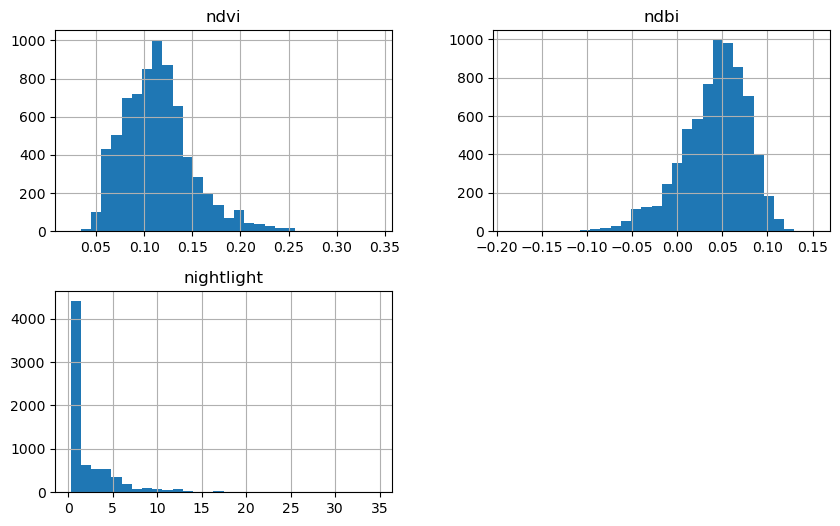

In [134]:
# Normalize columns to lowercase
df_sat.columns = df_sat.columns.str.lower()

# Now safely plot
df_sat[['ndvi', 'ndbi', 'nightlight']].hist(bins=30, figsize=(10, 6))


In [140]:
# Convert qa_pixel from float to int (by scaling ×100 or ×1000)
df_sat['qa_pixel_int'] = df_sat['qa_pixel'].multiply(100).round().astype('Int64')

# Step 2: Check frequency
print(df_sat['qa_pixel_int'].value_counts(dropna=False).head(10))


qa_pixel_int
218     6893
221      142
223      116
231        7
220        6
219        5
239        5
222        1
232        1
<NA>       0
Name: count, dtype: Int64


In [139]:
df_sat['qa_pixel'].value_counts(dropna=False).head(10)

qa_pixel
2.1824    6893
2.2052     136
2.2280     116
2.3084       7
2.2080       5
2.1921       5
2.3888       5
2.2018       5
2.2180       1
2.2149       1
Name: count, dtype: int64

In [128]:
# Ensure consistent column casing
df_sat.columns = df_sat.columns.str.strip().str.lower()

# Fill NaNs in 'latitude' and 'longitude' with their respective means
df_sat['latitude'] = df_sat['latitude'].fillna(df_sat['latitude'].mean())
df_sat['longitude'] = df_sat['longitude'].fillna(df_sat['longitude'].mean())


In [129]:
import ee
ee.Initialize(project='ee-sanohyusuf2015')  # Assuming project is properly authorized

# Create a list of ee.Features
features = [
    ee.Feature(
        ee.Geometry.Point([row['longitude'], row['latitude']]),
        {
            'cluster': row['cluster'],
            'hhid': row['hhid']
        }
    )
    for _, row in df_sat.iterrows()
]

# Convert to ee.FeatureCollection
fc = ee.FeatureCollection(features)


In [130]:
import ee
import pandas as pd
import datetime

# Initialize Earth Engine
ee.Initialize(project='ee-sanohyusuf2015')

# --- Load satellite GPS points and fill NaNs ---
df_sat.columns = df_sat.columns.str.strip().str.lower()
df_sat['latitude'] = df_sat['latitude'].fillna(df_sat['latitude'].mean())
df_sat['longitude'] = df_sat['longitude'].fillna(df_sat['longitude'].mean())

# --- Convert to FeatureCollection ---
features = [
    ee.Feature(ee.Geometry.Point([row['longitude'], row['latitude']]), {
        'hhid': str(row['hhid']),
        'cluster': str(row['cluster'])
    }) for _, row in df_sat.iterrows()
]
fc_points = ee.FeatureCollection(features)

# --- Time settings ---
year = 2021
months = list(range(1, 13))

# --- Function to extract monthly mean for each layer ---
def extract_monthly_climate(month, year=2021):
    start_date = datetime.date(year, month, 1)
    end_date = datetime.date(year, month % 12 + 1, 1) if month < 12 else datetime.date(year+1, 1, 1)
    
    # CHIRPS Rainfall (mm/day)
    chirps = ee.ImageCollection("UCSB-CHG/CHIRPS/DAILY") \
        .filterDate(str(start_date), str(end_date)) \
        .mean().rename('rainfall')

    # MODIS LST (Kelvin) — scaled by 0.02 and converted to Celsius
    lst = ee.ImageCollection('MODIS/061/MOD11A2') \
        .filterDate(str(start_date), str(end_date)) \
        .select('LST_Day_1km') \
        .mean().multiply(0.02).subtract(273.15).rename('temperature')

    # Landsat 9 NDVI (normalized vegetation)
    ndvi = ee.ImageCollection('LANDSAT/LC09/C02/T1_L2') \
        .filterDate(str(start_date), str(end_date)) \
        .map(lambda img: img.normalizedDifference(['SR_B5', 'SR_B4']).rename('NDVI')) \
        .mean()
    
    # Combine bands
    composite = chirps.addBands([lst, ndvi])

    # Reduce over GPS points
    reduced = composite.reduceRegions(
        collection=fc_points,
        reducer=ee.Reducer.mean(),
        scale=500,
    )

    # Export
    task = ee.batch.Export.table.toDrive(
        collection=reduced,
        description=f'BFA_Climate_M{month}_Y{year}',
        folder='GEE_Exports',
        fileNamePrefix=f'climate_bfa_{year}_{month:02d}',
        fileFormat='CSV'
    )
    task.start()
    print(f"Export started for Month {month:02d} ({year}) — check Google Drive > GEE_Exports.")

# --- Loop through all months in 2021 ---
for m in months:
    extract_monthly_climate(month=m, year=year)


Export started for Month 01 (2021) — check Google Drive > GEE_Exports.
Export started for Month 02 (2021) — check Google Drive > GEE_Exports.
Export started for Month 03 (2021) — check Google Drive > GEE_Exports.
Export started for Month 04 (2021) — check Google Drive > GEE_Exports.
Export started for Month 05 (2021) — check Google Drive > GEE_Exports.
Export started for Month 06 (2021) — check Google Drive > GEE_Exports.
Export started for Month 07 (2021) — check Google Drive > GEE_Exports.
Export started for Month 08 (2021) — check Google Drive > GEE_Exports.
Export started for Month 09 (2021) — check Google Drive > GEE_Exports.
Export started for Month 10 (2021) — check Google Drive > GEE_Exports.
Export started for Month 11 (2021) — check Google Drive > GEE_Exports.
Export started for Month 12 (2021) — check Google Drive > GEE_Exports.


In [137]:
df_sat.columns


Index(['system:index', 'ndbi', 'ndvi', 'nightlight', 'qa_pixel', 'qa_radsat',
       'sr_b1', 'sr_b2', 'sr_b3', 'sr_b4', 'sr_b5', 'sr_b6', 'sr_b7',
       'sr_qa_aerosol', 'st_atran', 'st_b10', 'st_cdist', 'st_drad', 'st_emis',
       'st_emsd', 'st_qa', 'st_trad', 'st_urad', 'cluster', 'hhid', '.geo',
       'longitude', 'latitude'],
      dtype='object')

In [186]:
merged_data

,year,country,cluster,hhid,wave,household_number,respondent_id,respondent_id.1,household_weight,shock_respondent,shock_type,shock_occurred_last3y,shock_economic,shock_social,shock_environmental,shock_mean,shock_total,shock_month,shock_year,shock_effect_income,shock_effect_assets,shock_effect_agri_prod,shock_effect_livestock,shock_effect_food_stock,shock_effect_food_purchase,coping_savings,coping_family_help,coping_govt_help,coping_ngo_help,coping_marry_daughters,coping_change_consumption,coping_buy_cheaper_food,coping_extra_jobs_active,coping_unemployed_work,coping_children_work,coping_children_out_school,coping_migration,coping_reduce_health_edu,coping_credit,coping_sell_agri_assets,coping_sell_durables,coping_sell_property,coping_lease_land,coping_sell_food_stock,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,coping_other_specifies,unnamed: 0,region,prefecture_arrondissement,commune,residence_type,village_quartier,household_type,recent_mover,migration_reason,interviewed_2018_2019,interviewed_2018_other,interview_visits_required,interview_date_1_start,interview_date_2_start,interview_date_3_start,interview_date_1_end,interview_date_2_end,interview_date_3_end,interview_result,questionnaire_result,interview_language,gps_latitude,gps_longitude,survey_duration_days,gps_valid,geometry,member_id,sex,relationship_to_head,birth_day,birth_month,birth_year,age_last_birthday,has_birth_certificate,birth_certificate_shown,respondent_section,marital_status,spouse_lives_in_household,spouse_id_1,spouse_id_2,spouse_id_3,spouse_id_4,spouse_id_5,spouse_id_6,spouse_id_7,spouse_id_8,age_first_marriage,present_at_survey,resident_6_months,intend_stay_6_months,religion,nationality,ethnicity,born_in_locality,lived_elsewhere_6_months,last_locality_before_here,last_locality_other,years_in_last_locality,main_reason_move_here,other_reason_move,years_in_current_locality,father_in_household,father_name,father_alive,father_education_level,father_industry,father_occupation,father_institutional_sector,mother_in_household,mother_name,mother_alive,mother_education_level,mother_industry,mother_occupation,mother_institutional_sector,has_mobile_phone,used_phone_last_7_days,prepaid_card_expenditure_7_days,internet_access_phone,internet_access_office,internet_access_cybercafe,internet_access_home,internet_access_school,still_member_of_household,num_members,num_females,num_children,num_adolescents,zae,milieu,household_weight_x.1,hhsize,eqadu1,eqadu2,hgender,hage,hmstat,hreligion,hnation,hethnie,halfa,halfa2,heduc,hdiploma,hhandig,hactiv7j,hactiv12m,hbranch,hsectins,hcsp,dali,dnal,dtot,dtet,pcexp,zref,def_spa,def_temp,zaemil,dif,p0,p1,p2,pauv,quintiles,deciles,respondent_id_s11,household_weight_y.1,housing_type,num_rooms,has_air_conditioner,has_water_heater,has_ceiling_fan,occupancy_status,occupancy_status_other,estimated_rent_similar,monthly_rent,rent_paid_by_nonmember,who_pays_rent,who_pays_rent_other,monthly_rent_paid_by_third_party,hh_member_on_property_title,property_title_member_1,property_title_member_2,property_title_member_3,property_title_member_4,property_title_member_5,property_title_member_6,property_title_member_7,property_title_member_8,property_title_member_9,property_title_member_19,property_title_member_20,property_title_member_21,property_title_member_22,property_title_member_23,nonmember_on_property_title,nonmember_title_person,nonmember_title_person_other,reason_no_property_title,reason_no_property_title_other,document_proving_property_rights,document_proving_property_rights_other,paid_housing_loan_last_12mo,monthly_loan_payment,business_inside_dwelling,main_wall_material,main_wall_material_other,main_roof_material,main_roof_material_other,main_floor_material,main_floor_material_other,connected_to_water_network,water_included_in_rent,last_water_bill_amount,last_water_bill_frequency,buys_water_from_others,water_spending_last_30days,main_dri

In [188]:
gdf

,id,geometry
0,1,POINT (-4.163 13.124)
1,2,POINT (-5 10)
3,4,"LINESTRING (0 0, 1 1)"


In [189]:
map_df

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444


In [192]:
merged_data.columns


Index(['year', 'country', 'cluster', 'hhid', 'wave', 'household_number',
       'respondent_id', 'respondent_id.1', 'household_weight',
       'shock_respondent',
       ...
       'SR_QA_AEROSOL', 'ST_ATRAN', 'ST_B10', 'ST_CDIST', 'ST_DRAD', 'ST_EMIS',
       'ST_EMSD', 'ST_QA', 'ST_TRAD', 'ST_URAD'],
      dtype='object', length=518)

In [196]:
# Compute average shock exposure by region using the 'region' column
avg_shocks = (
    merged_data.groupby("region")[['shock_economic', 'shock_social', 'shock_environmental']]
    .mean()
    .reset_index()
)


In [203]:
map_df

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,region,shock_economic,shock_social,shock_environmental
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,NaN,NaN,NaN,NaN
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,NaN,NaN,NaN,NaN
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,NaN,NaN,NaN,NaN
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,NaN,NaN,NaN,NaN
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,NaN,NaN,NaN,NaN
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,NaN,NaN,NaN,NaN
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,NaN,NaN,NaN,NaN
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,NaN,NaN,NaN,NaN
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,NaN,NaN,NaN,NaN
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444,NaN,NaN,NaN,NaN


In [198]:
avg_shocks

,region,shock_economic,shock_social,shock_environmental
0,boucle du mouhoum,0.885000,0.365000,0.790000
1,cascades,1.211111,0.340741,0.559259
2,centre,1.060991,0.453621,0.324015
3,centre-est,0.864198,0.445988,0.827160
4,centre-nord,0.860465,0.655039,1.060078
5,centre-ouest,1.185764,0.453125,0.975694
6,centre-sud,1.268750,0.425000,0.947917
7,est,0.756487,0.672655,1.161677
8,hauts-bassins,0.909836,0.310109,0.385246
9,nord,1.134066,0.580220,1.131868


In [200]:
# Merge 'region' from avg_shocks and 'NAME_1' from map_df
map_df = map_df.merge(avg_shocks, left_on='NAME_1', right_on='region', how='left')


In [201]:
map_df

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,region,shock_economic,shock_social,shock_environmental
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,NaN,NaN,NaN,NaN
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,NaN,NaN,NaN,NaN
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,NaN,NaN,NaN,NaN
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,NaN,NaN,NaN,NaN
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,NaN,NaN,NaN,NaN
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,NaN,NaN,NaN,NaN
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,NaN,NaN,NaN,NaN
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,NaN,NaN,NaN,NaN
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,NaN,NaN,NaN,NaN
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444,NaN,NaN,NaN,NaN


In [202]:
map_df

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,region,shock_economic,shock_social,shock_environmental
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,NaN,NaN,NaN,NaN
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,NaN,NaN,NaN,NaN
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,NaN,NaN,NaN,NaN
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,NaN,NaN,NaN,NaN
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,NaN,NaN,NaN,NaN
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,NaN,NaN,NaN,NaN
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,NaN,NaN,NaN,NaN
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,NaN,NaN,NaN,NaN
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,NaN,NaN,NaN,NaN
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444,NaN,NaN,NaN,NaN


In [204]:
print("From map_df (shapefile):")
print(sorted(map_df['NAME_1'].dropna().unique()))

print("\nFrom avg_shocks (hh data):")
print(sorted(avg_shocks['region'].dropna().unique()))


From map_df (shapefile):
['Boucle du Mouhoun', 'Cascades', 'Centre', 'Centre-Est', 'Centre-Nord', 'Centre-Ouest', 'Centre-Sud', 'Est', 'Haut-Bassins', 'Nord', 'Plateau-Central', 'Sahel', 'Sud-Ouest']

From avg_shocks (hh data):
['boucle du mouhoum', 'cascades', 'centre', 'centre-est', 'centre-nord', 'centre-ouest', 'centre-sud', 'est', 'hauts-bassins', 'nord', 'plateau-central', 'sahel', 'sud-ouest']


In [206]:
# Clean both sides
map_df['NAME_1_clean'] = map_df['NAME_1'].str.strip().str.lower()

# Manual corrections for avg_shocks regions
region_fix_map = {
    'boucle du mouhoum': 'boucle du mouhoun',
    'hauts-bassins': 'haut-bassins'
}

avg_shocks['region_clean'] = (
    avg_shocks['region']
    .str.strip()
    .str.lower()
    .replace(region_fix_map)
)

# Merge using cleaned region names
map_df = map_df.merge(
    avg_shocks,
    left_on='NAME_1_clean',
    right_on='region_clean',
    how='left'
)


In [207]:
map_df

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,region_x,shock_economic_x,shock_social_x,shock_environmental_x,NAME_1_clean,region_y,shock_economic_y,shock_social_y,shock_environmental_y,region_clean
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,NaN,0.0,0.0,0.0,boucle du mouhoun,boucle du mouhoum,0.885000,0.365000,0.790000,boucle du mouhoun
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,NaN,0.0,0.0,0.0,cascades,cascades,1.211111,0.340741,0.559259,cascades
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,NaN,0.0,0.0,0.0,centre,centre,1.060991,0.453621,0.324015,centre
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,NaN,0.0,0.0,0.0,centre-est,centre-est,0.864198,0.445988,0.827160,centre-est
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,NaN,0.0,0.0,0.0,centre-nord,centre-nord,0.860465,0.655039,1.060078,centre-nord
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,NaN,0.0,0.0,0.0,centre-ouest,centre-ouest,1.185764,0.453125,0.975694,centre-ouest
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,NaN,0.0,0.0,0.0,centre-sud,centre-sud,1.268750,0.425000,0.947917,centre-sud
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,NaN,0.0,0.0,0.0,est,est,0.756487,0.672655,1.161677,est
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,NaN,0.0,0.0,0.0,haut-bassins,hauts-bassins,0.909836,0.310109,0.385246,haut-bassins
9,BFA.10_1,BFA,Burkina Faso,Nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444,NaN,0.0,0.0,0.0,nord,nord,1.134066,0.580220,1.131868,nord


In [209]:
# Create a clean version of map_df with only relevant columns
map_df = map_df[[
    'GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1',
    'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1', 'geometry', 'ccri',
    'shock_economic_y', 'shock_social_y', 'shock_environmental_y', 'NAME_1_clean'
]]

# Rename shock columns (remove _y suffix)
map_df.rename(columns={
    'shock_economic_y': 'shock_economic',
    'shock_social_y': 'shock_social',
    'shock_environmental_y': 'shock_environmental'
}, inplace=True)


In [210]:
print(f"Number of rows in map_df: {len(map_df)}")
print(map_df[['NAME_1', 'shock_economic', 'shock_social', 'shock_environmental']].head())


Number of rows in map_df: 13
              NAME_1  shock_economic  shock_social  shock_environmental
0  Boucle du Mouhoun        0.885000      0.365000             0.790000
1           Cascades        1.211111      0.340741             0.559259
2             Centre        1.060991      0.453621             0.324015
3         Centre-Est        0.864198      0.445988             0.827160
4        Centre-Nord        0.860465      0.655039             1.060078


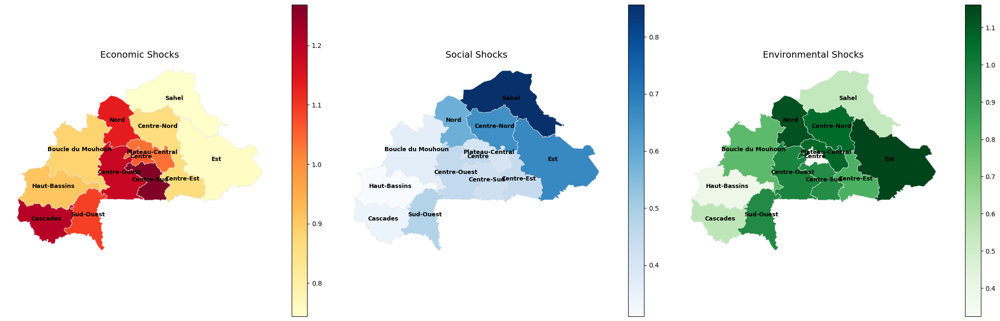

In [211]:
import matplotlib.pyplot as plt

# Create 3 subplots for the 3 shock types
fig, axs = plt.subplots(1, 3, figsize=(22, 7), sharey=True)

shock_types = ['shock_economic', 'shock_social', 'shock_environmental']
titles = ['Economic Shocks', 'Social Shocks', 'Environmental Shocks']
cmaps = ['YlOrRd', 'Blues', 'Greens']

for i, shock in enumerate(shock_types):
    map_df.plot(
        column=shock,
        cmap=cmaps[i],
        linewidth=0.6,
        ax=axs[i],
        edgecolor='0.9',
        legend=True
    )
    axs[i].set_title(titles[i], fontsize=14)
    axs[i].axis('off')

    # Annotate regions
    for idx, row in map_df.iterrows():
        centroid = (
            row['geometry'].representative_point()
            if row['geometry'].geom_type == 'MultiPolygon'
            else row['geometry'].centroid
        )
        axs[i].annotate(
            row['NAME_1'],
            xy=(centroid.x, centroid.y),
            horizontalalignment='center',
            fontsize=9,
            fontweight='bold',
            color='black'
        )

plt.tight_layout()
plt.show()


In [218]:
map_df_coping = map_df.merge(
    coping_by_region,
    left_on='NAME_1_clean',
    right_on='region_clean',
    how='left',
    suffixes=('', '_coping')
)

# Fill any missing coping values with 0
coping_cols = [col for col in coping_by_region.columns if col.startswith("coping_")]
map_df_coping[coping_cols] = map_df_coping[coping_cols].fillna(0)


In [219]:
map_df_coping

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,shock_economic,shock_social,shock_environmental,NAME_1_clean,region,coping_savings,coping_family_help,coping_govt_help,coping_ngo_help,coping_marry_daughters,coping_change_consumption,coping_buy_cheaper_food,coping_extra_jobs_active,coping_unemployed_work,coping_children_work,coping_children_out_school,coping_migration,coping_reduce_health_edu,coping_credit,coping_sell_agri_assets,coping_sell_durables,coping_sell_property,coping_lease_land,coping_sell_food_stock,coping_fishing,coping_sell_livestock,coping_send_children_away,coping_spiritual_activities,coping_offseason_farming,coping_other_strategy,coping_no_strategy,region_clean
0,BFA.1_1,BFA,Burkina Faso,Boucle du Mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,0.885000,0.365000,0.790000,boucle du mouhoun,boucle du mouhoum,0.030000,0.005000,0.000000,0.000000,0.0,0.000000,0.010000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.011667,0.0,0.0,0.000000,0.005000,0.0,0.008333,0.0,0.000000,0.000000,0.000000,0.016667,boucle du mouhoun
1,BFA.2_1,BFA,Burkina Faso,Cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,1.211111,0.340741,0.559259,cascades,cascades,0.033333,0.009259,0.000000,0.000000,0.0,0.000000,0.007407,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.001852,0.003704,0.0,0.0,0.000000,0.003704,0.0,0.007407,0.0,0.000000,0.000000,0.001852,0.016667,cascades
2,BFA.7_1,BFA,Burkina Faso,Centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,1.060991,0.453621,0.324015,centre,centre,0.016518,0.013977,0.000000,0.000000,0.0,0.002541,0.003812,0.003812,0.000000,0.0,0.0,0.000000,0.0,0.001271,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.017789,centre
3,BFA.3_1,BFA,Burkina Faso,Centre-Est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,0.864198,0.445988,0.827160,centre-est,centre-est,0.035494,0.012346,0.004630,0.000000,0.0,0.003086,0.003086,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.003086,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.003086,0.0,0.001543,0.000000,0.000000,0.021605,centre-est
4,BFA.4_1,BFA,Burkina Faso,Centre-Nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,0.860465,0.655039,1.060078,centre-nord,centre-nord,0.021318,0.011628,0.011628,0.011628,0.0,0.019380,0.013566,0.001938,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.001938,0.0,0.0,0.003876,0.000000,0.0,0.025194,0.0,0.005814,0.000000,0.001938,0.011628,centre-nord
5,BFA.5_1,BFA,Burkina Faso,Centre-Ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,1.185764,0.453125,0.975694,centre-ouest,centre-ouest,0.034722,0.029514,0.000000,0.000000,0.0,0.006944,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.001736,0.000000,0.0,0.0,0.000000,0.003472,0.0,0.010417,0.0,0.000000,0.001736,0.000000,0.013889,centre-ouest
6,BFA.6_1,BFA,Burkina Faso,Centre-Sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,1.268750,0.425000,0.947917,centre-sud,centre-sud,0.047917,0.004167,0.000000,0.000000,0.0,0.004167,0.006250,0.002083,0.000000,0.0,0.0,0.000000,0.0,0.004167,0.000000,0.0,0.0,0.000000,0.018750,0.0,0.014583,0.0,0.000000,0.000000,0.000000,0.025000,centre-sud
7,BFA.8_1,BFA,Burkina Faso,Est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,0.756487,0.672655,1.161677,est,est,0.015968,0.017964,0.003992,0.005988,0.0,0.011976,0.009980,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.003992,0.0,0.000000,0.000000,0.000000,0.015968,est
8,BFA.9_1,BFA,Burkina Faso,Haut-Bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,0.909836,0.310109,0.385246,haut-bassins,hauts-bassins,0.017760,0.

In [221]:
coping_cols = [col for col in map_df_coping.columns if col.startswith("coping_")]
titles = ['Coping: Credit', 'Coping: Child Labor', 'Coping: Sell Livestock']
cols = ['coping_credit', 'coping_children_work', 'coping_sell_livestock']


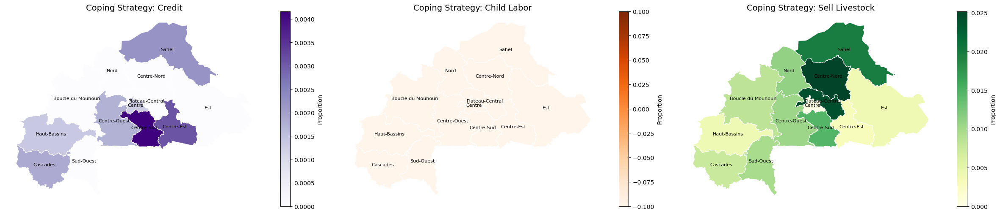

In [222]:
import matplotlib.pyplot as plt

# List of coping strategies to map
coping_cols_to_plot = [
    "coping_credit", 
    "coping_children_work", 
    "coping_sell_livestock"
]

# Titles and colormaps for each subplot
titles = [
    "Coping Strategy: Credit",
    "Coping Strategy: Child Labor",
    "Coping Strategy: Sell Livestock"
]
cmaps = ["Purples", "Oranges", "YlGn"]

# Set up subplots
fig, axs = plt.subplots(1, 3, figsize=(24, 8))

# Plot each coping strategy
for i, col in enumerate(coping_cols_to_plot):
    map_df_coping.plot(
        column=col,
        cmap=cmaps[i],
        linewidth=0.8,
        edgecolor="white",
        ax=axs[i],
        legend=True,
        legend_kwds={"label": "Proportion", "shrink": 0.6}
    )
    axs[i].set_title(titles[i], fontsize=14)
    axs[i].axis("off")

    # Add region labels
    for idx, row in map_df_coping.iterrows():
        centroid = (
            row["geometry"].representative_point()
            if row["geometry"].geom_type == "MultiPolygon"
            else row["geometry"].centroid
        )
        axs[i].annotate(
            row["NAME_1"],
            xy=(centroid.x, centroid.y),
            ha='center',
            fontsize=8,
            color="black"
        )

plt.tight_layout()
plt.show()


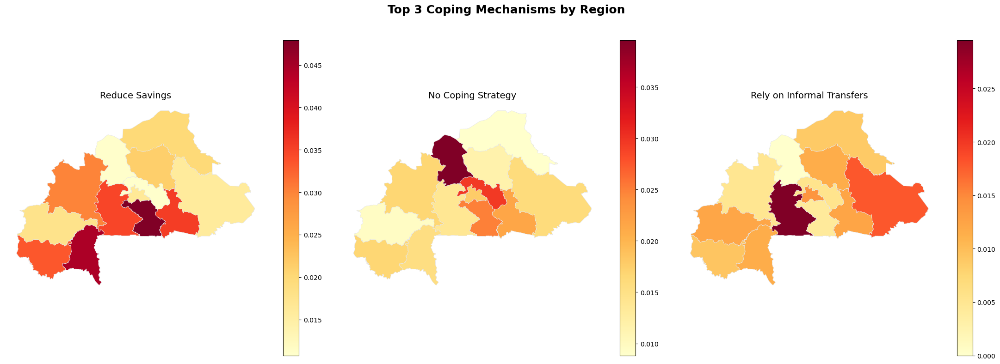

In [223]:
# Economically appropriate label mapping
coping_titles_map = {
    'coping_savings': 'Reduce Savings',
    'coping_no_strategy': 'No Coping Strategy',
    'coping_family_help': 'Rely on Informal Transfers',
    'coping_sell_livestock': 'Liquidate Productive Assets (Livestock)',
    'coping_buy_cheaper_food': 'Buy Cheaper Food',
    'coping_change_consumption': 'Reduce Current Consumption'
}

# Select top 3 strategy columns and labels
top3_coping_cols = list(coping_titles_map.keys())[:3]
top3_coping_titles = [coping_titles_map[col] for col in top3_coping_cols]

# Plotting
fig, axs = plt.subplots(1, 3, figsize=(22, 8))

for i, col in enumerate(top3_coping_cols):
    map_df_coping[[col, 'geometry']].plot(
        column=col,
        cmap='YlOrRd',
        legend=True,
        edgecolor='0.9',
        linewidth=0.6,
        ax=axs[i]
    )
    axs[i].set_title(top3_coping_titles[i], fontsize=14)
    axs[i].axis('off')

plt.suptitle("Top 3 Coping Mechanisms by Region", fontsize=18, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


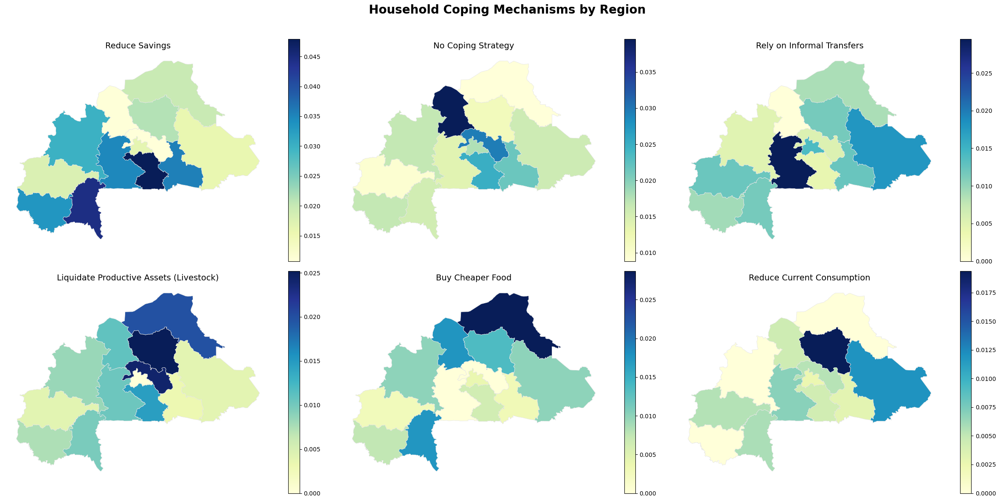

In [224]:
# Coping strategy labels (economically appropriate)
coping_titles_map = {
    'coping_savings': 'Reduce Savings',
    'coping_no_strategy': 'No Coping Strategy',
    'coping_family_help': 'Rely on Informal Transfers',
    'coping_sell_livestock': 'Liquidate Productive Assets (Livestock)',
    'coping_buy_cheaper_food': 'Buy Cheaper Food',
    'coping_change_consumption': 'Reduce Current Consumption'
}

# Extract columns and titles
coping_cols = list(coping_titles_map.keys())
coping_titles = [coping_titles_map[col] for col in coping_cols]

# Create 2x3 subplot grid
fig, axs = plt.subplots(2, 3, figsize=(24, 12))

# Plot each coping strategy
for i, col in enumerate(coping_cols):
    row, col_idx = divmod(i, 3)
    map_df_coping.plot(
        column=col,
        cmap='YlGnBu',
        linewidth=0.6,
        edgecolor='0.9',
        legend=True,
        ax=axs[row][col_idx]
    )
    axs[row][col_idx].set_title(coping_titles[i], fontsize=14)
    axs[row][col_idx].axis('off')

plt.suptitle("Household Coping Mechanisms by Region", fontsize=20, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


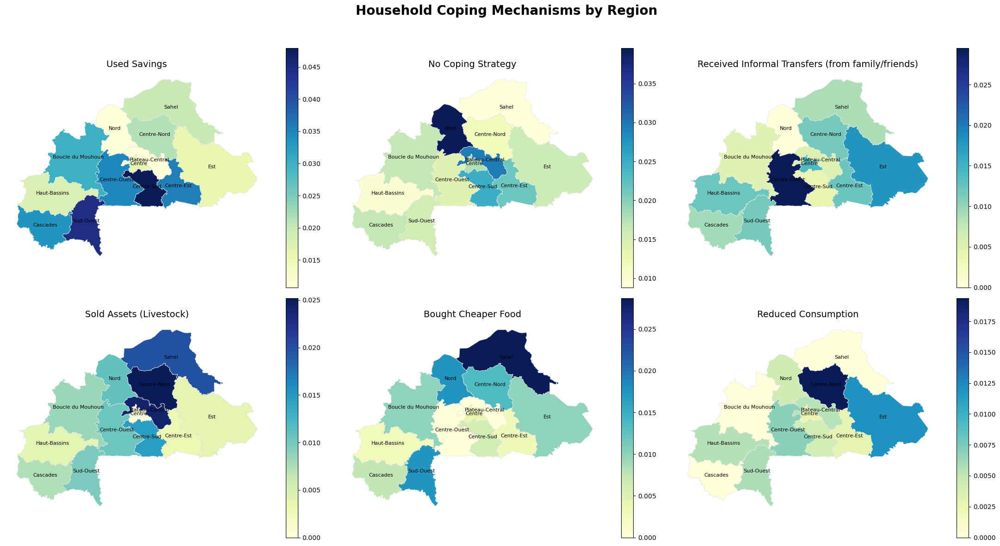

In [280]:
# label mapping
coping_titles_map = {
    'coping_savings': "Used Savings",
    'coping_no_strategy': 'No Coping Strategy',
    'coping_family_help': 'Received Informal Transfers (from family/friends)',
    'coping_sell_livestock': 'Sold Assets (Livestock)',
    'coping_buy_cheaper_food': 'Bought Cheaper Food',
    'coping_change_consumption': 'Reduced Consumption'
}

coping_cols = list(coping_titles_map.keys())
coping_titles = list(coping_titles_map.values())

# Plotting
fig, axs = plt.subplots(2, 3, figsize=(22, 12))

for i, col in enumerate(coping_cols):
    row_idx, col_idx = divmod(i, 3)
    ax = axs[row_idx][col_idx]

    # Plot coping strategy choropleth
    map_df_coping.plot(
        column=col,
        cmap='YlGnBu',
        linewidth=0.6,
        edgecolor='0.9',
        legend=True,
        ax=ax
    )

    # Add region name labels at centroids
    for _, row in map_df_coping.iterrows():
        if row['geometry'] is not None:
            centroid = row['geometry'].centroid
            ax.text(
                centroid.x,
                centroid.y,
                row['NAME_1'],
                fontsize=8,
                ha='center',
                color='black'
            )

    ax.set_title(coping_titles[i], fontsize=14)
    ax.axis('off')

# Final layout
plt.suptitle("Household Coping Mechanisms by Region", fontsize=20, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


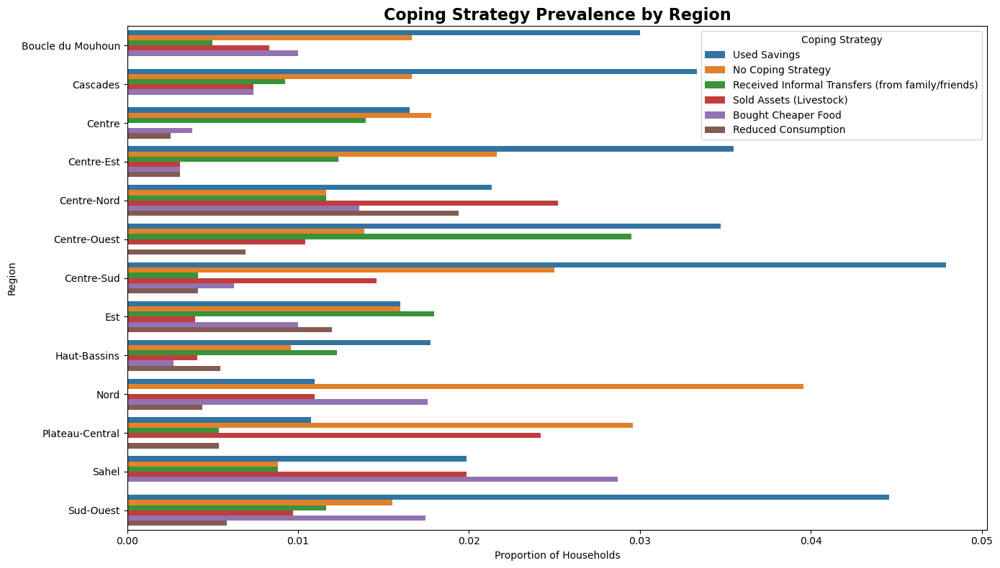

In [281]:
# Convert to long format
coping_long = map_df_coping.melt(
    id_vars='NAME_1', 
    value_vars=list(coping_titles_map.keys()), 
    var_name='Strategy', 
    value_name='Proportion'
)
coping_long['Strategy'] = coping_long['Strategy'].map(coping_titles_map)

# Barplot
plt.figure(figsize=(14, 8))
sns.barplot(data=coping_long, x='Proportion', y='NAME_1', hue='Strategy')
plt.title('Coping Strategy Prevalence by Region', fontsize=16, fontweight='bold')
plt.xlabel('Proportion of Households')
plt.ylabel('Region')
plt.legend(title='Coping Strategy')
plt.tight_layout()
plt.show()


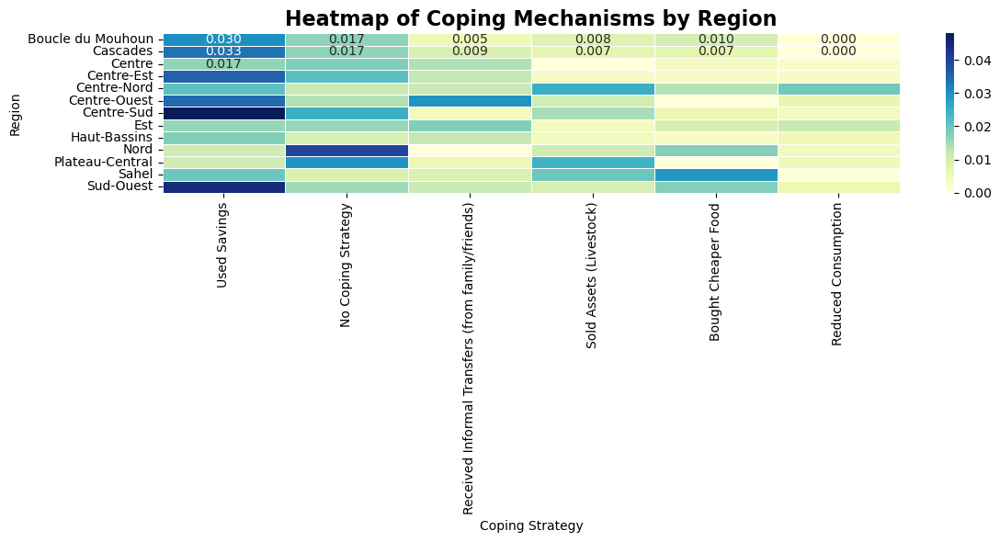

In [282]:
# Create heatmap to show the intensity of coping strategies
coping_heatmap_data = map_df_coping.set_index('NAME_1')[list(coping_titles_map.keys())]
coping_heatmap_data.rename(columns=coping_titles_map, inplace=True)

# Plot
plt.figure(figsize=(12, 6))
sns.heatmap(coping_heatmap_data, annot=True, cmap="YlGnBu", fmt=".3f", linewidths=0.5)
plt.title('Heatmap of Coping Mechanisms by Region', fontsize=16, fontweight='bold')
plt.xlabel('Coping Strategy')
plt.ylabel('Region')
plt.tight_layout()
plt.show()


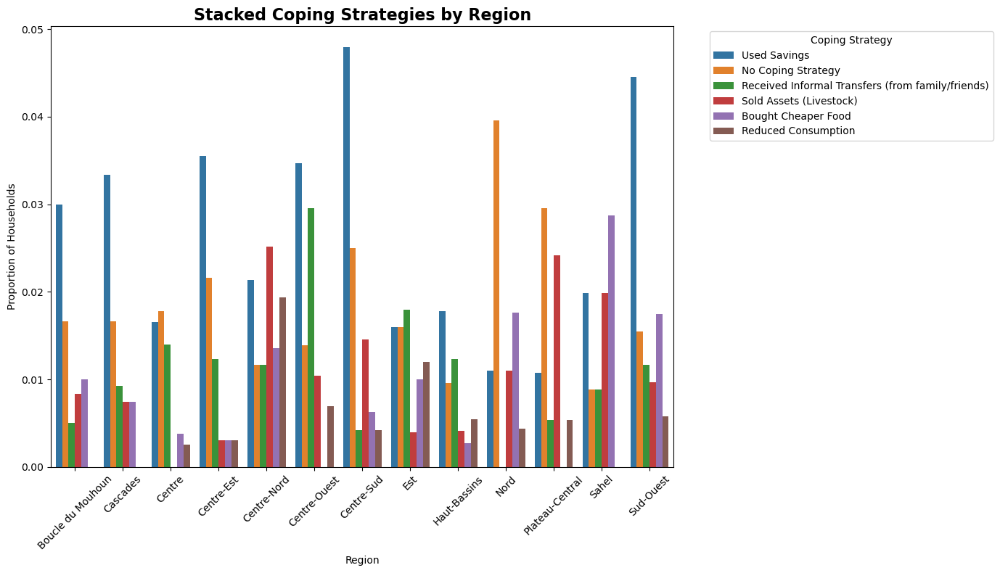

In [283]:
# Stacked bar chart by region
coping_long = map_df_coping.melt(
    id_vars='NAME_1',
    value_vars=list(coping_titles_map.keys()),
    var_name='Strategy',
    value_name='Proportion'
)
coping_long['Strategy'] = coping_long['Strategy'].map(coping_titles_map)

plt.figure(figsize=(14, 8))
sns.barplot(
    data=coping_long,
    x='NAME_1',
    y='Proportion',
    hue='Strategy'
)
plt.xticks(rotation=45)
plt.title('Stacked Coping Strategies by Region', fontsize=16, fontweight='bold')
plt.xlabel('Region')
plt.ylabel('Proportion of Households')
plt.legend(title='Coping Strategy', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


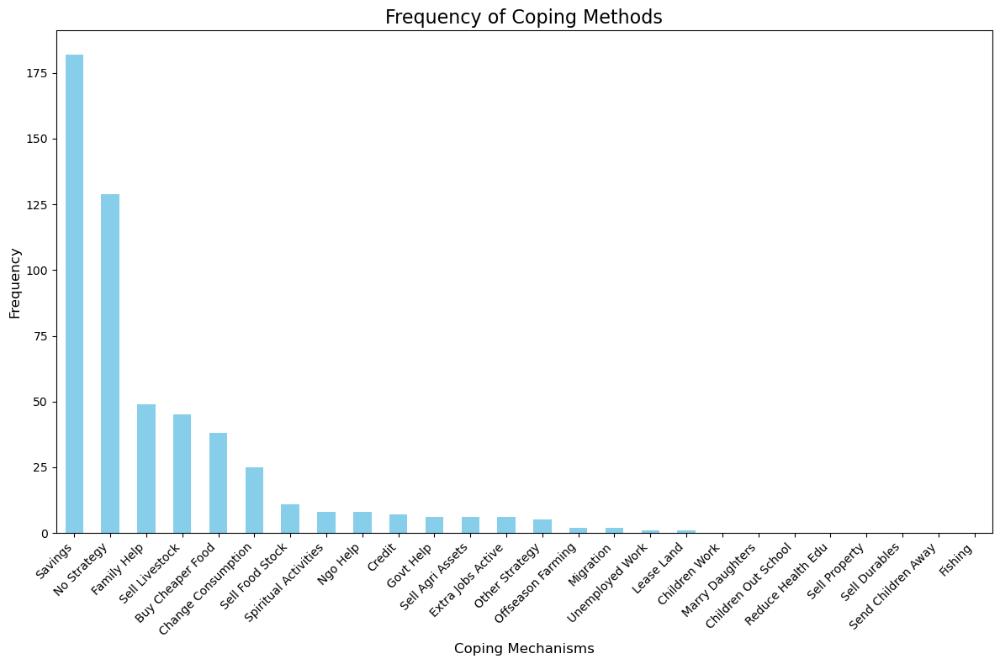

In [284]:
# Filter for columns related to coping methods, excluding the descriptive column

coping_columns = [col for col in merged_data.columns if col.startswith('coping_') and col != 'coping_other_specifies']

# Initialize a dictionary to store the frequencies
coping_frequencies_dict = {}

# Iterate over the coping columns and count occurrences where the value is greater than 0
for col in coping_columns:
    count = (merged_data[col] > 0).sum()
    coping_frequencies_dict[col] = count

# Convert the dictionary to a pandas Series and sort in descending order
coping_frequencies = pd.Series(coping_frequencies_dict).sort_values(ascending=False)

# Rename the index for better readability
coping_frequencies.index = coping_frequencies.index.str.replace('coping_', '').str.replace('_', ' ').str.title()

# Create a bar chart to visualize the frequencies
plt.figure(figsize=(12, 8))
coping_frequencies.plot(kind='bar', color='skyblue')
plt.title('Frequency of Coping Methods', fontsize=16)
plt.xlabel('Coping Mechanisms', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.tight_layout()
plt.show()

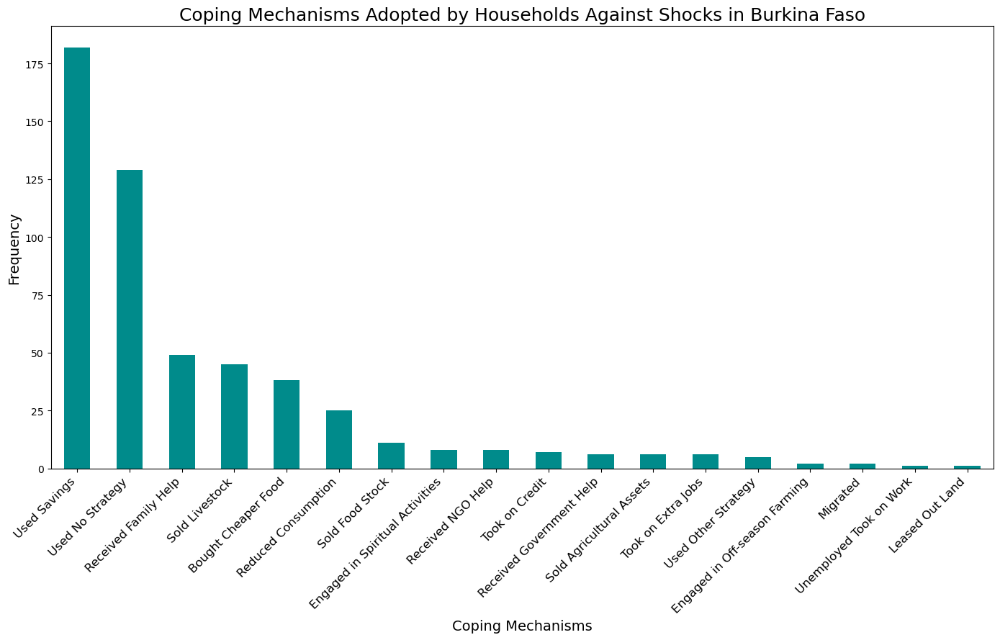

In [279]:
import pandas as pd
import matplotlib.pyplot as plt


# Create a mapping for descriptive names.
coping_name_map = {
    'coping_savings': 'Used Savings',
    'coping_family_help': 'Received Family Help',
    'coping_govt_help': 'Received Government Help',
    'coping_ngo_help': 'Received NGO Help',
    'coping_marry_daughters': 'Married Daughters Off',
    'coping_change_consumption': 'Reduced Consumption',
    'coping_buy_cheaper_food': 'Bought Cheaper Food',
    'coping_extra_jobs_active': 'Took on Extra Jobs',
    'coping_unemployed_work': 'Unemployed Took on Work',
    'coping_children_work': 'Sent Children to Work',
    'coping_children_out_school': 'Took Children Out of School',
    'coping_migration': 'Migrated',
    'coping_reduce_health_edu': 'Reduced Health/Education Spending',
    'coping_credit': 'Took on Credit',
    'coping_sell_agri_assets': 'Sold Agricultural Assets',
    'coping_sell_durables': 'Sold Durable Goods',
    'coping_sell_property': 'Sold Property',
    'coping_lease_land': 'Leased Out Land',
    'coping_sell_food_stock': 'Sold Food Stock',
    'coping_fishing': 'Relied on Fishing',
    'coping_sell_livestock': 'Sold Livestock',
    'coping_send_children_away': 'Sent Children Away',
    'coping_spiritual_activities': 'Engaged in Spiritual Activities',
    'coping_offseason_farming': 'Engaged in Off-season Farming',
    'coping_other_strategy': 'Used Other Strategy',
    'coping_no_strategy': 'Used No Strategy'
}

# Identify the columns to count based on the map
coping_cols_to_count = list(coping_name_map.keys())

# Calculate the frequencies (counting all non-zero values)
frequencies = {
    coping_name_map[col]: (merged_data[col] > 0).sum()
    for col in coping_cols_to_count
}

# Create a pandas Series from the dictionary
coping_frequencies = pd.Series(frequencies).sort_values(ascending=False)

# Filter out the zero values as requested
non_zero_frequencies = coping_frequencies[coping_frequencies > 0]

# Create a bar chart for the filtered data with the new names
plt.figure(figsize=(14, 9))
non_zero_frequencies.plot(kind='bar', color='darkcyan')
plt.title('Coping Mechanisms Adopted by Households Against Shocks in Burkina Faso', fontsize=18)
plt.xlabel('Coping Mechanisms', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.tight_layout()
plt.show()

In [234]:
# Construct Food Insecurity Index (0–4)
merged_data['food_insecurity_index'] = (
    merged_data[[
        'fs_worried_not_enough_food',
        'fs_skipped_meal_no_money',
        'fs_no_food_lack_money',
        'fs_no_food_all_day'
    ]]
    .fillna(0)
    .astype(int)
    .sum(axis=1)
)

# Create binary flag: 1 = food insecure (index ≥ 2), 0 = secure
merged_data['food_insecure'] = (merged_data['food_insecurity_index'] >= 2).astype(int)


In [233]:
[col for col in merged_data.columns if 'food' in col.lower() or 'meal' in col.lower() or 'insec' in col.lower()]


['shock_effect_food_stock',
 'shock_effect_food_purchase',
 'coping_buy_cheaper_food',
 'coping_sell_food_stock',
 'fs_worried_not_enough_food',
 'fs_skipped_meal_no_money',
 'fs_no_food_lack_money',
 'fs_no_food_all_day',
 'fs_no_food_all_day_times']

In [256]:
# Normalize region names
map_df['NAME_1'] = map_df['NAME_1'].str.strip().str.lower()
merged_data['region_clean'] = merged_data['region_clean'].str.strip().str.lower()


In [257]:
# Compute weighted food insecurity prevalence per region
fs_region = (
    merged_data.groupby('region_clean', as_index=False)
    .apply(lambda d: pd.Series({
        'food_insecure_prev': np.average(d['food_insecure'], weights=d['household_weight'])
    }))
    .reset_index(drop=True)
)


In [258]:
map_df_fs = map_df.merge(fs_region, left_on='NAME_1', right_on='region_clean', how='left')
map_df_fs

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry,ccri,shock_economic,shock_social,shock_environmental,NAME_1_clean,region_clean_x,region_clean_y,food_insecure_prev
0,BFA.1_1,BFA,Burkina Faso,boucle du mouhoun,NA,NA,Région,Region,NA,BF.BO,NA,"POLYGON ((-2.739 11.712, -2.7346 11.709, -2.72...",2.040000,0.885000,0.365000,0.790000,boucle du mouhoun,boucle du mouhoun,boucle du mouhoun,0.138156
1,BFA.2_1,BFA,Burkina Faso,cascades,NA,NA,Région,Region,NA,BF.CD,NA,"POLYGON ((-4.5917 9.7023, -4.5918 9.7024, -4.5...",2.065891,1.211111,0.340741,0.559259,cascades,cascades,cascades,0.262098
2,BFA.7_1,BFA,Burkina Faso,centre,NA,NA,Région,Region,NA,BF.CT,NA,"POLYGON ((-1.2786 12.139, -1.2797 12.139, -1.2...",1.818750,1.060991,0.453621,0.324015,centre,centre,centre,0.291604
3,BFA.3_1,BFA,Burkina Faso,centre-est,NA,NA,Région,Region,NA,BF.CE,NA,"POLYGON ((0.4371 11.677, 0.43874 11.677, 0.440...",2.142857,0.864198,0.445988,0.827160,centre-est,centre-est,centre-est,0.347868
4,BFA.4_1,BFA,Burkina Faso,centre-nord,NA,NA,Région,Region,NA,BF.CN,NA,"POLYGON ((-0.7773 12.67, -0.77452 12.665, -0.7...",2.561905,0.860465,0.655039,1.060078,centre-nord,centre-nord,centre-nord,0.398507
5,BFA.5_1,BFA,Burkina Faso,centre-ouest,NA,NA,Région,Region,NA,BF.CO,NA,"POLYGON ((-2.3602 11.008, -2.3776 11.009, -2.4...",2.646465,1.185764,0.453125,0.975694,centre-ouest,centre-ouest,centre-ouest,0.450315
6,BFA.6_1,BFA,Burkina Faso,centre-sud,NA,NA,Région,Region,NA,BF.CS,NA,"POLYGON ((-0.86249 10.985, -0.86286 10.985, -0...",2.641667,1.268750,0.425000,0.947917,centre-sud,centre-sud,centre-sud,0.391699
7,BFA.8_1,BFA,Burkina Faso,est,NA,NA,Région,Region,NA,BF.ES,NA,"POLYGON ((1.3844 11.442, 1.3798 11.423, 1.381 ...",2.638037,0.756487,0.672655,1.161677,est,est,est,0.445856
8,BFA.9_1,BFA,Burkina Faso,haut-bassins,NA,NA,Région,Region,NA,BF.HB,NA,"POLYGON ((-4.0899 10.79, -4.0905 10.79, -4.090...",1.604651,0.909836,0.310109,0.385246,haut-bassins,haut-bassins,haut-bassins,0.156903
9,BFA.10_1,BFA,Burkina Faso,nord,NA,NA,Région,Region,NA,BF.NO,NA,"POLYGON ((-1.9659 12.678, -1.9711 12.675, -1.9...",2.844444,1.134066,0.580220,1.131868,nord,nord,nord,0.518278


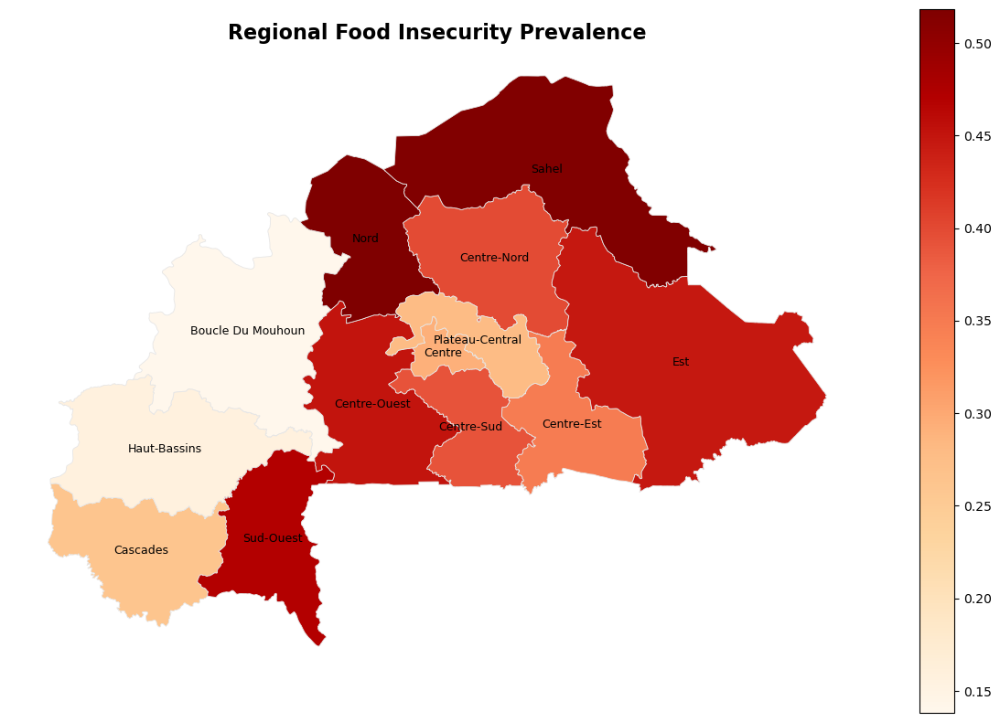

In [260]:
fig, ax = plt.subplots(figsize=(12, 8))

map_df_fs.plot(
    column='food_insecure_prev',
    cmap='OrRd',
    linewidth=0.6,
    edgecolor='0.9',
    legend=True,
    ax=ax,
    missing_kwds={
        "color": "lightgrey",
        "label": "No data"
    }
)

# Add region labels
for idx, row in map_df_fs.iterrows():
    if row['geometry'].centroid.is_empty:
        continue
    plt.text(
        row['geometry'].centroid.x,
        row['geometry'].centroid.y,
        row['NAME_1'].title(),
        fontsize=9,
        ha='center',
        va='center',
        color='black'
    )

ax.set_title("Regional Food Insecurity Prevalence", fontsize=16, fontweight='bold')
ax.axis('off')
plt.tight_layout()
plt.show()


In [261]:
bins = [0, 0.2, 0.35, 1]
labels = ['Low', 'Moderate', 'High']
map_df_fs['severity'] = pd.cut(map_df_fs['food_insecure_prev'], bins=bins, labels=labels)


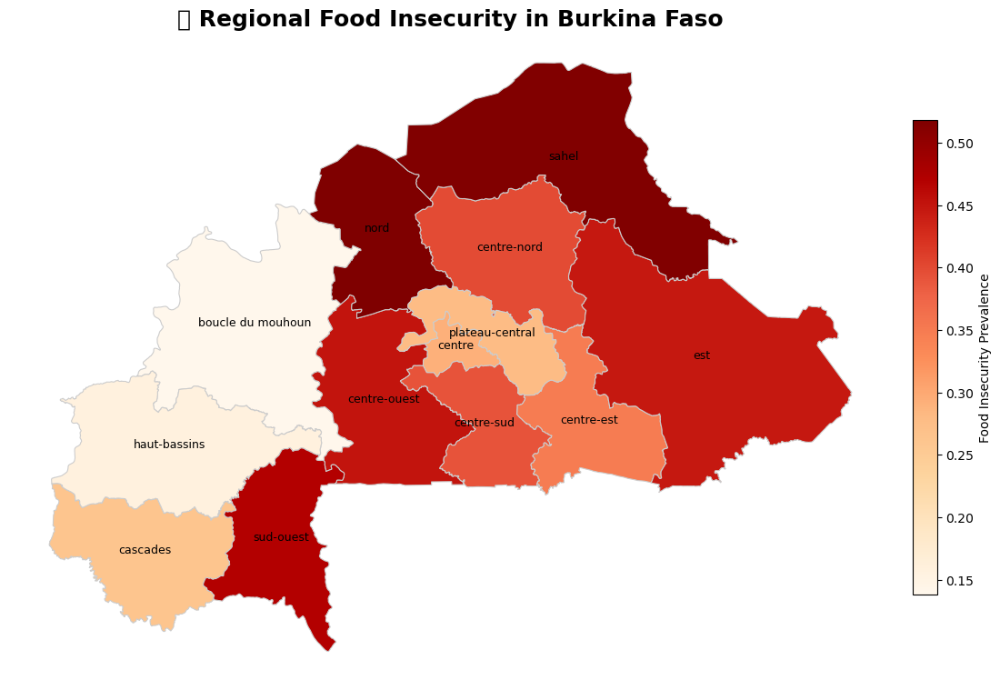

In [262]:
import matplotlib.pyplot as plt
import geopandas as gpd

# Set up the figure and axes
fig, ax = plt.subplots(1, 1, figsize=(12, 9))

# Plot choropleth with better style
map_df_fs.plot(
    column='food_insecure_prev',
    cmap='OrRd',
    linewidth=0.8,
    edgecolor='0.8',
    legend=True,
    legend_kwds={
        'label': "Food Insecurity Prevalence",
        'orientation': "vertical",
        'shrink': 0.6,
        'pad': 0.02
    },
    ax=ax
)

# Add region labels
for idx, row in map_df_fs.iterrows():
    if row['geometry'].centroid.is_empty:
        continue
    plt.annotate(
        text=row['NAME_1'],
        xy=(row['geometry'].centroid.x, row['geometry'].centroid.y),
        horizontalalignment='center',
        fontsize=9,
        color='black'
    )

# Title and clean aesthetics
ax.set_title("📍 Regional Food Insecurity in Burkina Faso", fontsize=18, weight='bold')
ax.axis('off')

# Tight layout for better spacing
plt.tight_layout()
plt.show()


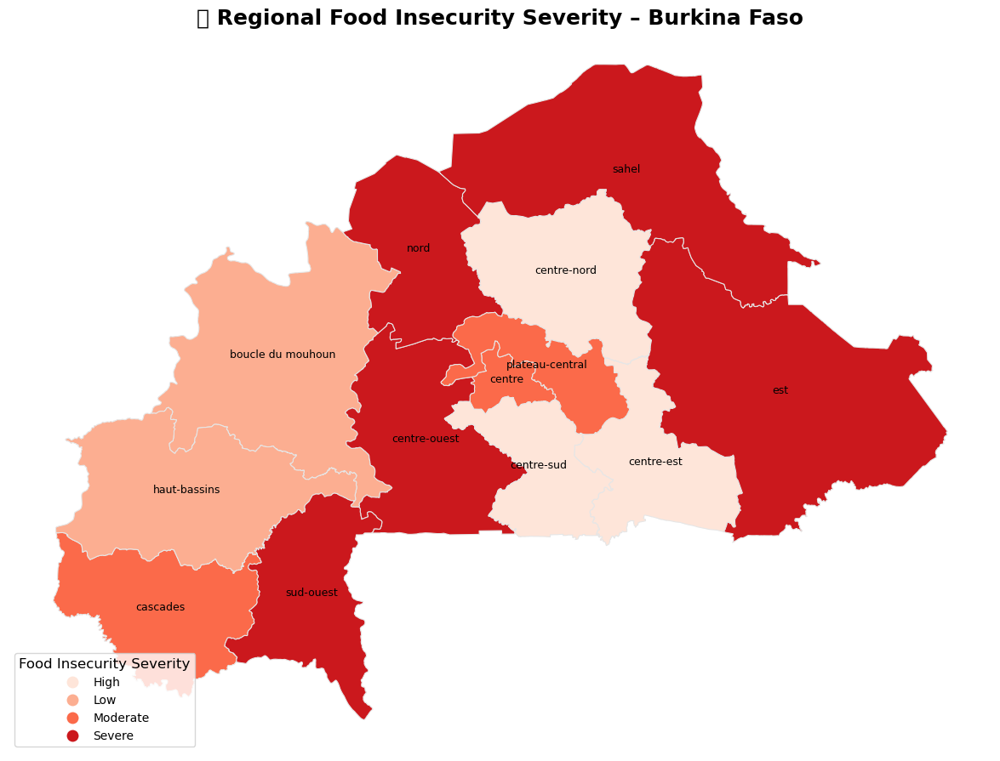

In [263]:
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd
import matplotlib.colors as mcolors

# Step 1: Define severity categories based on thresholds
def categorize_severity(val):
    if val < 0.20:
        return 'Low'
    elif val < 0.30:
        return 'Moderate'
    elif val < 0.40:
        return 'High'
    else:
        return 'Severe'

# Apply to create a severity column
map_df_fs['severity'] = map_df_fs['food_insecure_prev'].apply(categorize_severity)

# Step 2: Define color map for each severity level
severity_colors = {
    'Low': '#fee5d9',
    'Moderate': '#fcae91',
    'High': '#fb6a4a',
    'Severe': '#cb181d'
}
severity_cmap = mcolors.ListedColormap(severity_colors.values())

# Step 3: Plot the map
fig, ax = plt.subplots(1, 1, figsize=(12, 9))

# Plot using severity category
map_df_fs.plot(
    column='severity',
    cmap=severity_cmap,
    linewidth=0.8,
    edgecolor='0.9',
    ax=ax,
    legend=True,
    categorical=True,
    legend_kwds={
        'title': 'Food Insecurity Severity',
        'loc': 'lower left',
        'fontsize': 10,
        'title_fontsize': 12
    }
)

# Step 4: Add region labels
for idx, row in map_df_fs.iterrows():
    if row['geometry'].centroid.is_empty:
        continue
    plt.annotate(
        text=row['NAME_1'],
        xy=(row['geometry'].centroid.x, row['geometry'].centroid.y),
        horizontalalignment='center',
        fontsize=9,
        color='black'
    )

# Step 5: Aesthetics
ax.set_title("📍 Regional Food Insecurity Severity – Burkina Faso", fontsize=18, weight='bold')
ax.axis('off')
plt.tight_layout()
plt.show()


In [266]:

df = merged_data

# --- Data Preparation ---
#  Fill missing GPS coordinates with 0 instead of dropping rows.
#   Filling with 0 will place these points at (0,0) on the map, which is off the coast of Africa.
df_clean = df.fillna({
    'gps_latitude': 0,
    'gps_longitude': 0
})

# 2. Create a more descriptive column for coloring the points based on 'shock_environmental'.
#    This makes the map legend clearer (e.g., "Environmental Shock" vs. "No Environmental Shock").
#    Ensure 'shock_environmental' is treated as a numerical type before mapping.
#    Also, handle potential NaN values in 'shock_environmental' by filling them before mapping.
df_clean['Environmental Shock Occurred'] = df_clean['shock_environmental'].fillna(0).map({
    0: 'No Environmental Shock',
    1: 'Environmental Shock Reported'
})

# --- Interactive Map Creation ---
# Use plotly.express to create a scatter mapbox plot.
# This provides an interactive map.
fig = px.scatter_mapbox(
    df_clean,
    lat="gps_latitude",  # Latitude column for point placement
    lon="gps_longitude", # Longitude column for point placement
    color="Environmental Shock Occurred", # Color points based on whether an environmental shock occurred
    color_discrete_map={ # Define specific colors for clarity
        'No Environmental Shock': 'lightgray',
        'Environmental Shock Reported': 'red'
    },
    size_max=10,         # Maximum size for markers to prevent overcrowding
    zoom=5,              # Initial zoom level, suitable for viewing Burkina Faso
    mapbox_style="carto-positron", # A visually appealing base map style
    hover_name="region", # Display the 'region' name when hovering over a point
    hover_data={         # Include satellite data and other relevant info on hover
        "Environmental Shock Occurred": True, # Show the mapped shock status
        "rainfall": True,    # Show rainfall data
        "temperature": True, # Show temperature data
        "NDVI": True,        # Show Normalized Difference Vegetation Index
        "NDBI": True,        # Show Normalized Difference Built-up Index
        "Nightlight": True,  # Show Nightlight data (proxy for economic activity)
        "gps_latitude": False, # Hide raw latitude from hover info
        "gps_longitude": False # Hide raw longitude from hover info
    },
    title="Household Locations: Environmental Shocks and Satellite Data" # Title of the map
)

# --- Layout Customization ---
# Adjust map margins for better display and set a clear legend title.
fig.update_layout(
    margin={"r":0,"t":50,"l":0,"b":0}, # Set margins to zero for full map display
    legend_title_text='Environmental Shock Status' # Title for the color legend
)

# Display the generated interactive map.
fig.show()


In [285]:
# Extract and clean WASH-related indicators from merged_data
# Based on UNICEF JMP WASH definitions (Improved = 1, Unimproved = 0)

# Define improved/safe response categories
improved_toilet = [
    "w.c. int. avec chasse d'eau", "w.c. int. chasse d'eau manuelle",
    "w.c. ext. avec chasse d'eau", "w.c. ext. chasse d'eau manuelle",
    "latrines vip (dallées, ventillées)", "latrines dallées simplement",
    "latrines sanplat (dallées, non couvertes)", "latrines ecosan (dallées, couvertes)"
]

safe_garbage = ["ramassage", "enterrées par le ménage"]

safe_wastewater = ["egout", "puisard (fosse moderne)", "fosse étanche"]

safe_child_feces = [
    "il a utilisé les toilettes/ latrines",
    "les selles ont été mises ou jetées dans les toilettes/latrines",
    "les selles ont été mises/ jetées dans les égouts ou la fosse septique",
    "les selles ont été enterrées"
]

safe_excreta = ["fosse septique", "fosse étanche", "compost", "egout"]

# Recode to binary: 1 = safe/improved, 0 = unsafe/unimproved
merged_data["toilet_improved"] = merged_data["toilet_type"].isin(improved_toilet).astype(int)
merged_data["garbage_safe"] = merged_data["garbage_disposal_method"].isin(safe_garbage).astype(int)
merged_data["wastewater_safe"] = merged_data["wastewater_disposal_method"].isin(safe_wastewater).astype(int)
merged_data["child_feces_safe"] = merged_data["child_feces_disposal_last_time"].isin(safe_child_feces).astype(int)
merged_data["excreta_safe"] = merged_data["excreta_disposal_method"].isin(safe_excreta).astype(int)

# Preview value counts for verification
for col in [
    "toilet_improved", "garbage_safe", "wastewater_safe", "child_feces_safe", "excreta_safe"
]:
    print(f"{col}:\n", merged_data[col].value_counts(dropna=False), "\n")


toilet_improved:
 toilet_improved
0    4710
1    2466
Name: count, dtype: int64 

garbage_safe:
 garbage_safe
0    6530
1     646
Name: count, dtype: int64 

wastewater_safe:
 wastewater_safe
0    7093
1      83
Name: count, dtype: int64 

child_feces_safe:
 child_feces_safe
0    5944
1    1232
Name: count, dtype: int64 

excreta_safe:
 excreta_safe
0    6517
1     659
Name: count, dtype: int64 



In [286]:
# Clean and standardize region names for grouping
merged_data["region_clean"] = merged_data["region"].str.lower().str.strip()

# Group by region and compute average of each WASH binary variable
wash_region = (
    merged_data.groupby("region_clean")[
        ["toilet_improved", "garbage_safe", "wastewater_safe", "child_feces_safe", "excreta_safe"]
    ]
    .mean()
    .reset_index()
)

# Convert to percentage for easier interpretation
wash_region = wash_region * 100
wash_region["region_clean"] = merged_data.groupby("region_clean").size().index  # restore region names

# Compute composite WASH access score (mean of 5 indicators)
wash_region["wash_index"] = wash_region[
    ["toilet_improved", "garbage_safe", "wastewater_safe", "child_feces_safe", "excreta_safe"]
].mean(axis=1)


In [287]:
wash_region

,region_clean,toilet_improved,garbage_safe,wastewater_safe,child_feces_safe,excreta_safe,wash_index
0,boucle du mouhoum,35.333333,1.333333,3.666667,18.333333,10.833333,13.900000
1,cascades,40.370370,12.222222,0.555556,16.296296,8.333333,15.555556
2,centre,44.853875,14.104193,3.430750,26.556544,17.916137,21.372300
3,centre-est,30.401235,5.555556,0.000000,16.975309,7.098765,12.006173
4,centre-nord,29.651163,8.139535,0.193798,16.279070,4.069767,11.666667
5,centre-ouest,33.506944,11.458333,0.347222,13.888889,6.250000,13.090278
6,centre-sud,30.625000,8.333333,0.625000,10.625000,11.041667,12.250000
7,est,32.135729,7.784431,1.197605,14.970060,10.179641,13.253493
8,hauts-bassins,41.256831,14.754098,1.502732,22.950820,10.655738,18.224044
9,nord,28.131868,11.208791,0.000000,14.725275,8.571429,12.527473


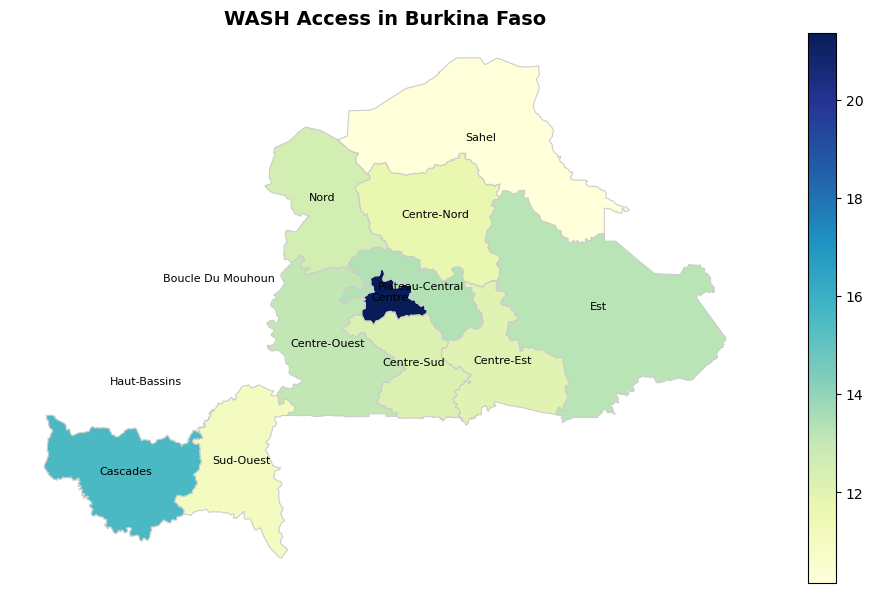

In [290]:
# plot the WASH index/ scores by region

map_df["region_clean"] = map_df["region_clean"].str.lower().str.strip()
wash_region["region_clean"] = wash_region["region_clean"].str.lower().str.strip()
map_wash = map_df.merge(wash_region, on="region_clean", how="left")

fig, ax = plt.subplots(figsize=(10, 6))
map_wash.plot(
    column="wash_index",
    cmap="YlGnBu",
    linewidth=0.8,
    edgecolor="0.8",
    legend=True,
    ax=ax
)

for idx, row in map_wash.iterrows():
    if row["geometry"].centroid.is_valid:
        ax.annotate(
            text=row["region_clean"].title(),
            xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
            fontsize=8,
            color="black",
            ha="center"
        )

ax.set_title("WASH Access in Burkina Faso", fontsize=14, weight="bold")
ax.axis("off")
plt.tight_layout()
plt.show()


In [291]:
ax.annotate(
    text=row["region_clean"].replace("-", " ").title(),
    xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
    fontsize=8,
    color="black",
    ha="center",
    va="center"
)


Text(-3.2307821317103094, 10.475759191240277, 'Sud Ouest')

In [293]:
for idx, row in map_wash.iterrows():
    if row["region_clean"] != "centre":  # skip 'centre' to avoid overlap
        ax.annotate(
            text=row["region_clean"].replace("-", " ").title(),
            xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
            fontsize=8,
            color="black",
            ha="center",
            va="center"
        )


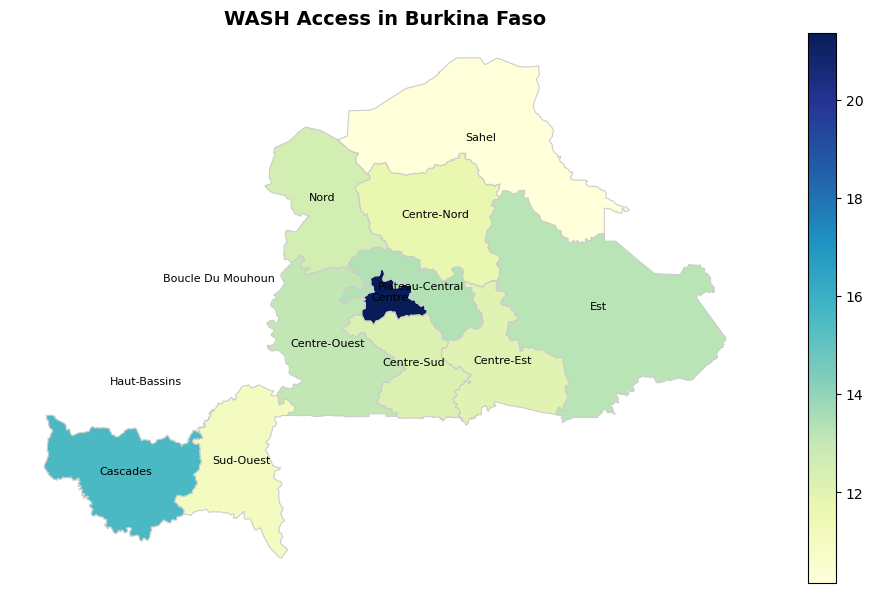

In [294]:
import matplotlib.pyplot as plt

map_df["region_clean"] = map_df["region_clean"].str.lower().str.strip()
wash_region["region_clean"] = wash_region["region_clean"].str.lower().str.strip()
map_wash = map_df.merge(wash_region, on="region_clean", how="left")

fig, ax = plt.subplots(figsize=(10, 6))
map_wash.plot(
    column="wash_index",
    cmap="YlGnBu",
    linewidth=0.8,
    edgecolor="0.8",
    legend=True,
    ax=ax
)

for idx, row in map_wash.iterrows():
    if row["geometry"].centroid.is_valid:
        ax.annotate(
            text=row["region_clean"].title(),
            xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
            fontsize=8,
            color="black",
            ha="center"
        )

ax.set_title("WASH Access in Burkina Faso", fontsize=14, weight="bold")
ax.axis("off")
plt.tight_layout()
plt.show()


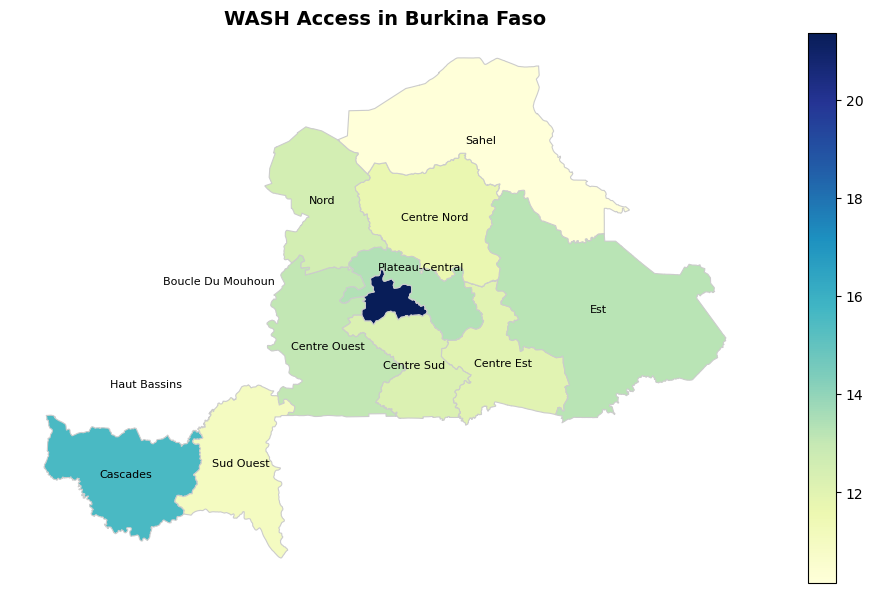

In [295]:
fig, ax = plt.subplots(figsize=(10, 6))
map_wash.plot(
    column="wash_index",
    cmap="YlGnBu",
    linewidth=0.8,
    edgecolor="0.8",
    legend=True,
    ax=ax
)

for idx, row in map_wash.iterrows():
    if row["region_clean"] == "plateau-central":
        # Slightly adjust label position upward
        x, y = row["geometry"].centroid.x, row["geometry"].centroid.y + 0.25
        ax.annotate("Plateau-Central", xy=(x, y), fontsize=8, ha="center", va="center")
    elif row["region_clean"] != "centre":
        ax.annotate(
            text=row["region_clean"].replace("-", " ").title(),
            xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
            fontsize=8,
            ha="center",
            va="center"
        )

ax.set_title("WASH Access in Burkina Faso", fontsize=14, weight="bold")
ax.axis("off")
plt.tight_layout()
plt.show()


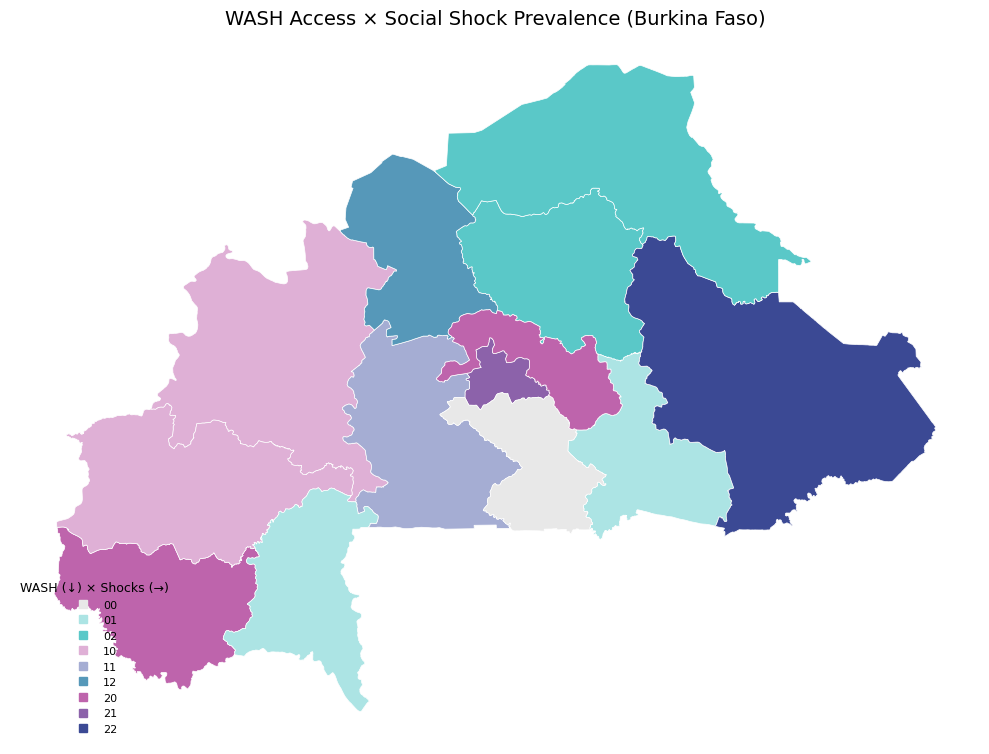

In [299]:
# Work on a copy
plot_df = map_wash.copy()

# Fill missing values with median
plot_df['wash_index'] = plot_df['wash_index'].fillna(plot_df['wash_index'].median())
plot_df['shock_social'] = plot_df['shock_social'].fillna(plot_df['shock_social'].median())

# Create quantiles
plot_df['wash_quantile'] = pd.qcut(plot_df['wash_index'], 3, labels=[0, 1, 2])
plot_df['shock_quantile'] = pd.qcut(plot_df['shock_social'], 3, labels=[0, 1, 2])

# Bivariate combination
plot_df['bivariate_class'] = plot_df['wash_quantile'].astype(str) + plot_df['shock_quantile'].astype(str)

# Define bivariate colormap
bivariate_colors = {
    '00': '#e8e8e8', '01': '#ace4e4', '02': '#5ac8c8',
    '10': '#dfb0d6', '11': '#a5add3', '12': '#5698b9',
    '20': '#be64ac', '21': '#8c62aa', '22': '#3b4994'
}

# Map colors
plot_df['color'] = plot_df['bivariate_class'].map(bivariate_colors)

# Plot
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
plot_df.plot(color=plot_df['color'], edgecolor='white', linewidth=0.5, ax=ax)

ax.set_title('WASH Access × Social Shock Prevalence (Burkina Faso)', fontsize=14)
ax.axis('off')

# Manual legend
for key, color in bivariate_colors.items():
    ax.plot([], [], marker='s', linestyle='none', color=color, label=key)
ax.legend(
    title='WASH (↓) × Shocks (→)',
    loc='lower left',
    fontsize=8,
    title_fontsize=9,
    frameon=False
)

plt.tight_layout()
plt.show()


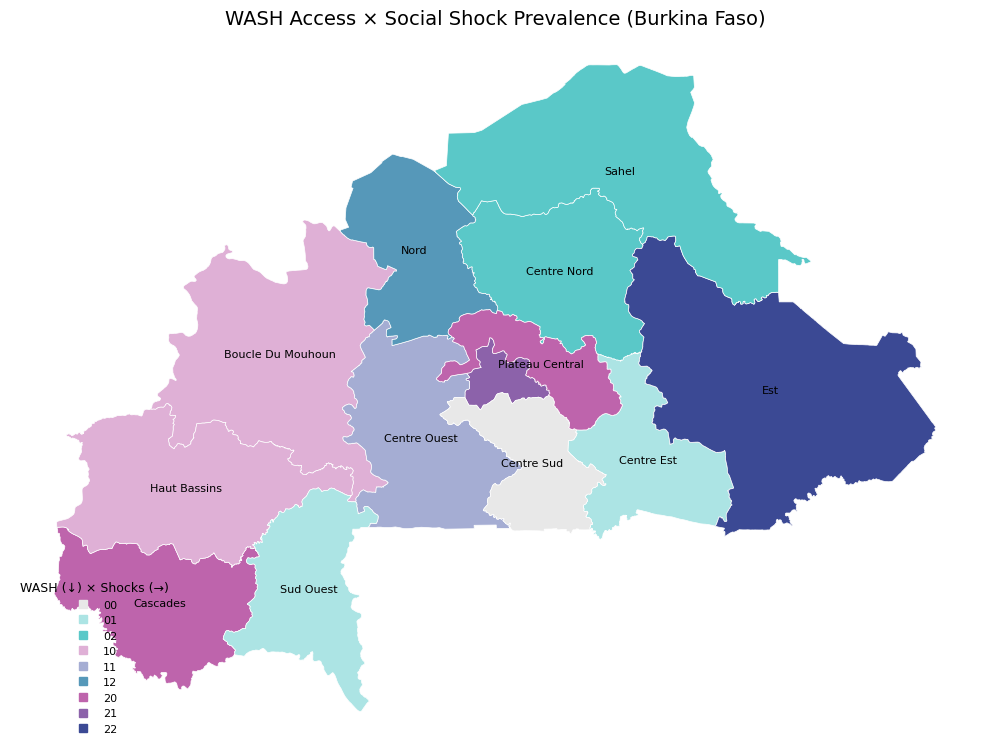

In [300]:
# Plot map first (same as before)
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
plot_df.plot(color=plot_df['color'], edgecolor='white', linewidth=0.5, ax=ax)

ax.set_title('WASH Access × Social Shock Prevalence (Burkina Faso)', fontsize=14)
ax.axis('off')

# Annotate regions using cleaned names
for idx, row in plot_df.iterrows():
    if row["region_clean"].lower() != "centre": 
        ax.annotate(
            text=row["region_clean"].replace("-", " ").title(),  # clean up hyphens if any
            xy=(row["geometry"].centroid.x, row["geometry"].centroid.y),
            ha='center',
            va='center',
            fontsize=8,
            color='black'
        )

# Legend
for key, color in bivariate_colors.items():
    ax.plot([], [], marker='s', linestyle='none', color=color, label=key)
ax.legend(
    title='WASH (↓) × Shocks (→)',
    loc='lower left',
    fontsize=8,
    title_fontsize=9,
    frameon=False
)

plt.tight_layout()
plt.show()


In [303]:
# If these are all 0/1 binary indicators in merged_data
merged_data['wash_index'] = (
    merged_data[['toilet_improved', 'garbage_safe', 'wastewater_safe',
                 'child_feces_safe', 'excreta_safe']]
    .sum(axis=1)
)

# Normalize to 0–1 scale if needed
merged_data['wash_index'] = merged_data['wash_index'] / 5


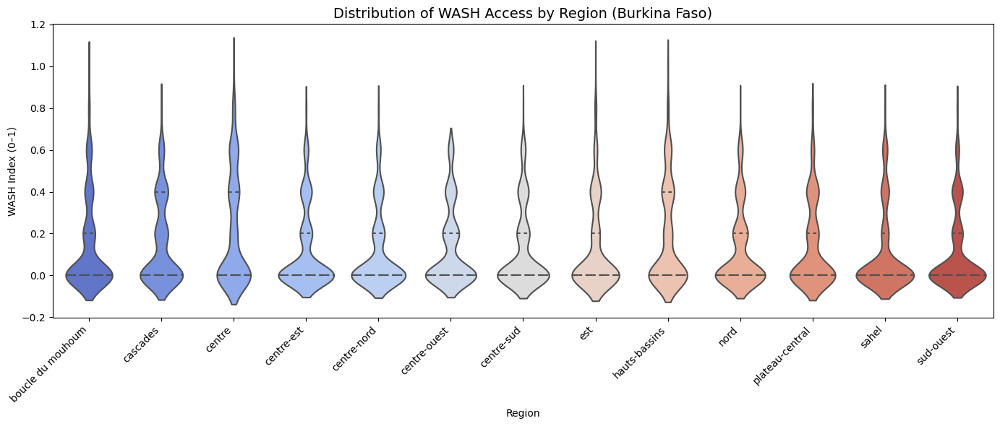

In [304]:
df_wash_all = merged_data[['region_clean', 'wash_index']].dropna()

# Plot
import seaborn as sns
import matplotlib.pyplot as plt

region_order = df_wash_all.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_wash_all,
    x='region_clean',
    y='wash_index',
    inner='quartile',
    palette='coolwarm',
    order=region_order
)

plt.title('Distribution of WASH Access by Region (Burkina Faso)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.tight_layout()
plt.show()


In [308]:
# Pull region_clean from merged_data 
if 'wash' not in globals():
    wash = df.copy()  

# Merge region_clean using hhid as the key (or 'cluster' if that's more consistent)
wash = wash.merge(
    merged_data[['hhid', 'region_clean']],
    on='hhid',
    how='left'
)


In [309]:
# Prepare plotting dataset
df_wash_all = wash[['region_clean', 'wash_index']].dropna()

# Sort regions by median WASH access
region_order = df_wash_all.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()


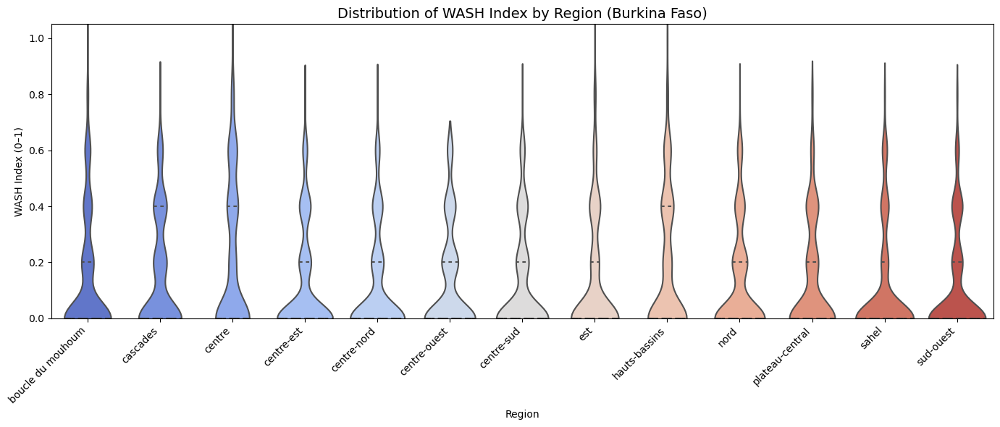

In [310]:

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_wash_all,
    x='region_clean',
    y='wash_index',
    inner='quartile',
    palette='coolwarm',
    order=region_order
)

plt.title('Distribution of WASH Index by Region (Burkina Faso)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.ylim(0, 1.05)
plt.tight_layout()
plt.show()


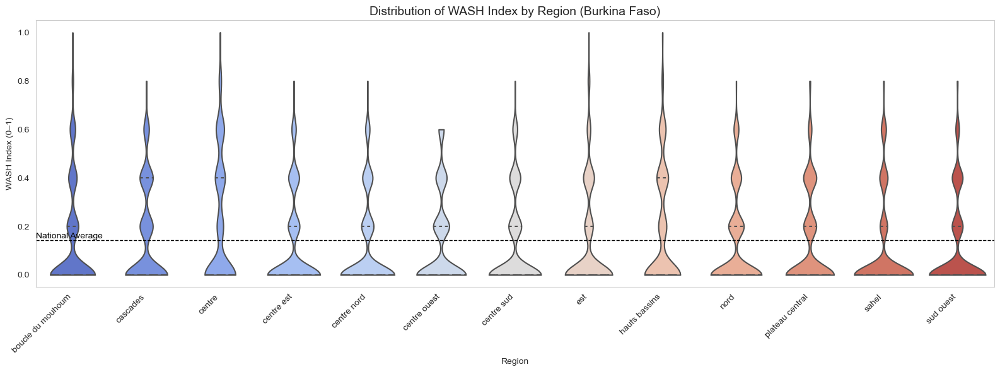

In [323]:
# Sort regions by median WASH index
region_order = df_wash_all.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()

plt.figure(figsize=(16, 6))
ax = sns.violinplot(
    data=df_wash_all,
    x='region_clean',
    y='wash_index',
    inner='quartile',
    palette='coolwarm',
    order=region_order,
    bw=0.2,
    cut=0
)

# National average line
national_avg = df_wash_all["wash_index"].mean()
plt.axhline(national_avg, linestyle='--', color='black', linewidth=1)
plt.text(-0.5, national_avg + 0.01, 'National Average', color='black')

# Remove Y-axis gridlines
ax.yaxis.grid(False)

# Formatting
plt.title('Distribution of WASH Index by Region (Burkina Faso)', fontsize=14)
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


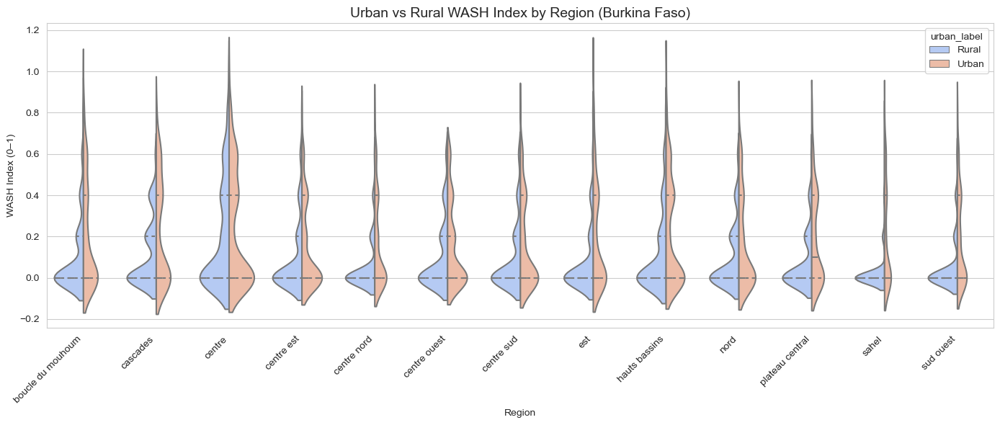

In [326]:
import seaborn as sns
import matplotlib.pyplot as plt

# Sort regions by median WASH index
region_order = merged_data.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()

# replace 0/1 with labels for clarity
merged_data["urban_label"] = merged_data["urban"].map({0: "Rural", 1: "Urban"})

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=merged_data,
    x='region_clean',
    y='wash_index',
    hue='urban_label',
    split=True,
    inner='quartile',
    palette='coolwarm',
    order=region_order
)

plt.title('Urban vs Rural WASH Index by Region (Burkina Faso)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.tight_layout()
plt.show()


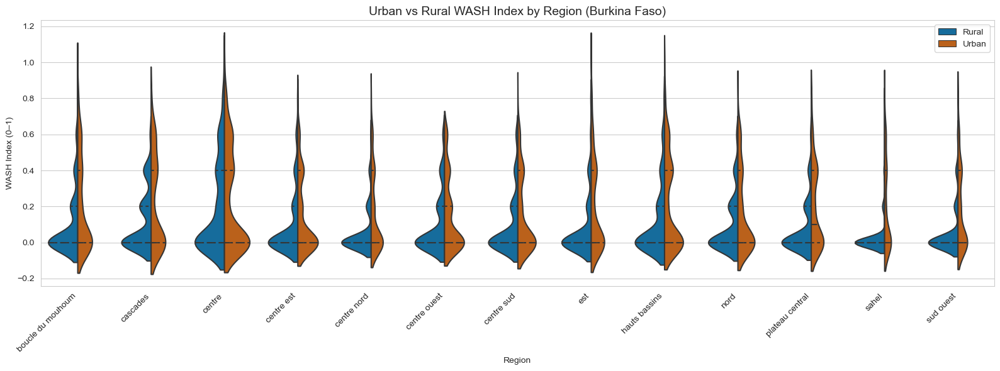

In [327]:
import seaborn as sns
import matplotlib.pyplot as plt

# Sort regions by median WASH index
region_order = merged_data.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()

# Label urban/rural
merged_data["urban_label"] = merged_data["urban"].map({0: "Rural", 1: "Urban"})

# Define better-looking colors: Blue for Rural, Orange for Urban
custom_palette = {"Rural": "#0072B2", "Urban": "#D55E00"}

plt.figure(figsize=(16, 6))
sns.violinplot(
    data=merged_data,
    x='region_clean',
    y='wash_index',
    hue='urban_label',
    split=True,
    inner='quartile',
    palette=custom_palette,
    order=region_order
)

plt.title('Urban vs Rural WASH Index by Region (Burkina Faso)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.legend(title='', loc='upper right')
plt.tight_layout()
plt.show()


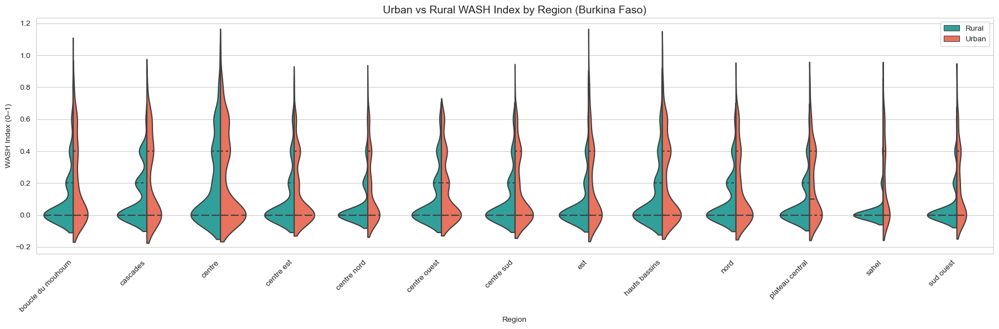

In [328]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define better colors: teal vs coral (flat & high contrast)
custom_palette = {"Rural": "#20B2AA", "Urban": "#FF6347"}  # LightSeaGreen and Tomato

# Ensure region order is by median WASH index
region_order = merged_data.groupby("region_clean")["wash_index"].median().sort_values().index.tolist()

# Label for plot
merged_data["urban_label"] = merged_data["urban"].map({0: "Rural", 1: "Urban"})

plt.figure(figsize=(18, 6))
sns.violinplot(
    data=merged_data,
    x='region_clean',
    y='wash_index',
    hue='urban_label',
    split=True,
    inner='quartile',
    palette=custom_palette,
    order=region_order
)

plt.title('Urban vs Rural WASH Index by Region (Burkina Faso)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Region')
plt.ylabel('WASH Index (0–1)')
plt.legend(title='', loc='upper right')
plt.tight_layout()
plt.show()


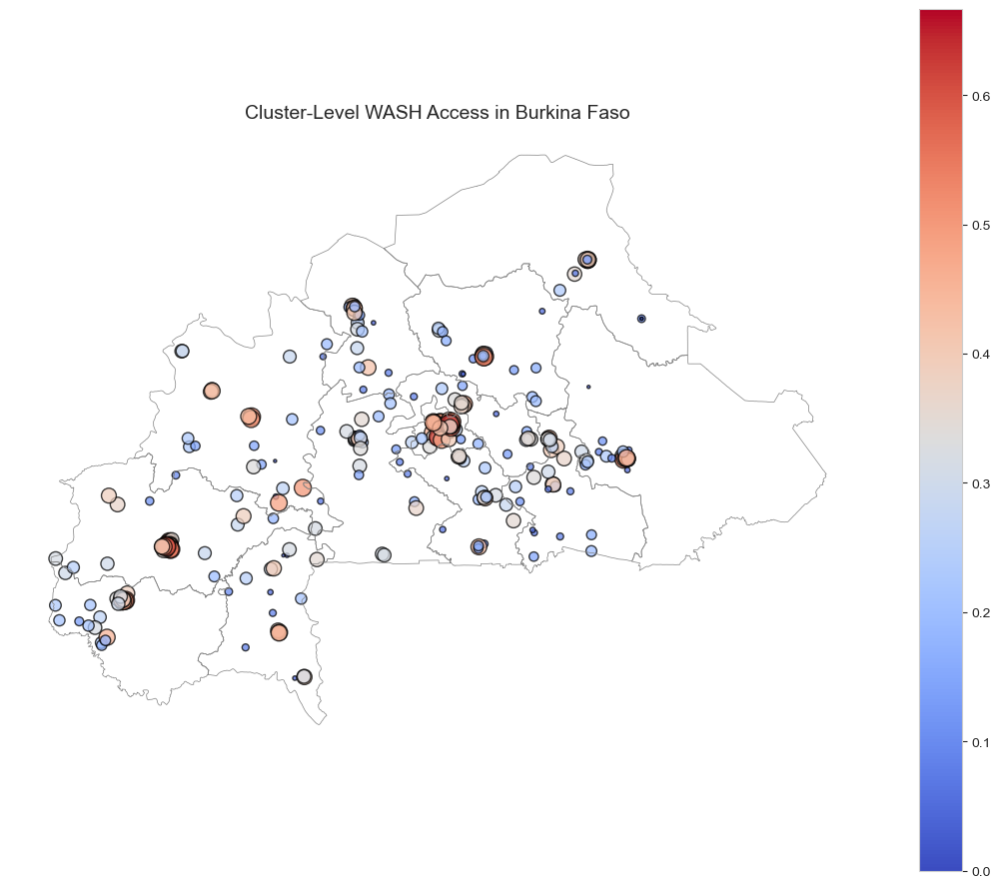

In [336]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# Fill missing values with mean
merged_data[["wash_index", "gps_latitude", "gps_longitude"]] = (
    merged_data[["wash_index", "gps_latitude", "gps_longitude"]]
    .fillna(merged_data[["wash_index", "gps_latitude", "gps_longitude"]].mean())
)

# Compute cluster-level averages
cluster_wash = (
    merged_data.groupby("cluster")[["wash_index", "gps_longitude", "gps_latitude"]]
    .mean()
    .reset_index()
)

# Convert to GeoDataFrame
cluster_wash["geometry"] = cluster_wash.apply(
    lambda row: Point(row["gps_longitude"], row["gps_latitude"]), axis=1
)
gdf_bubbles = gpd.GeoDataFrame(cluster_wash, geometry="geometry", crs="EPSG:4326")

# Plot bubble map
fig, ax = plt.subplots(figsize=(11, 9))
map_df.boundary.plot(ax=ax, color="gray", linewidth=0.5)
gdf_bubbles.plot(
    ax=ax,
    column="wash_index",
    markersize=gdf_bubbles["wash_index"] * 300,  # Adjust size as needed
    cmap="coolwarm",
    alpha=0.75,
    edgecolor="black",
    legend=True
)

ax.set_title("Cluster-Level WASH Access in Burkina Faso", fontsize=14)
ax.axis("off")
plt.tight_layout()
plt.show()
